# Predict learning time

In [1]:
prefix = '/home/ines/repositories/'
# prefix = '/Users/ineslaranjeira/Documents/Repositories/'

In [2]:
""" 
IMPORTS
"""
import os
import numpy as np
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict

# --Machine learning and statistics
from sklearn.preprocessing import StandardScaler,  LabelBinarizer
from sklearn.cluster import KMeans
import random
import pickle
from scipy.stats import mode
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LinearRegression
from scipy.stats import spearmanr, pearsonr
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, median_absolute_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import OneHotEncoder
from scipy.stats import entropy
from scipy import stats
from one.api import ONE
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

one = ONE(mode='remote')

## Get sequences per trial epoch

In [3]:
seq_path = prefix + 'representation_learning_variability/paper-individuality/fig1_segmentation/'
all_sequences = pd.read_parquet(seq_path+'all_sequences_09-29-2025')
all_sequences['session'] = all_sequences['sample'].str[:36]
sess = all_sequences.session.unique()

In [34]:
design_df = all_sequences.pivot(index=['sample', 'session', 'trial_type', 'mouse_name'], columns=['broader_label'], values='binned_sequence').reset_index().dropna()
var_names = design_df.keys()[-4:]

In [36]:
df = design_df.copy()

## Separate states per variable (one-hot encoding)

# Intersection of states

In [38]:
epoch_to_analyse = ['Pre-quiescence', 'Quiescence', 'Choice', 'ITI']

sequences_choice = np.vstack(df[epoch_to_analyse].apply(lambda row: np.hstack(row), axis=1))  # Transpose to get the right shape
use_sequences = sequences_choice[~np.isnan(sequences_choice).any(axis=1)]

# Binarize paw sequences
use_states = int(max(np.unique(use_sequences)))+1
timesteps = np.shape(use_sequences)[1]
binarized = np.zeros((np.shape(use_sequences)[0], timesteps*use_states))

for t in range(timesteps):
    label_binarizer = LabelBinarizer()
    label_binarizer.fit(range(use_states))
    encoded_arr = label_binarizer.transform(use_sequences[:, t])
    binarized[:, t*use_states:(t+1)*use_states] = encoded_arr

# Append the other variables
# final_matrix = np.concatenate((binarized, licking_sequences, whisker_sequences), axis=1)
final_matrix = binarized.copy()

In [39]:
plt.figure(figsize=(10, 4))
plt.imshow(final_matrix, aspect='auto', cmap='viridis', interpolation='none')
plt.xticks(np.arange(0, np.shape(final_matrix)[1], 160), np.arange(0, np.shape(final_matrix)[1], 160))

([<matplotlib.axis.XTick at 0x753de9dc9450>,
 [Text(0, 0, '0'),
  Text(160, 0, '160'),
  Text(320, 0, '320'),
  Text(480, 0, '480'),
  Text(640, 0, '640'),
  Text(800, 0, '800'),
  Text(960, 0, '960'),
  Text(1120, 0, '1120')])

: 

# Get data of interest for decoder

In [32]:
lda = LinearDiscriminantAnalysis(n_components=50)
X = np.array(final_matrix)
mouse_names =  pd.factorize(df['mouse_name'])[0]
session_names =  pd.factorize(df['session'])[0]
y = pd.factorize(mouse_names)[0]
X_lda = lda.fit(X, y).transform(X)


KeyError: 'session'

In [28]:
np.sum(lda.explained_variance_ratio_)

np.float64(0.9605950587611453)

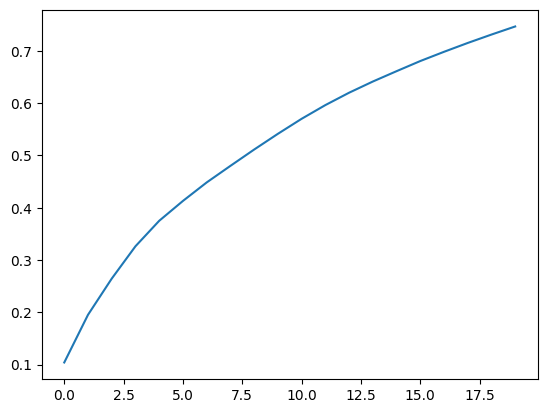

In [31]:
plt.plot(np.cumsum(lda.explained_variance_ratio_)[:20])

/tmp/ipykernel_10361/2664536136.py:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


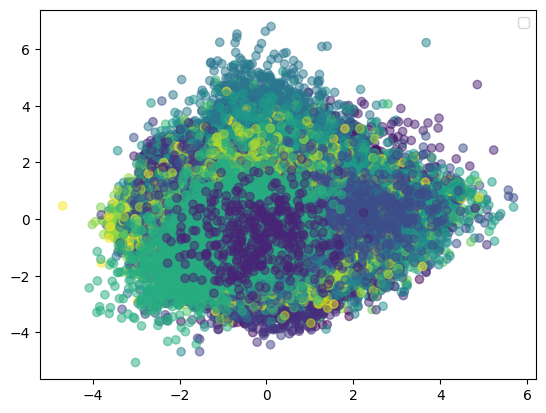

In [24]:
num_to_plot = 2000
num_to_plot = np.shape(X)[0]

plt.scatter(X_lda[:num_to_plot, 2], X_lda[:num_to_plot, 1], alpha=.5, c=y[:num_to_plot])
plt.legend()
# plt.xlim([-4, 4])
# plt.ylim([-4, 4])

In [ ]:
syllables = np.arange(0, np.shape(final_matrix)[1])
all_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
pvalues = [0.0001, 0.001, 0.01, 0.05, 0.1]
pvalues = [0.001, 0.01, 0.05]
pvalues = [0.001]
pvalues = [0.01, 0.05]
pvalues = [0.05]

for p, p_v in enumerate(pvalues):
    
    y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
    y_df['mouse_number'] = list(mat['mouse_number'])
    y_df['training_time'] = list(np.log(mat['training_time']))
    y_df = y_df.drop_duplicates().reset_index()
    y_df['p_v'] = p_v

    use_mat = mat.copy()
    use_mat['training_time'] = np.log(mat['training_time'])

    for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
        print('Processing mouse '+str(mouse))
        
        training = use_mat.loc[use_mat['mouse_number']!=m]
        pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
        prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

        for s, syllable in enumerate(syllables):
            
            x = np.sqrt(prob_syllable[s])
            x = np.exp(prob_syllable[s])
            y = prob_syllable['training_time']
            pearson, p_value = spearmanr(x, y)
            pearson, p_value = pearsonr(x, y)
            
            # Save data
            pearson_df['syllable'][s] = s
            pearson_df['pearson'][s] = pearson
            pearson_df['p_value'][s] = p_value

        # Construct feature strength per subject
        training_mice = training.mouse_number.unique()
        significant_features = np.array(pearson_df.loc[pearson_df['p_value']<p_v, 'syllable'])

        X_train = np.ones((len(training_mice), len(significant_features))) * np.nan
        y_train = np.ones(len(training_mice)) * np.nan
        for mm, mmouse in enumerate(training_mice):
            
            mouse_vector = np.sqrt(training.loc[training['mouse_number']==mmouse, syllables].mean(axis=0))
            X_train[mm, :] = mouse_vector[significant_features]
            y_train[mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
        
        X = np.vstack([X_train.T, np.ones(len(training_mice))]).T
        model = RidgeCV(alphas=np.logspace(-3, 3, 10)).fit(np.array(X), np.array(y_train))
        # model = svm.SVR().fit(np.array(X), np.array(y_train))

        # Predict test mouse
        test = use_mat.loc[use_mat['mouse_number']==m]
        test_prob_syllable = np.sqrt(test.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index())
        X_test = np.array(test_prob_syllable[significant_features])
        new_X = np.vstack([X_test.T, np.ones(1)]).T
        predicted_time = model.predict(new_X)

        # Save
        y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)

    all_df = pd.concat([all_df, y_df])

## Multivariate regression

In [83]:
shuffle = False

Processing mouse 0


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 1


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 2


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 3


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 4


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 5


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 6


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 7


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 8


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 9


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 10


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 11


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 12


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 13


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 14


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 15


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 16


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 17


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 18


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 19


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 20


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 21


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 22


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 23


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 24


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 25


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 26


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 27


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 28


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 29


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 30


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 31


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 32


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 33


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 34


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 35


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 36


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 37


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 38


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 39


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 40


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 41


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 42


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 43


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 44


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 45


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 46


/home/ines/miniconda3/envs/iblenv/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/ines/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4891: RuntimeWarning: invalid value encountered in subtract
  xm = x - xmean
/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to updat

Processing mouse 47


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 48


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 49


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 50


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 51


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 52


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 53


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 54


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 55


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 56


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 57


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 58


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 59


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 60


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 61


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 62


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 63


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 64


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 65


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)
/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

Processing mouse 0


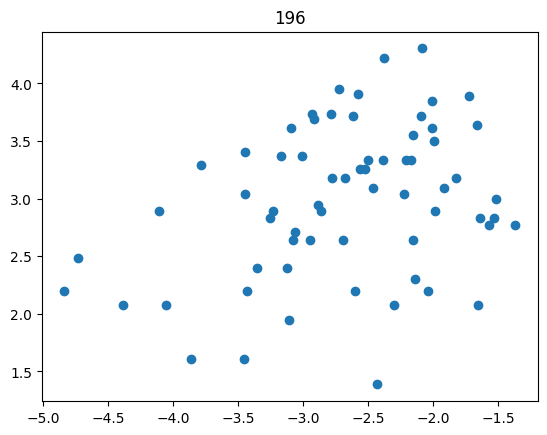

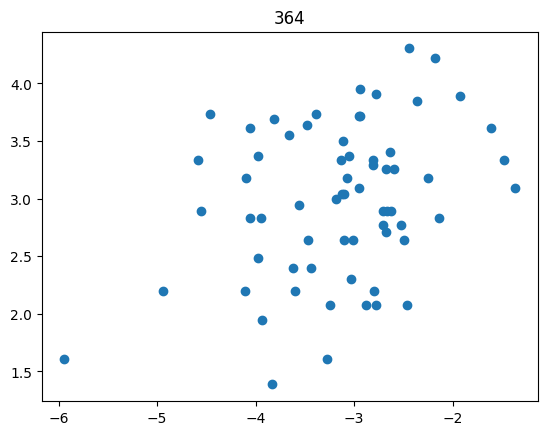

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 1


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 2


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

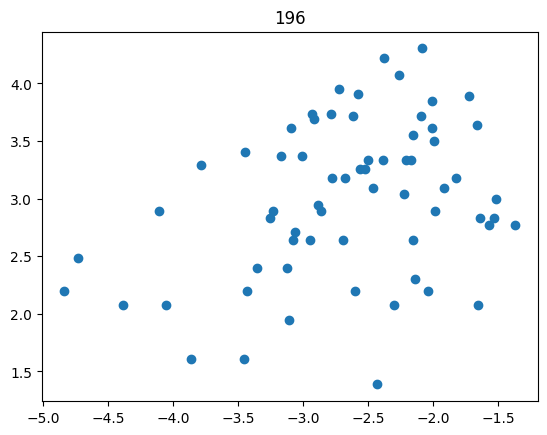

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 3


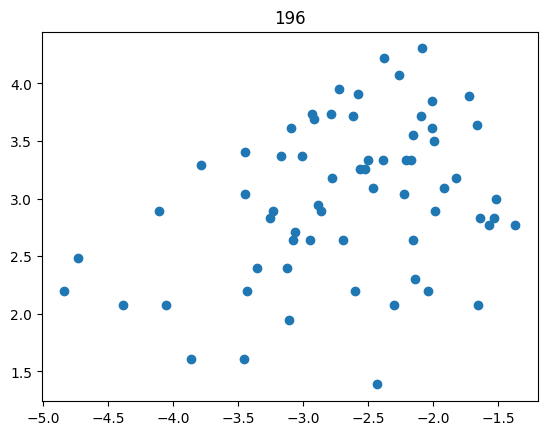

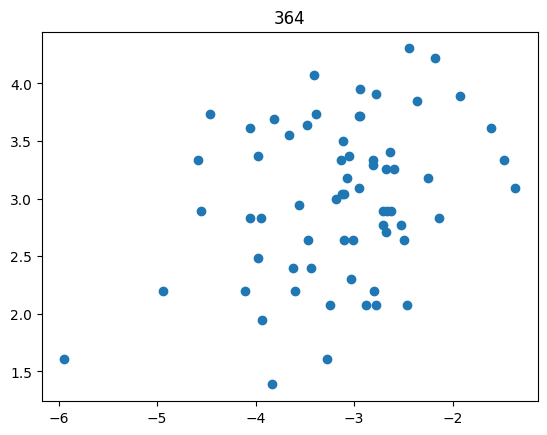

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 4


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

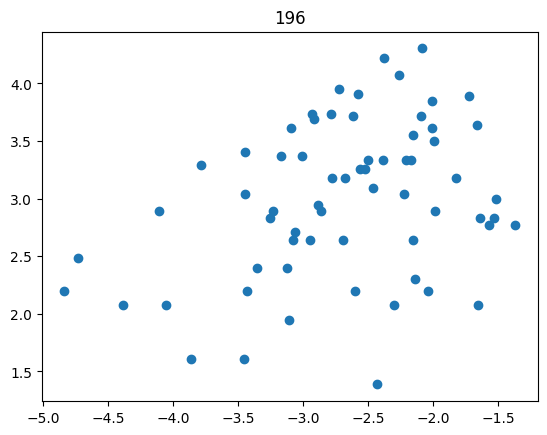

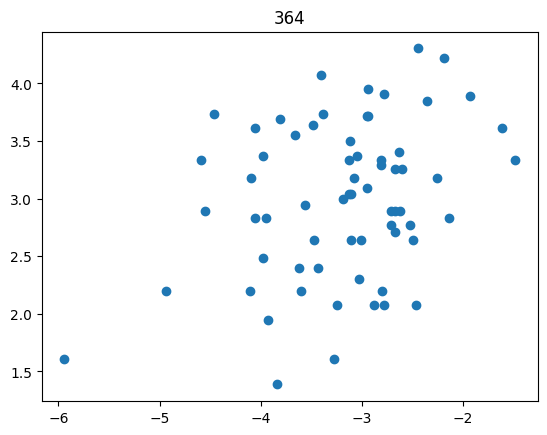

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 5


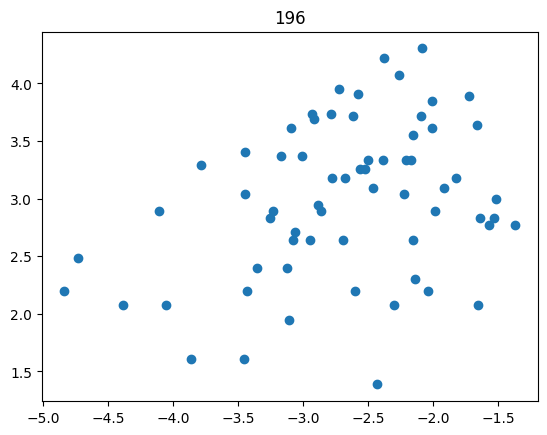

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 6


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

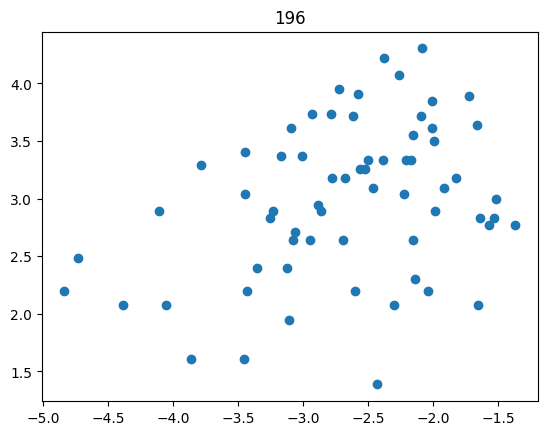

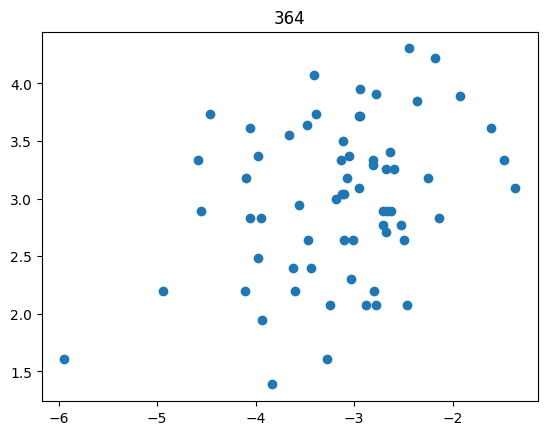

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 7


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

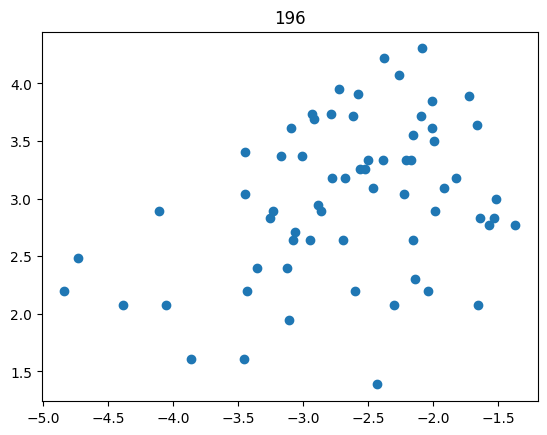

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 8


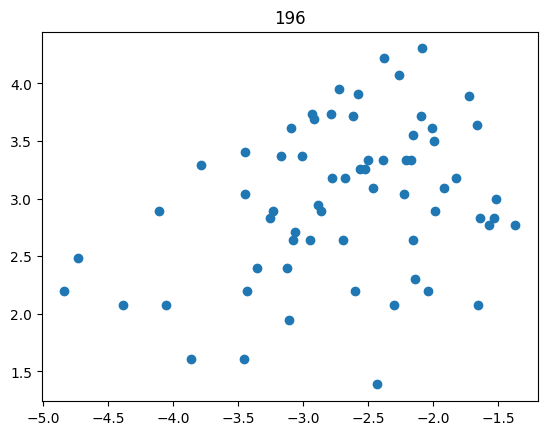

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 9


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


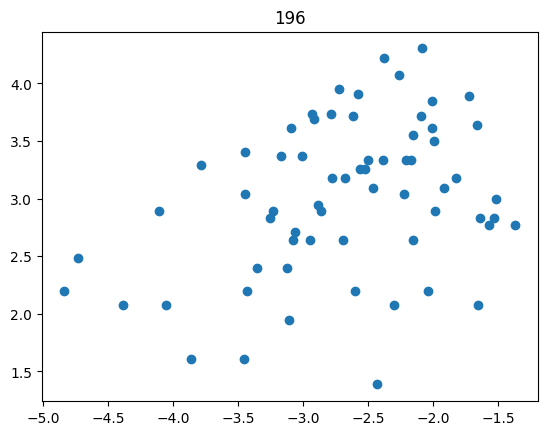

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 10


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


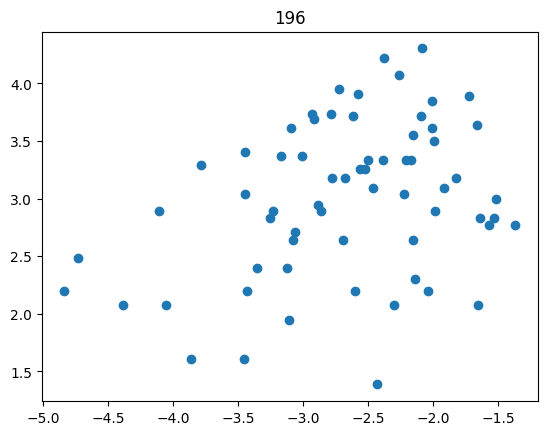

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 11


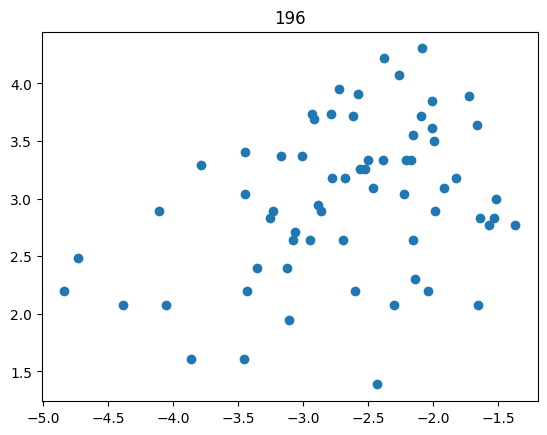

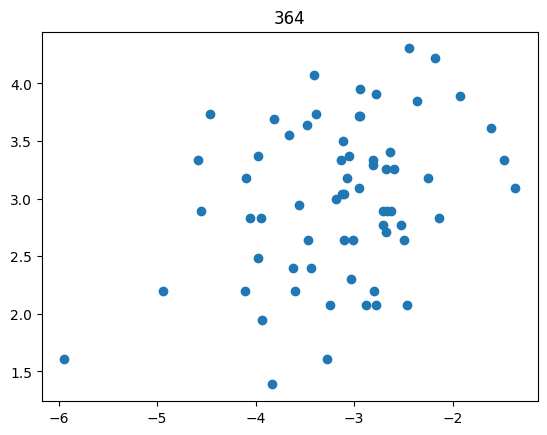

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 12


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


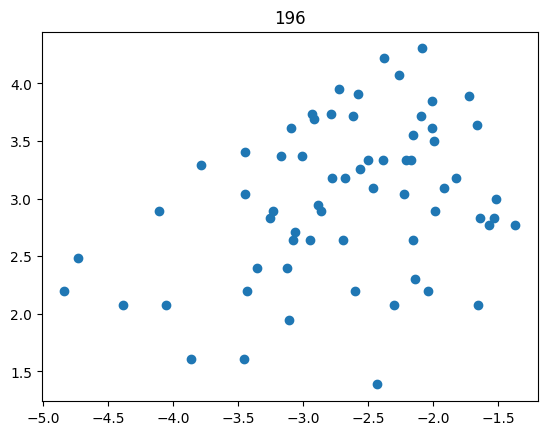

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 13


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


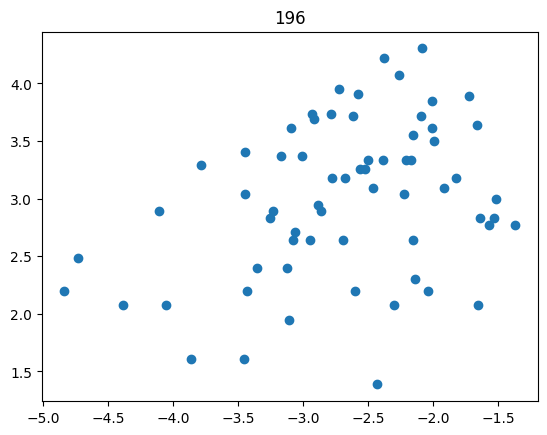

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 14


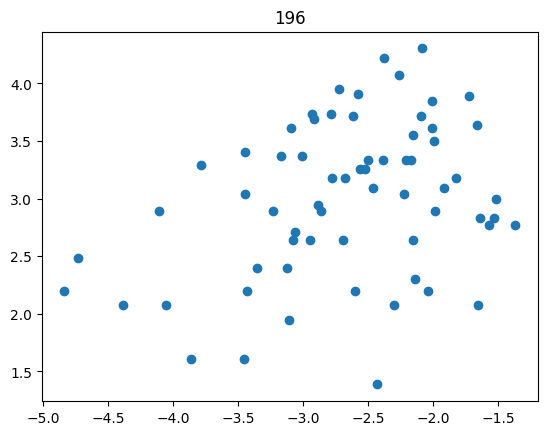

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 15


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

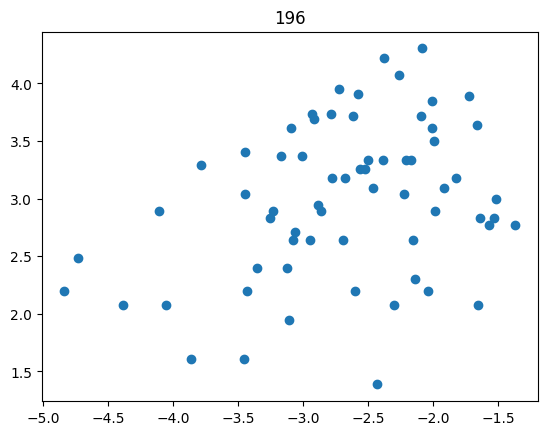

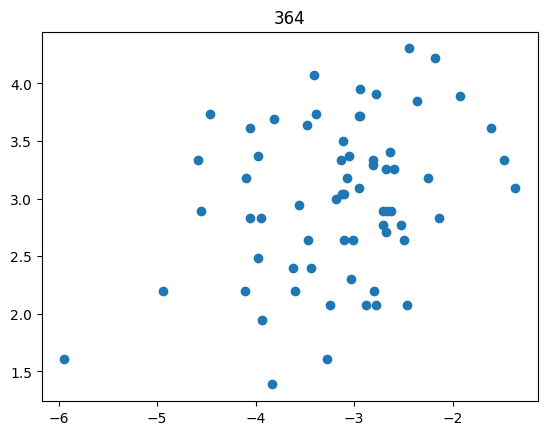

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 16


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


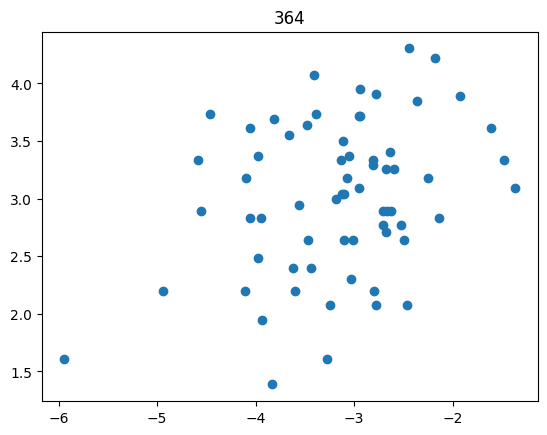

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 17


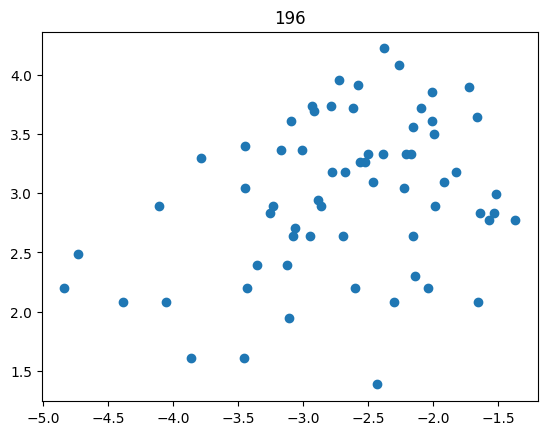

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 18


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

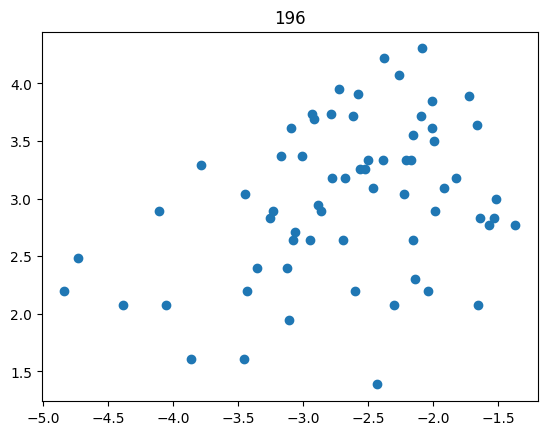

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 19


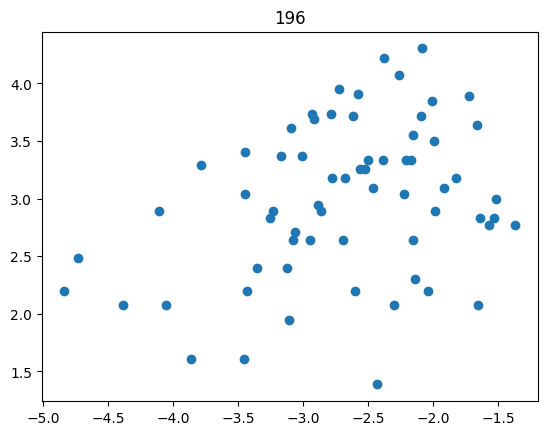

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 20


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

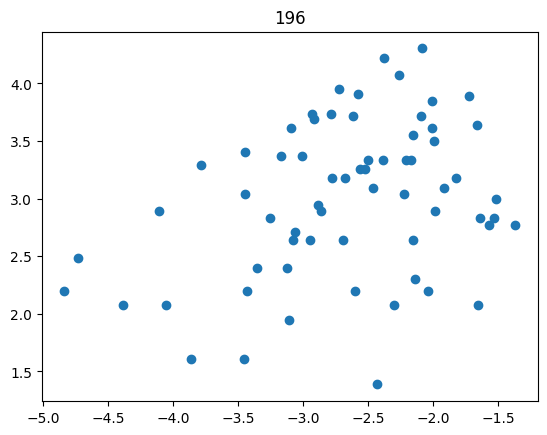

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 21


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

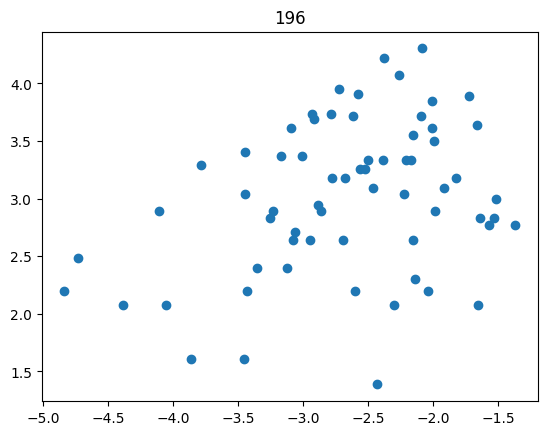

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 22


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


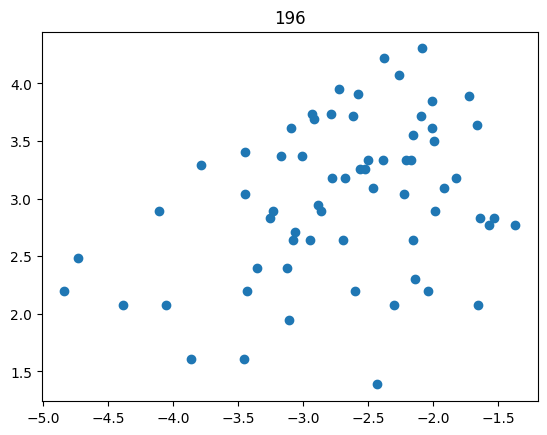

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 23


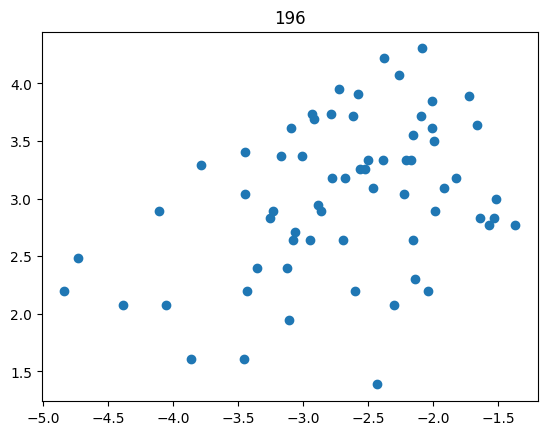

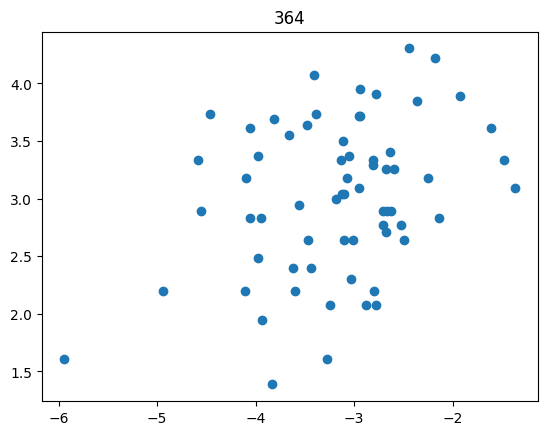

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 24


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

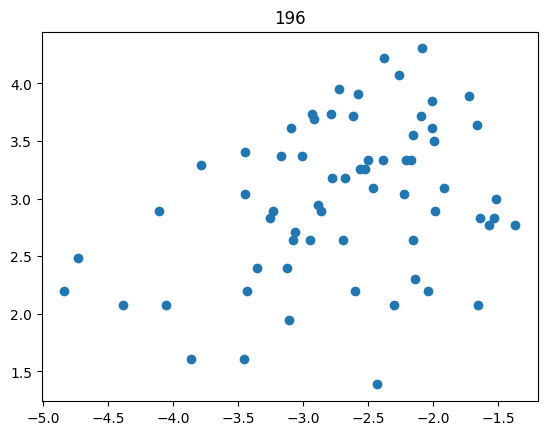

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 25


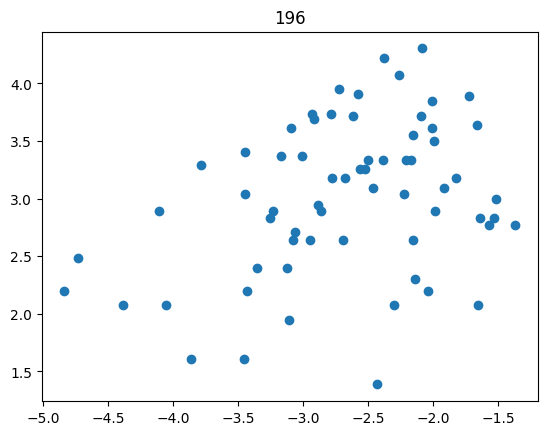

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 26


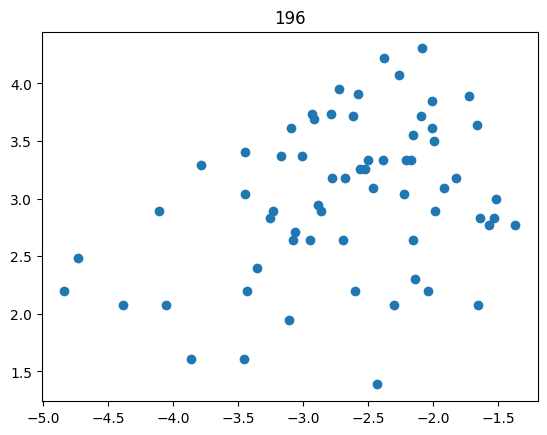

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 27


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

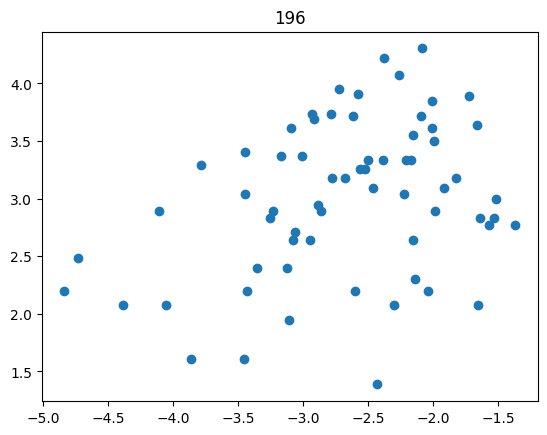

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 28


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 29


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

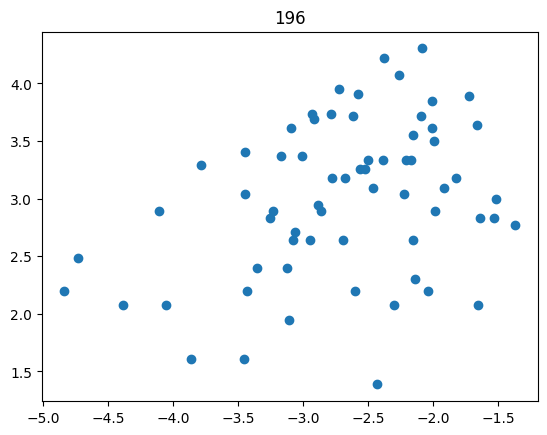

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 30


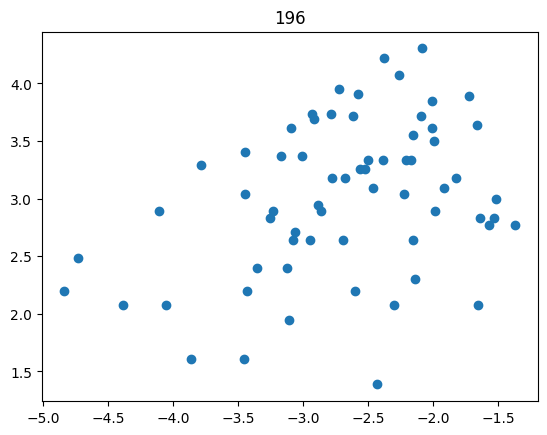

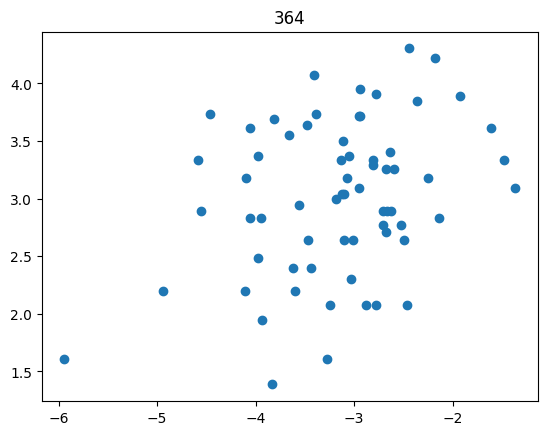

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 31


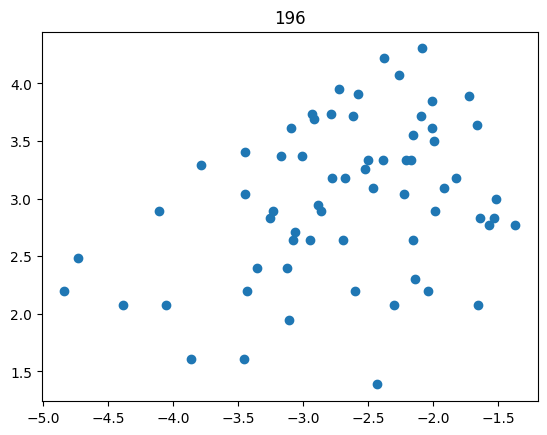

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 32


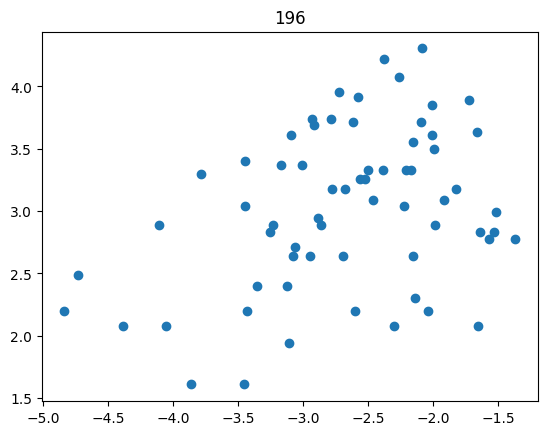

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 33


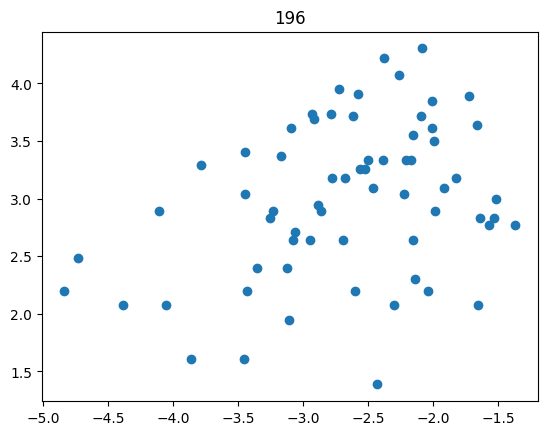

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 34


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

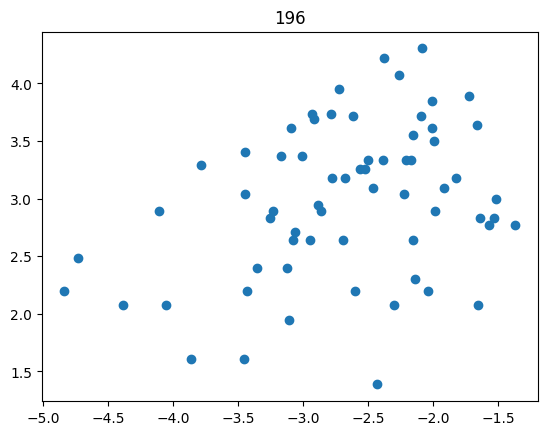

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 35


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

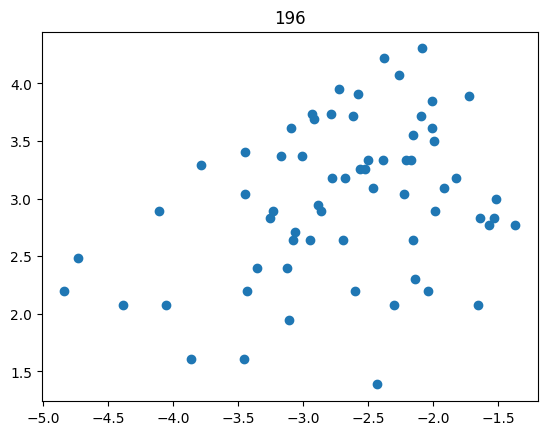

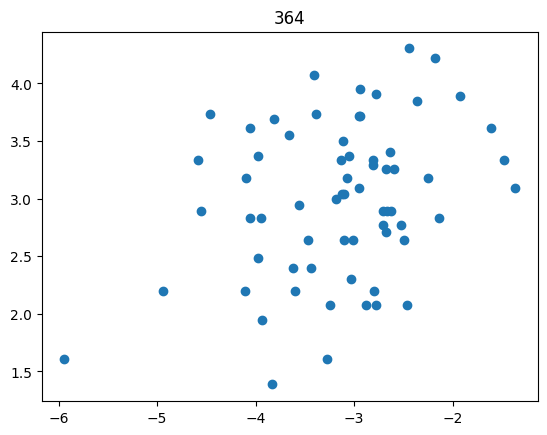

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 36


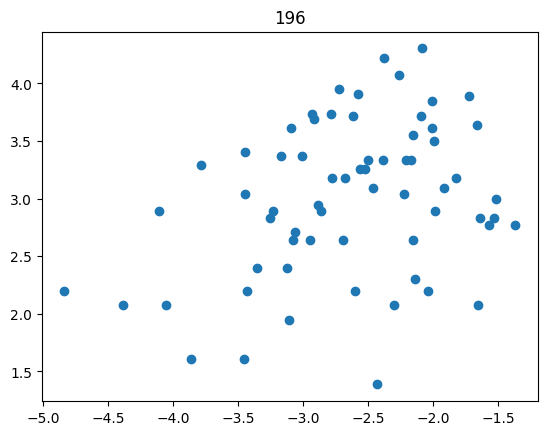

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 37


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 38


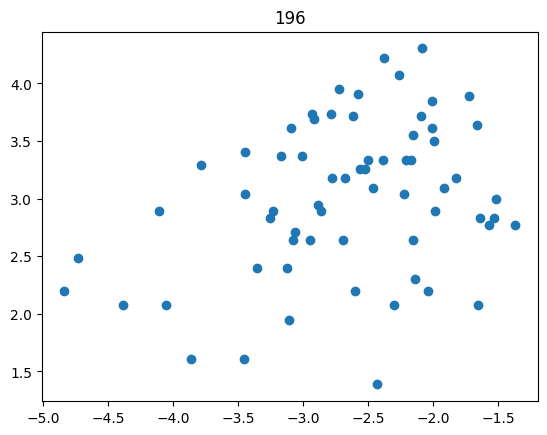

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 39


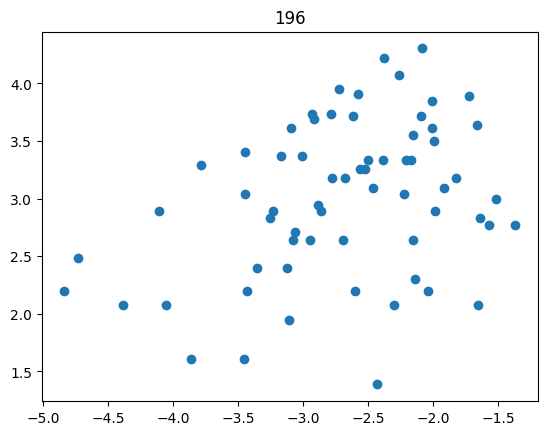

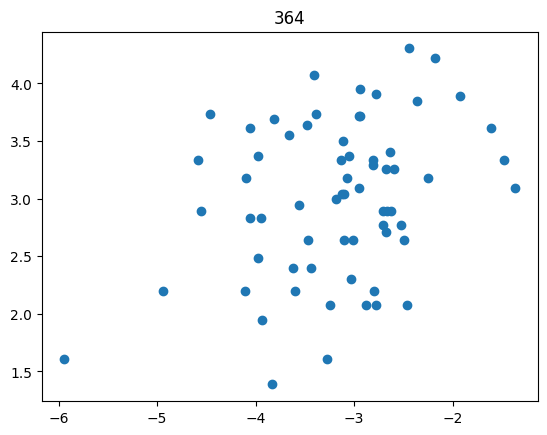

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 40


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


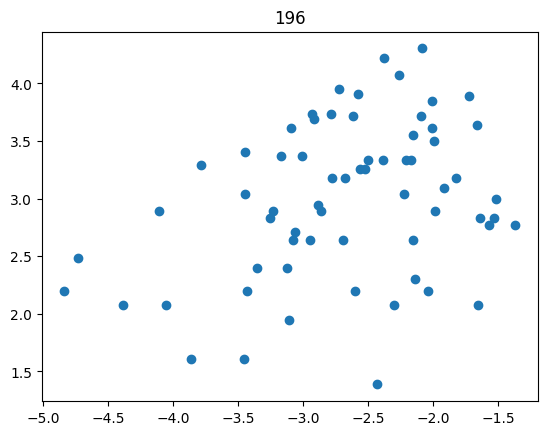

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 41


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


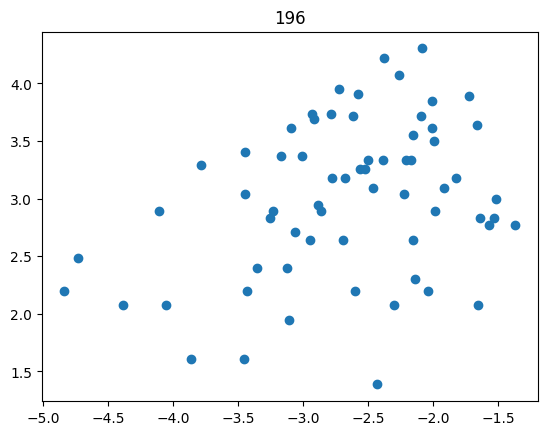

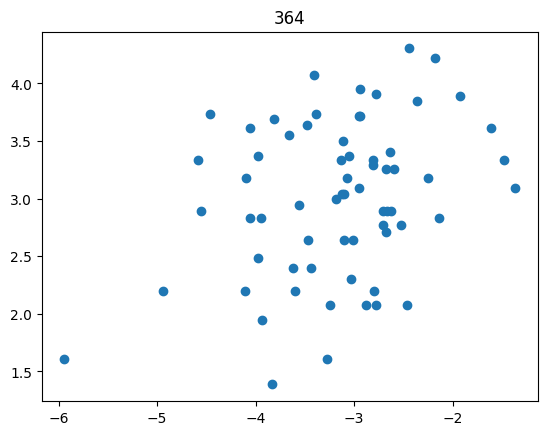

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 42


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

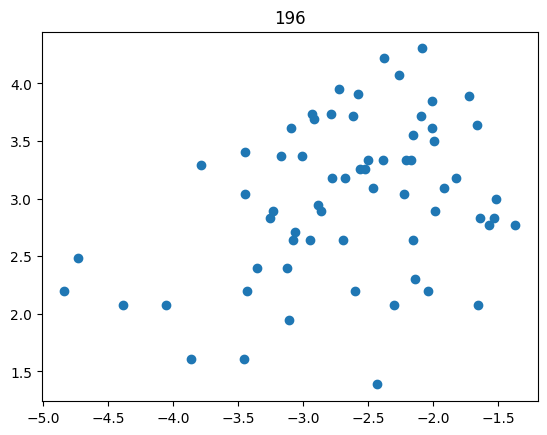

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 43


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

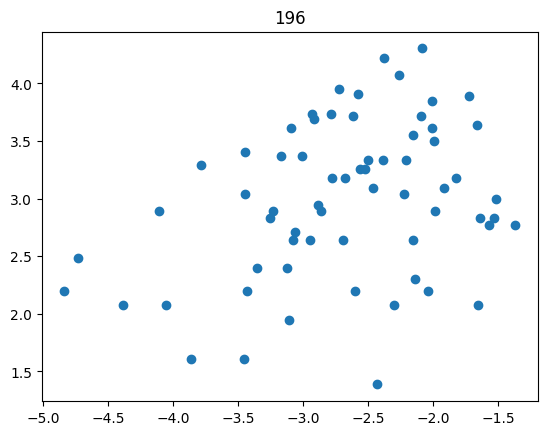

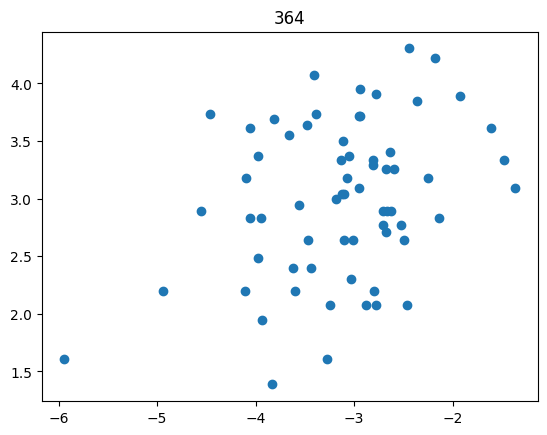

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 44


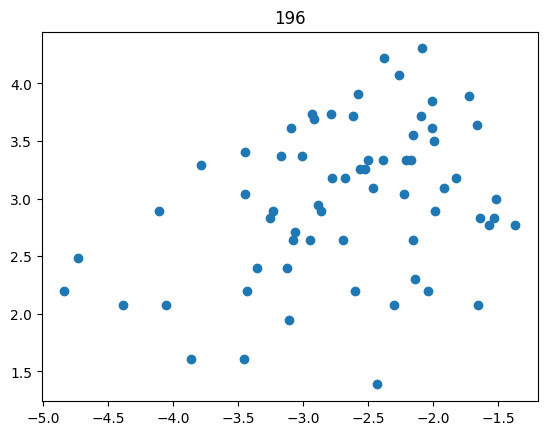

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 45


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 46


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


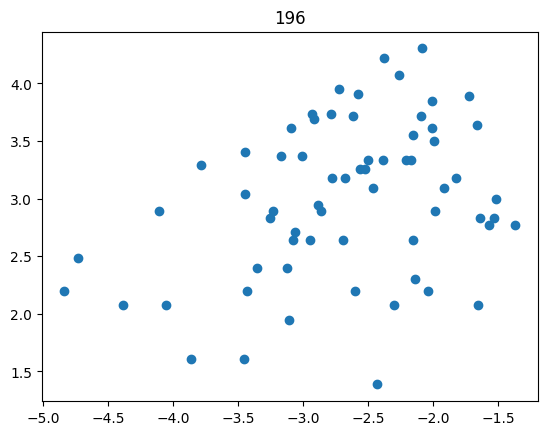

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 47


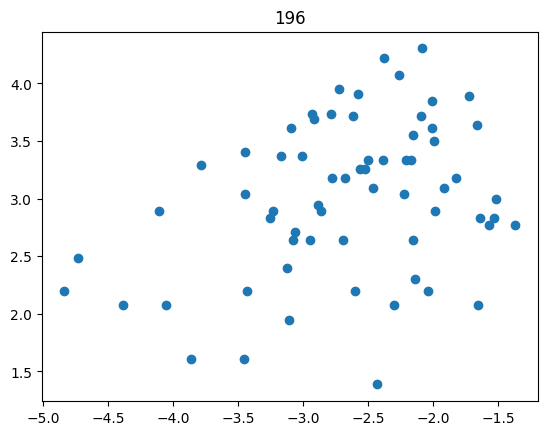

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 48


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


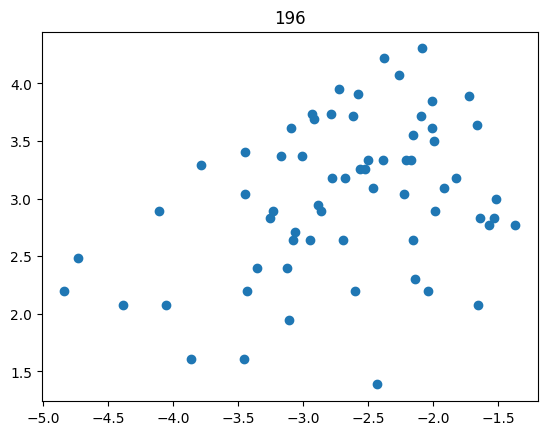

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 49


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


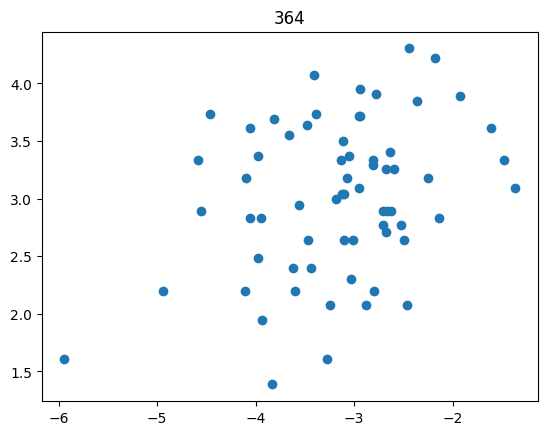

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 50


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

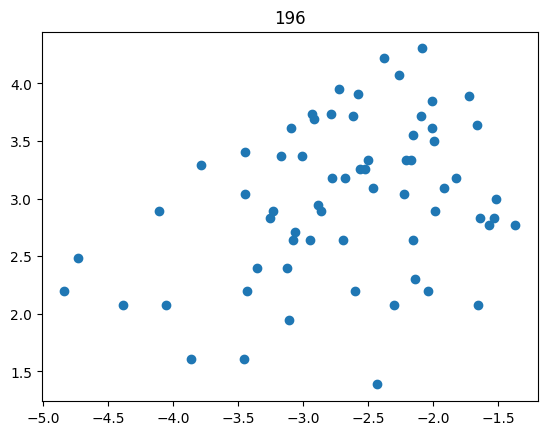

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 51


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

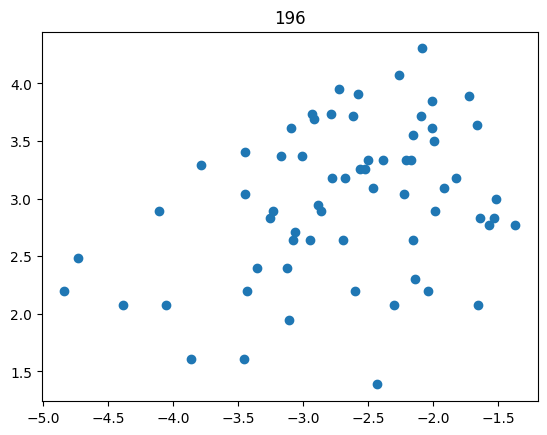

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 52


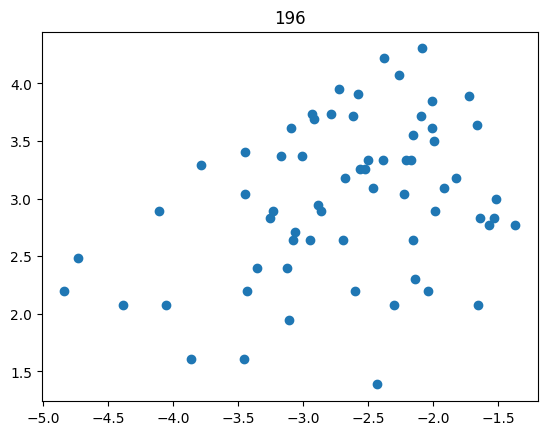

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 53


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

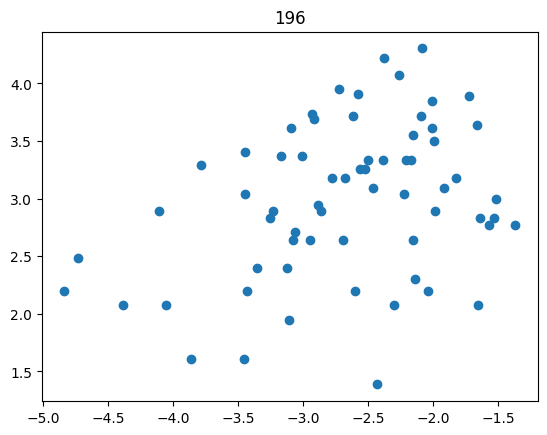

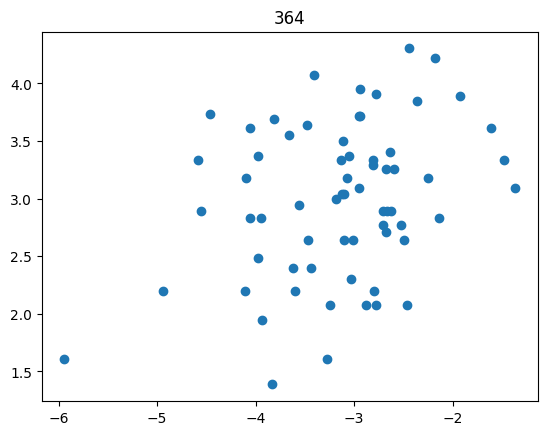

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 54


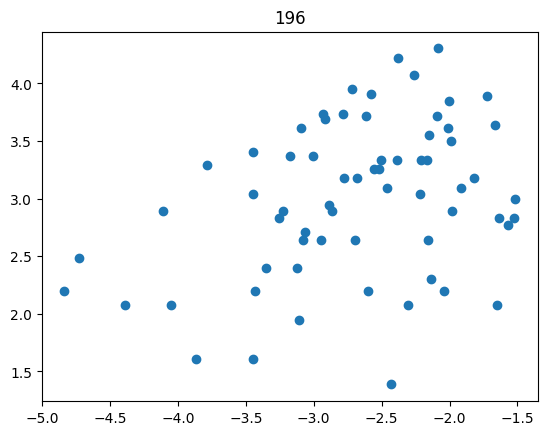

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 55


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

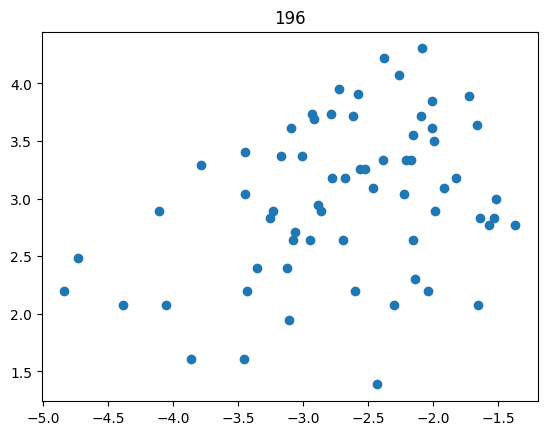

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 56


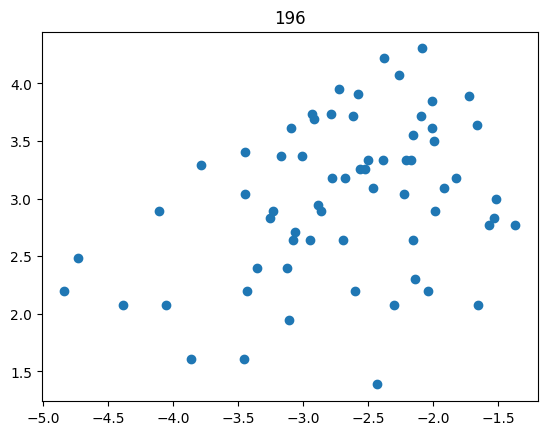

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 57


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


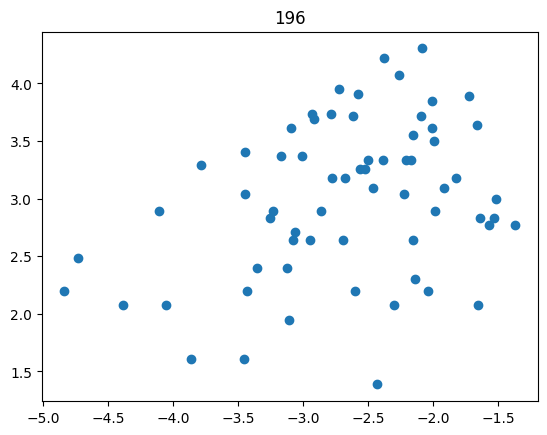

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 58


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


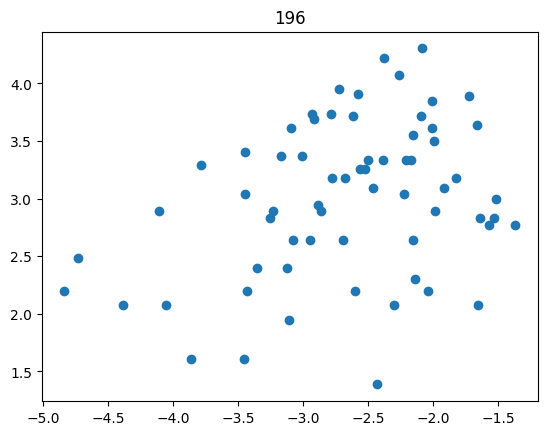

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 59


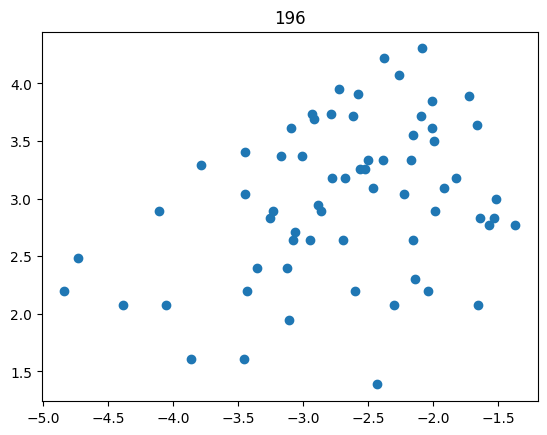

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 60


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


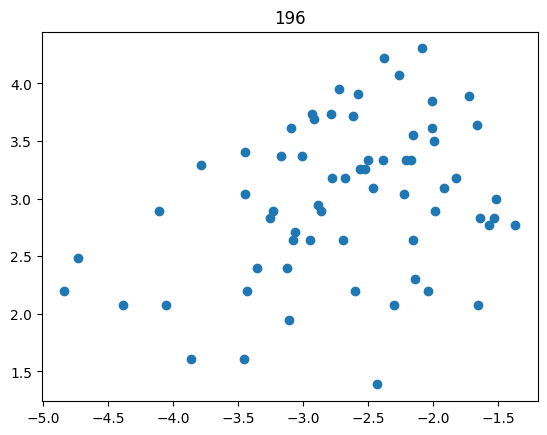

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 61


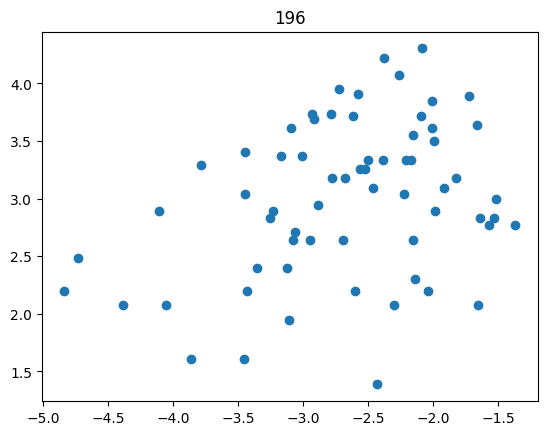

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 62


/home/ines/miniconda3/envs/iblenv/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/ines/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4891: RuntimeWarning: invalid value encountered in subtract
  xm = x - xmean
/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


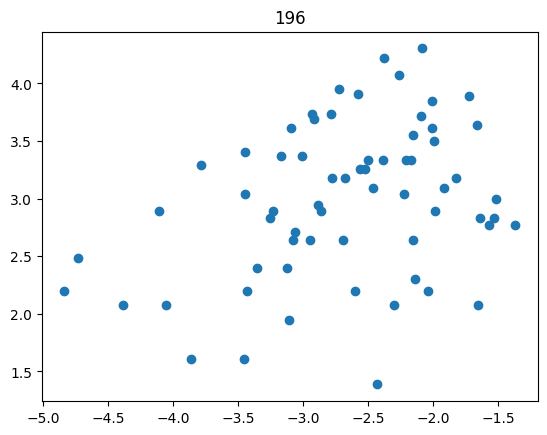

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 63


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

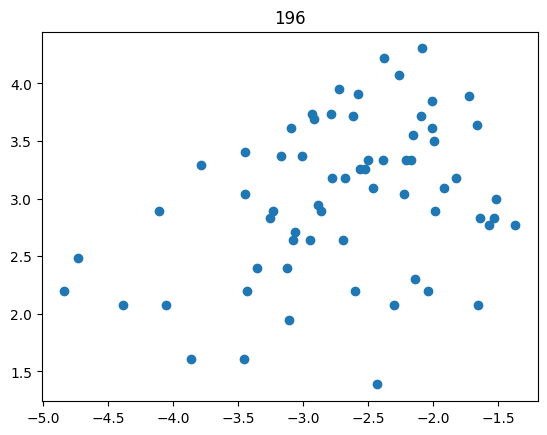

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 64


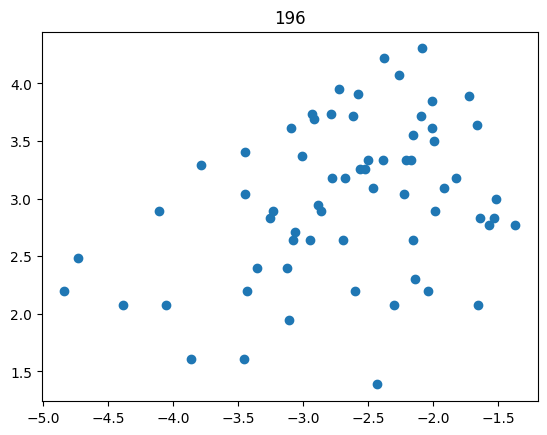

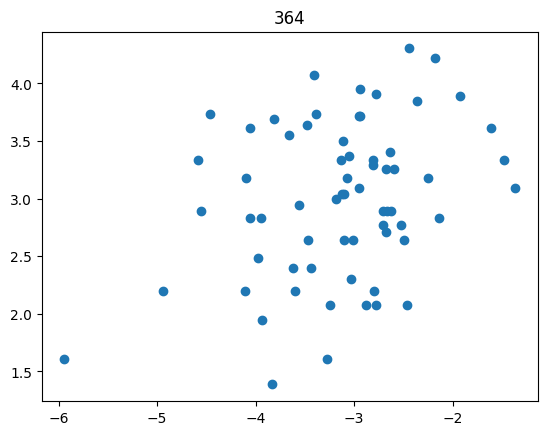

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 65


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


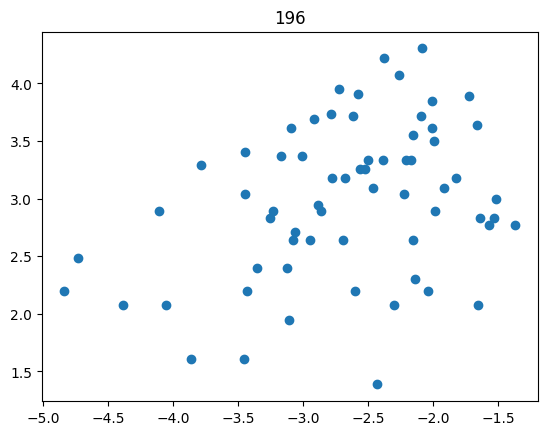

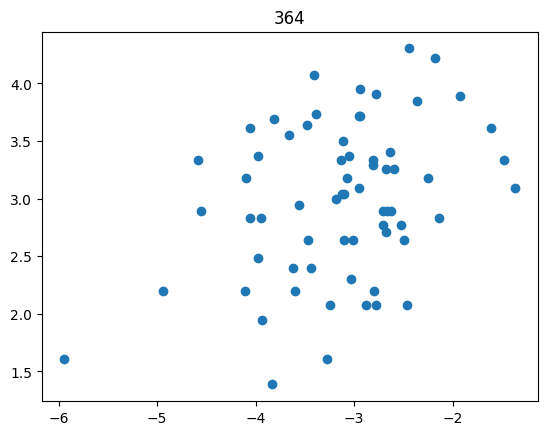

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 0


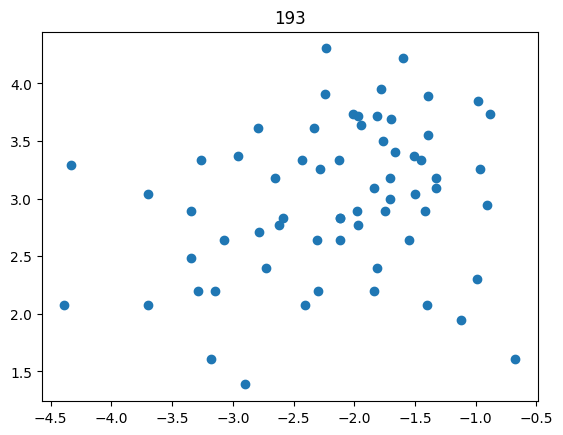

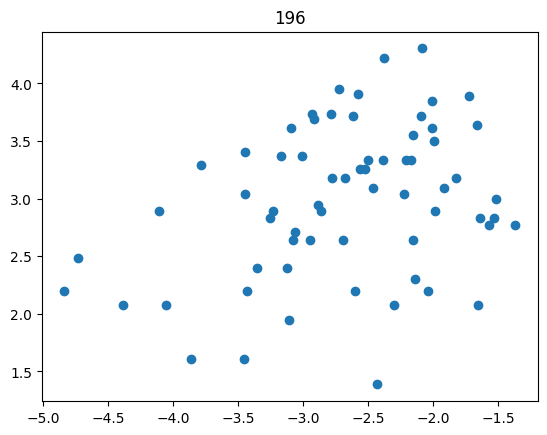

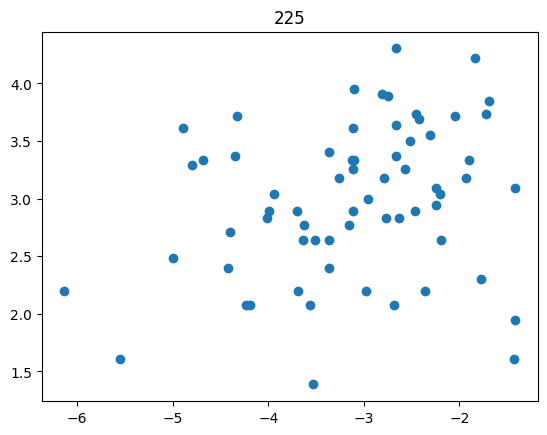

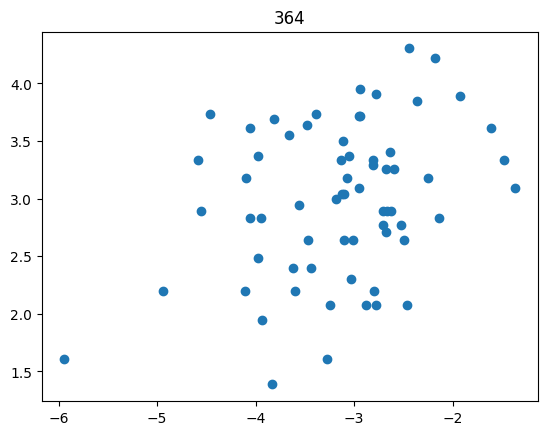

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 1


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

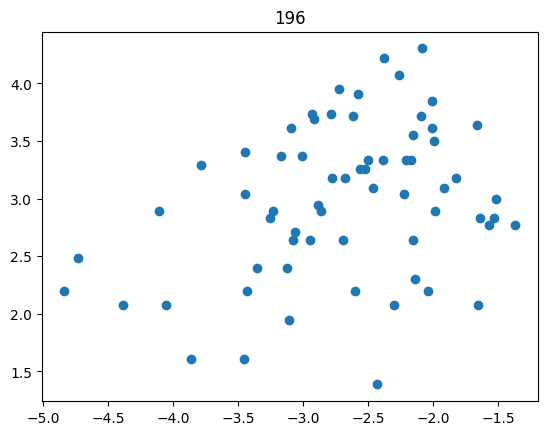

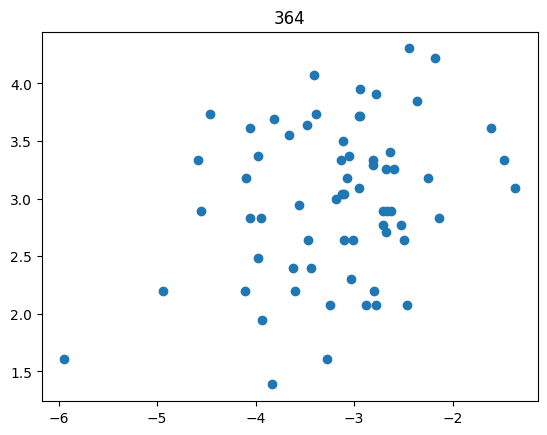

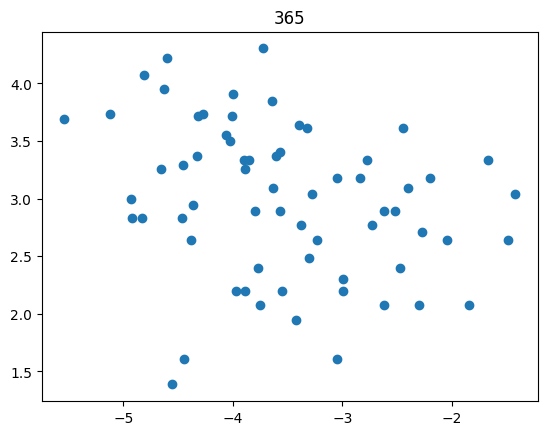

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 2


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

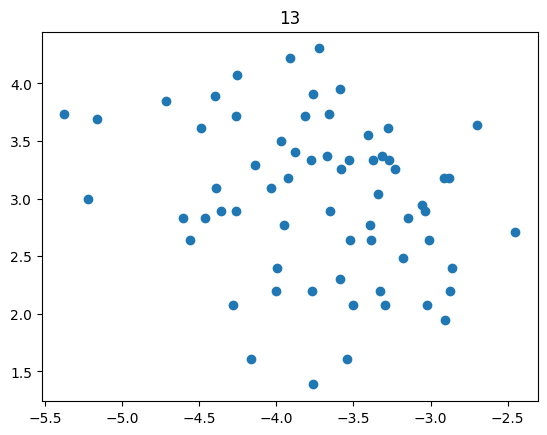

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


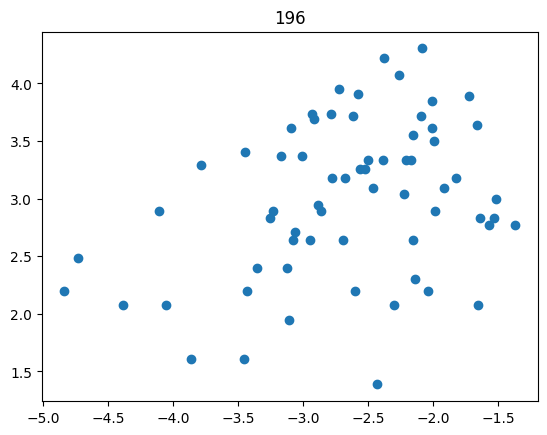

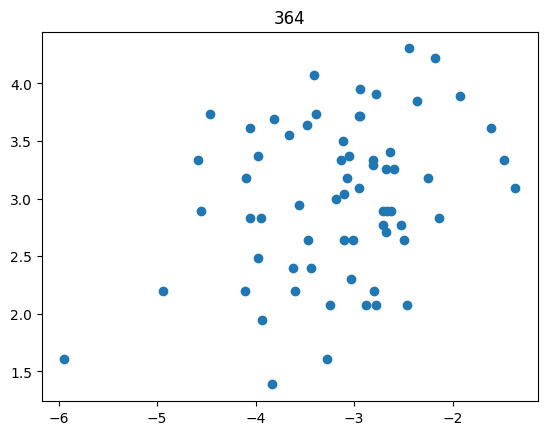

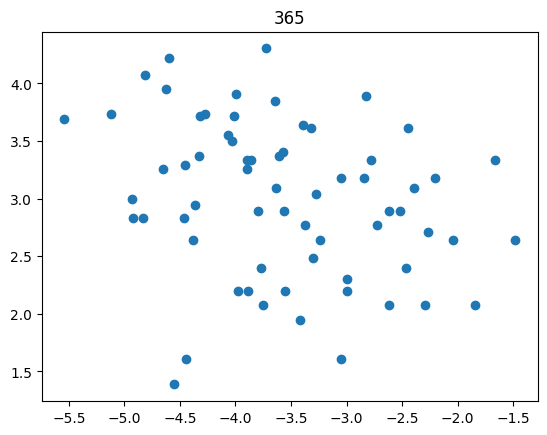

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 3


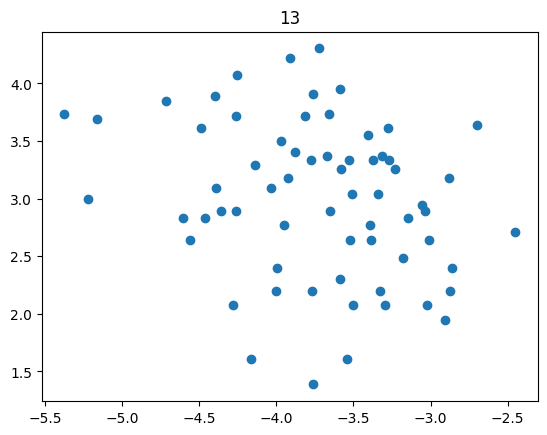

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


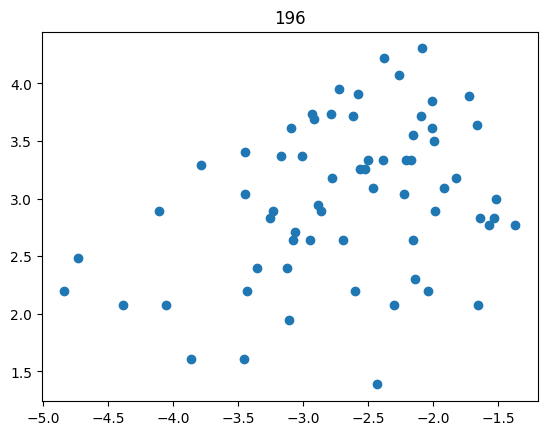

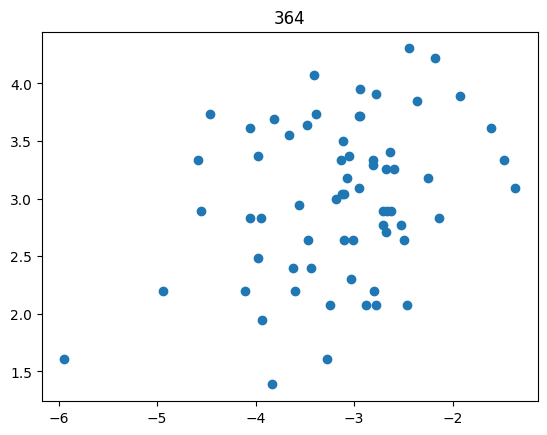

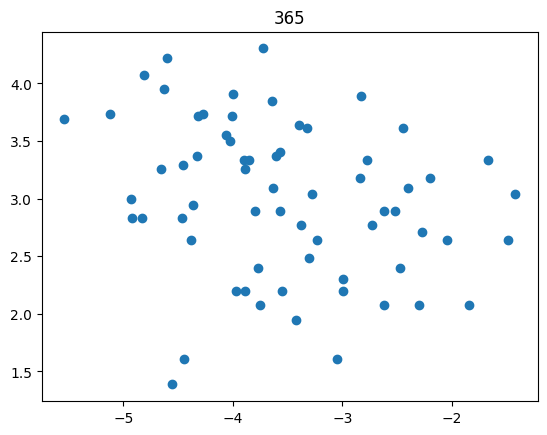

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 4


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

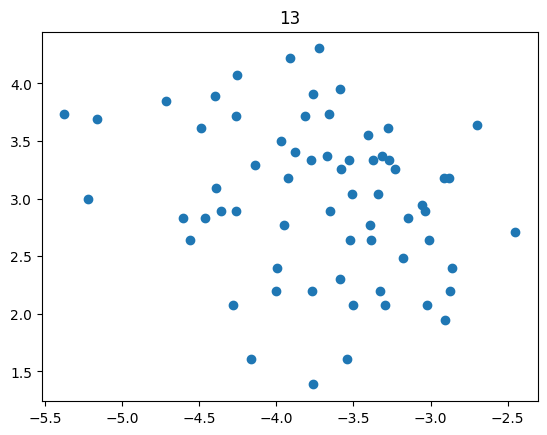

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


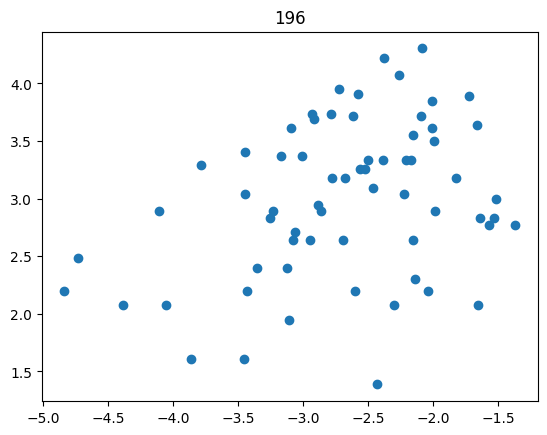

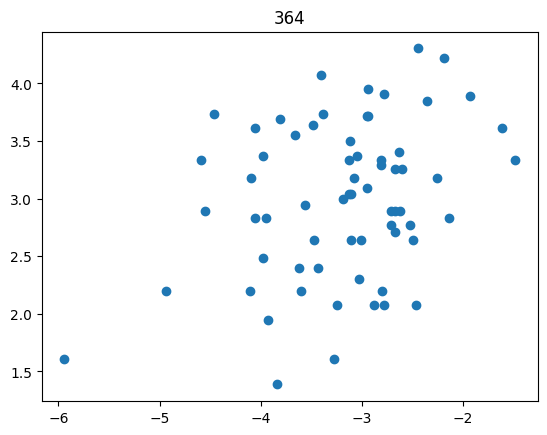

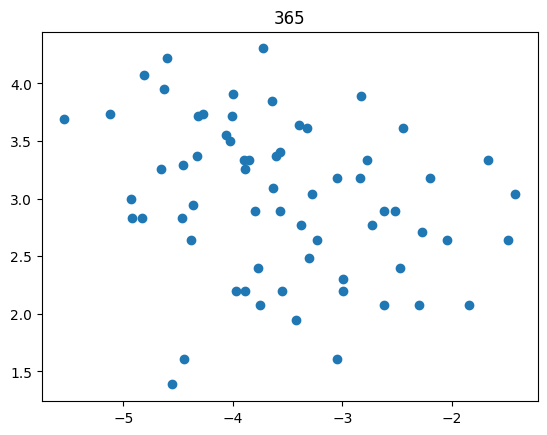

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 5


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


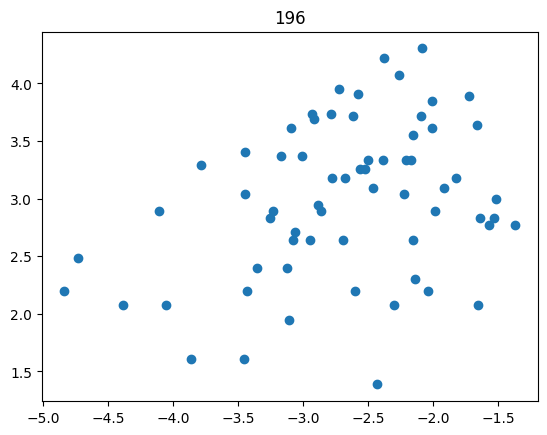

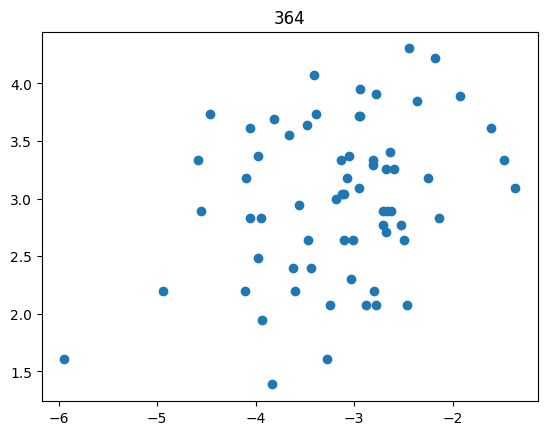

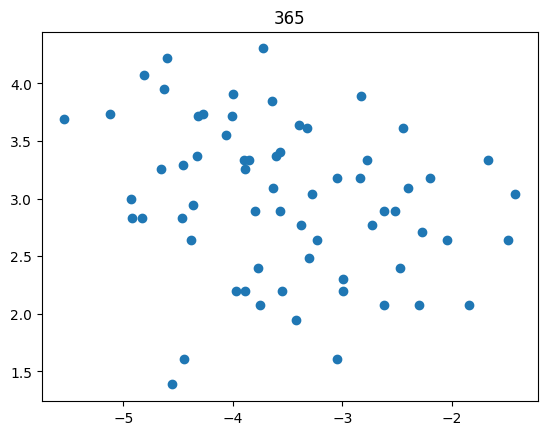

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 6


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

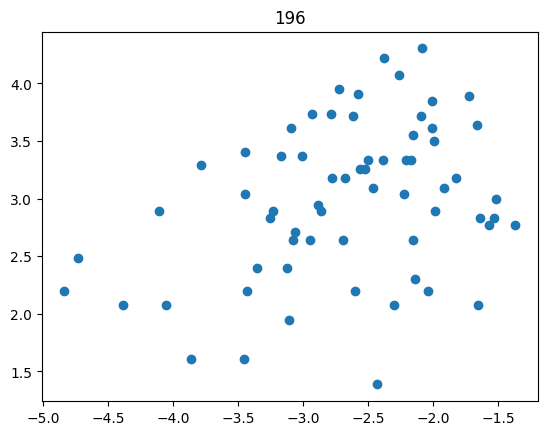

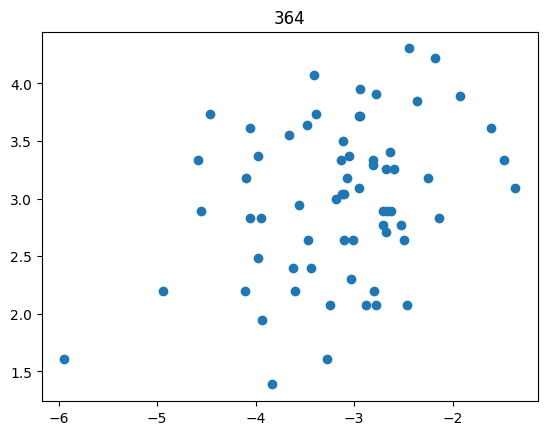

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 7


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

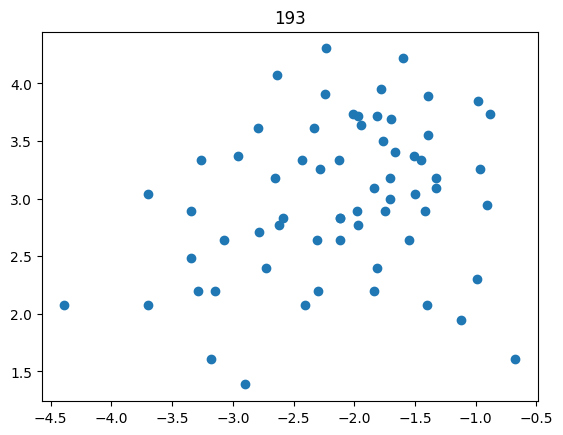

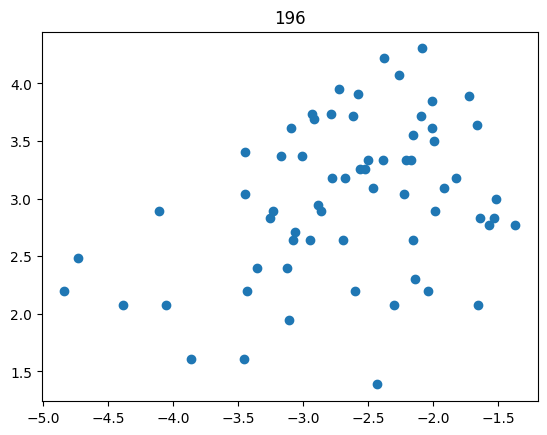

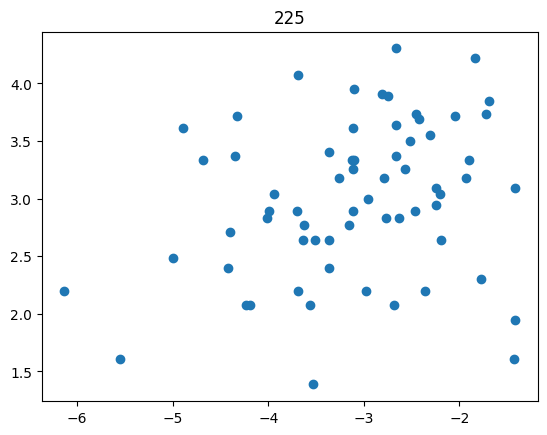

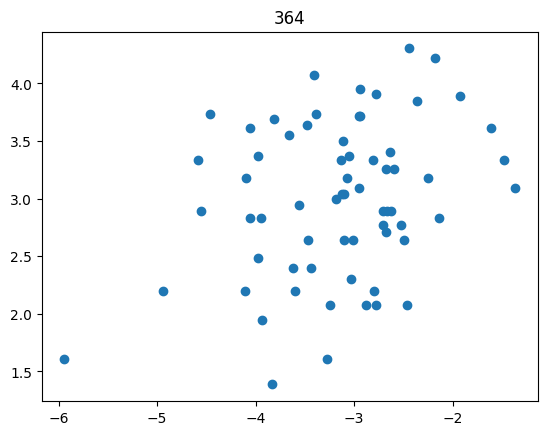

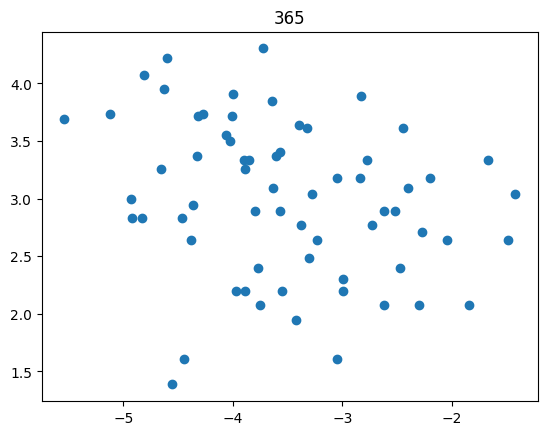

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 8


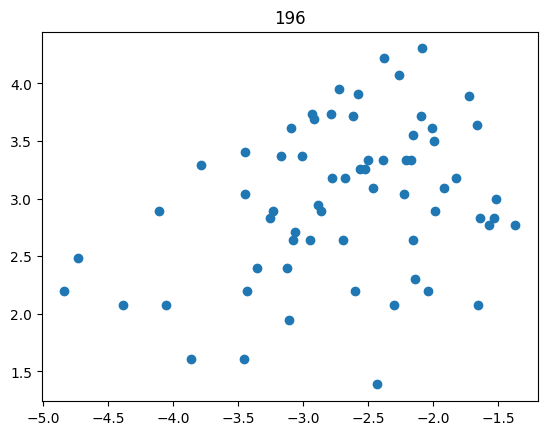

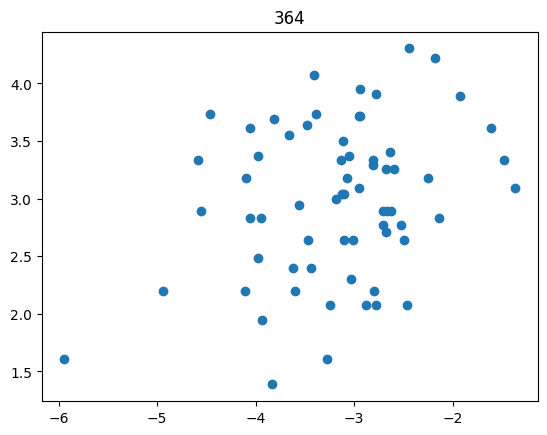

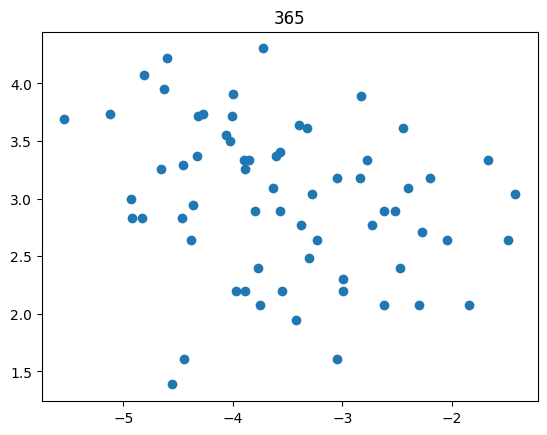

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 9


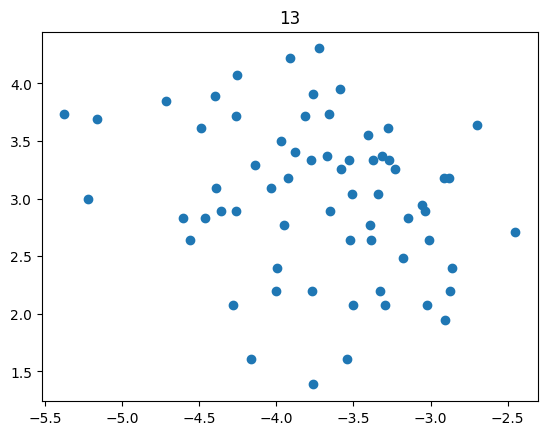

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


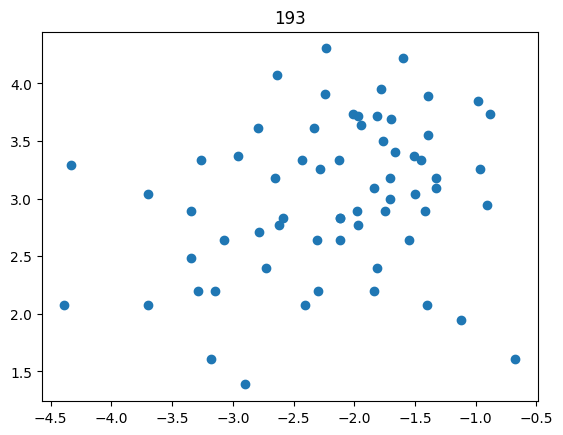

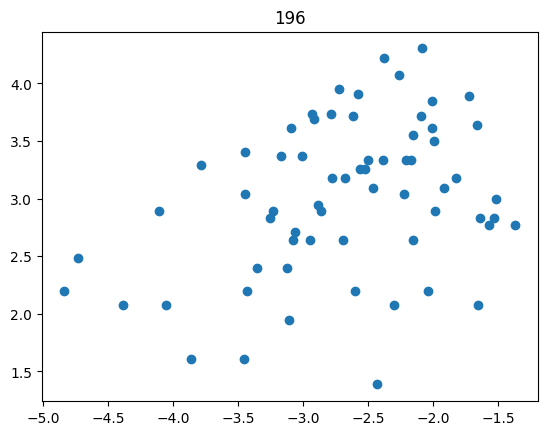

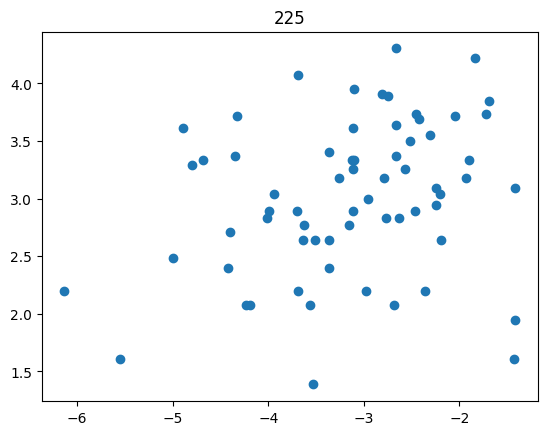

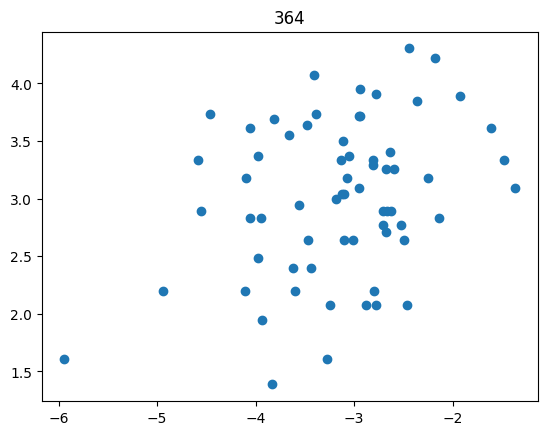

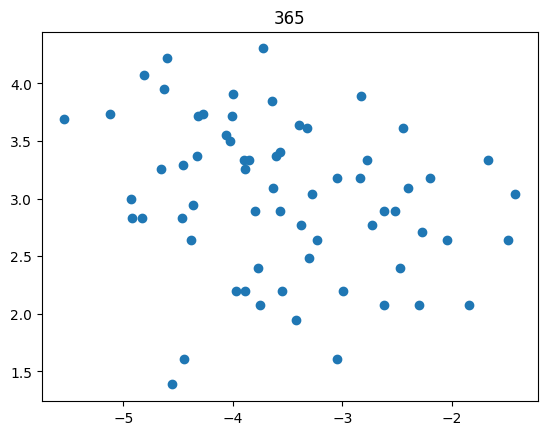

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 10


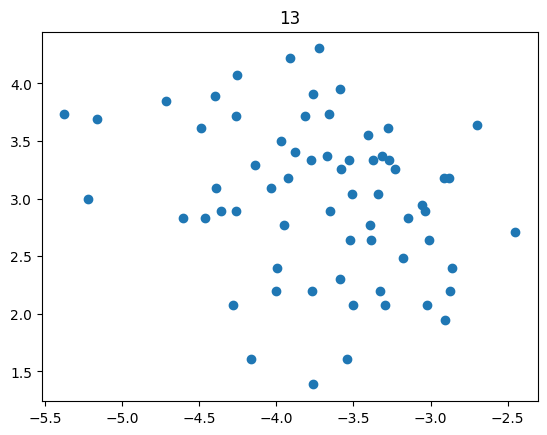

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


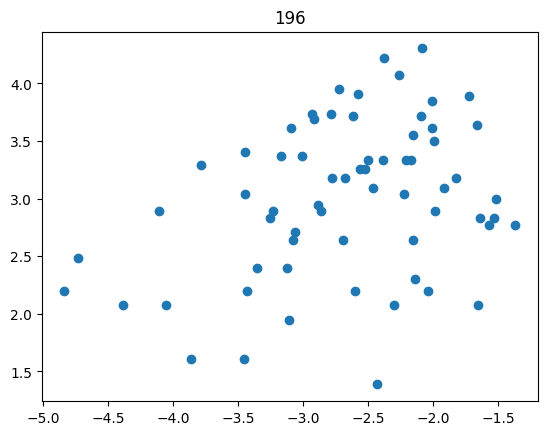

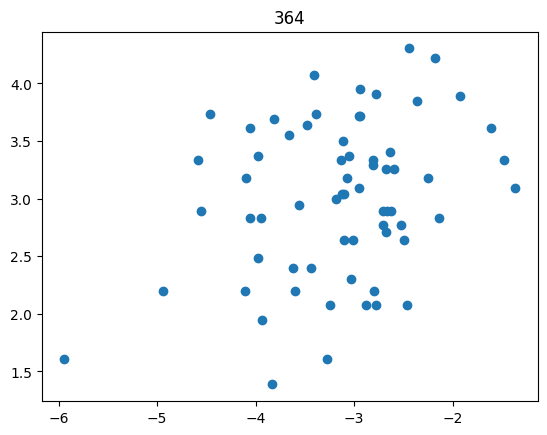

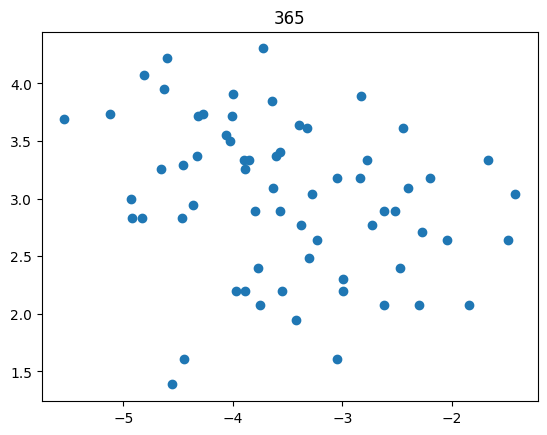

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 11


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


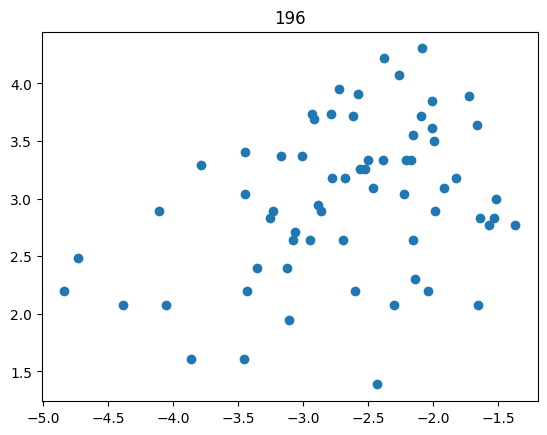

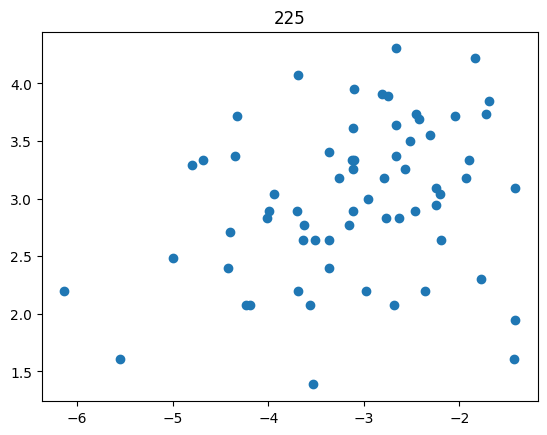

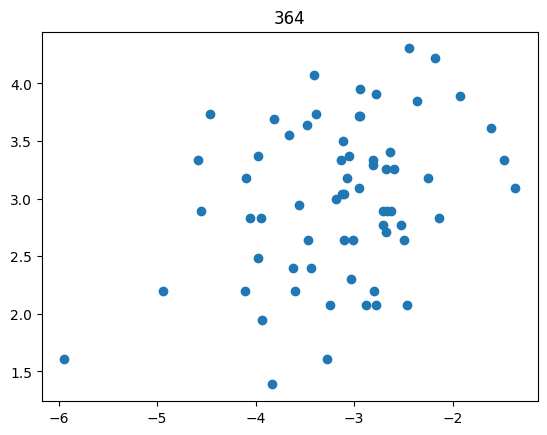

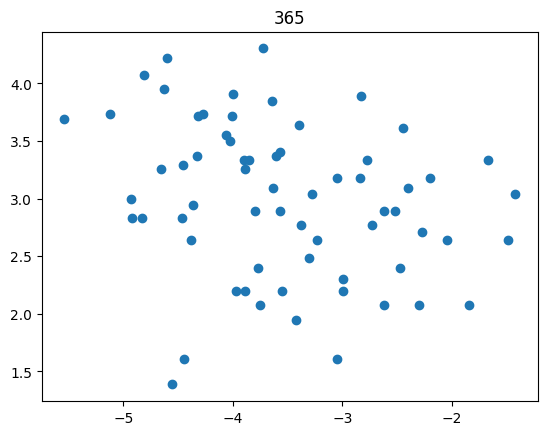

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 12


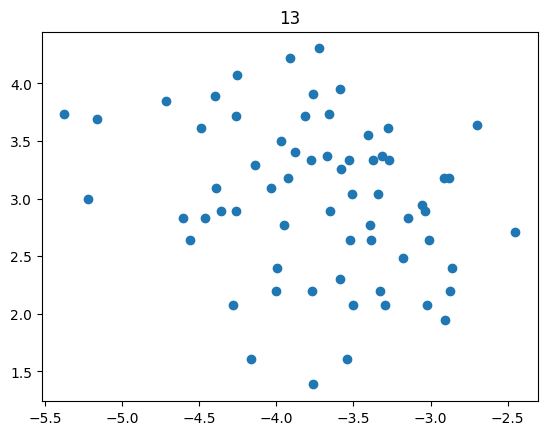

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


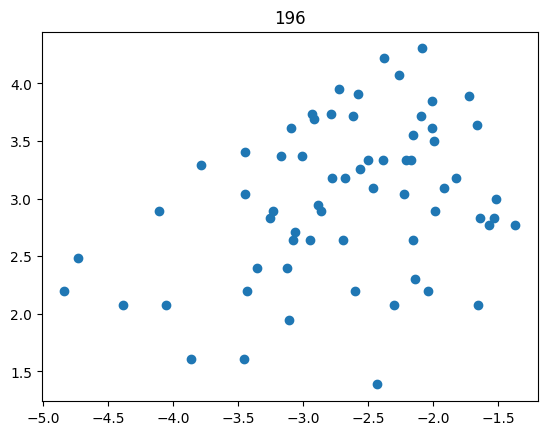

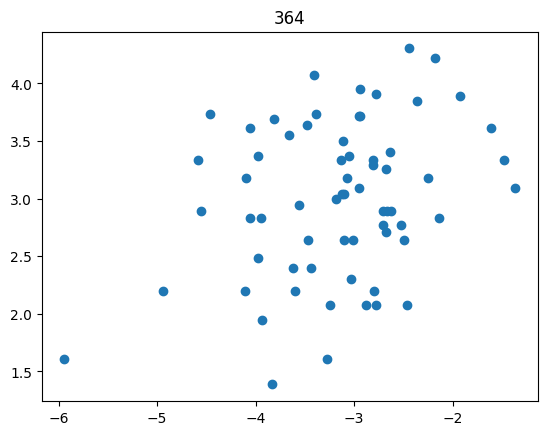

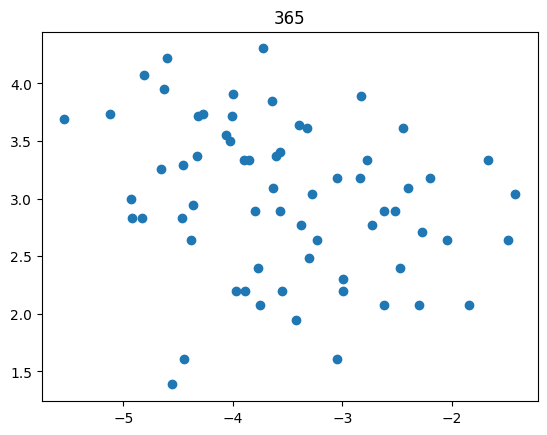

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 13


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

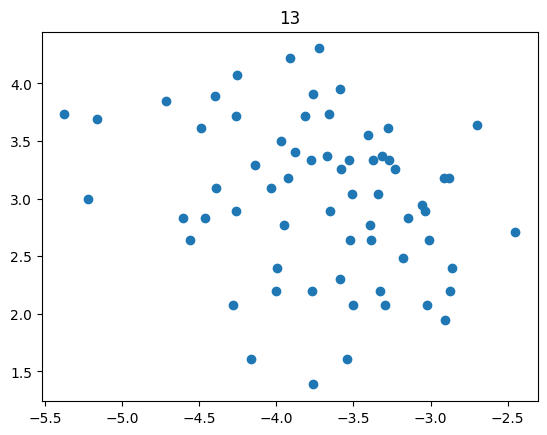

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


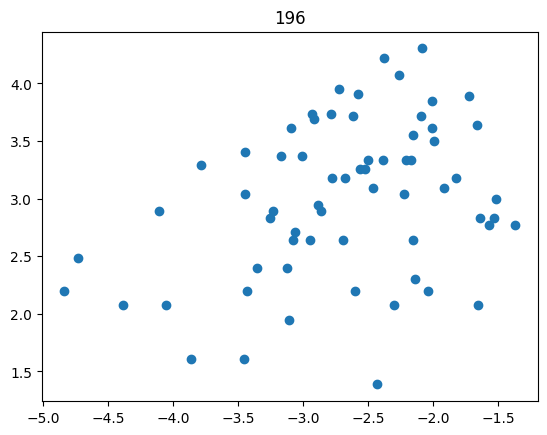

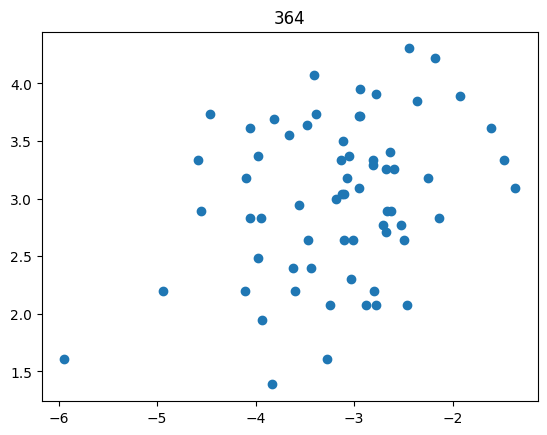

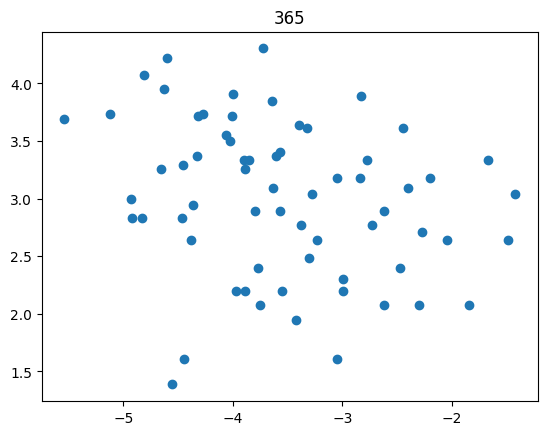

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 14


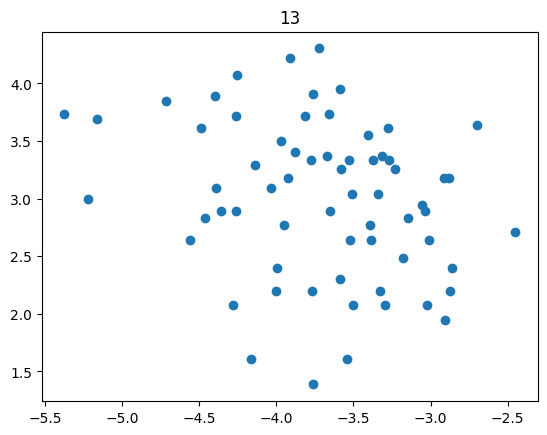

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


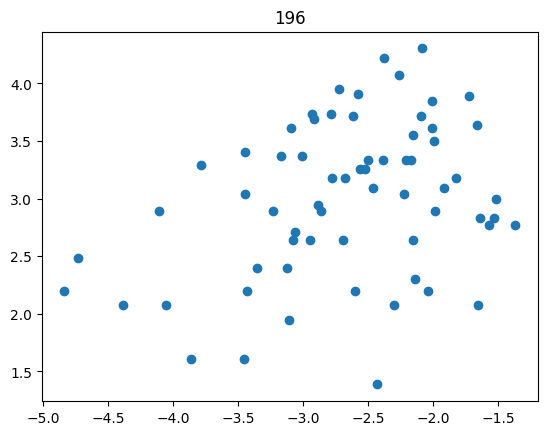

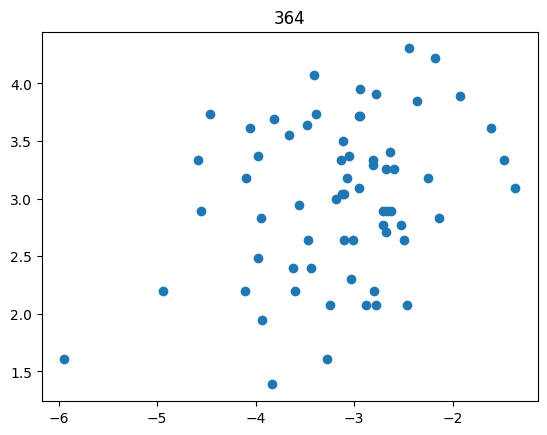

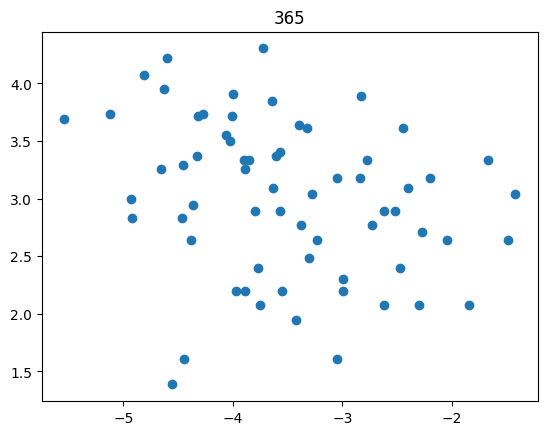

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 15


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

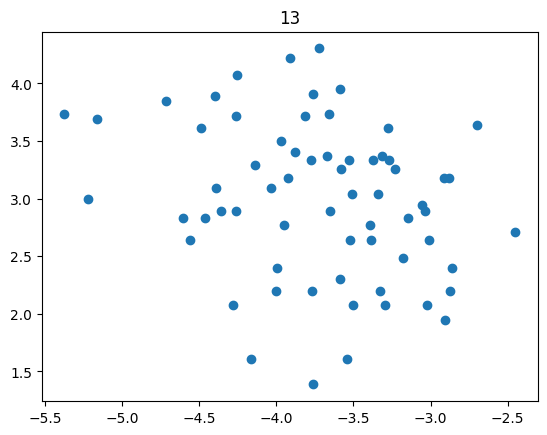

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


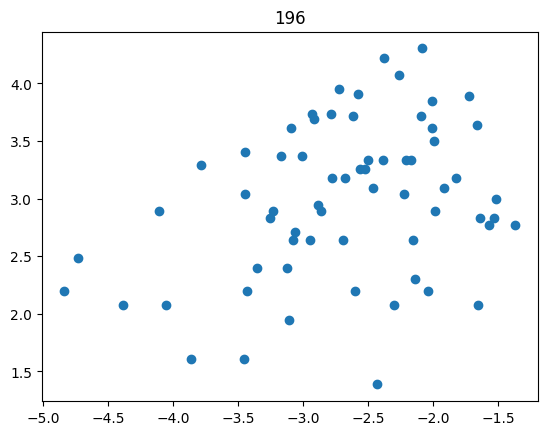

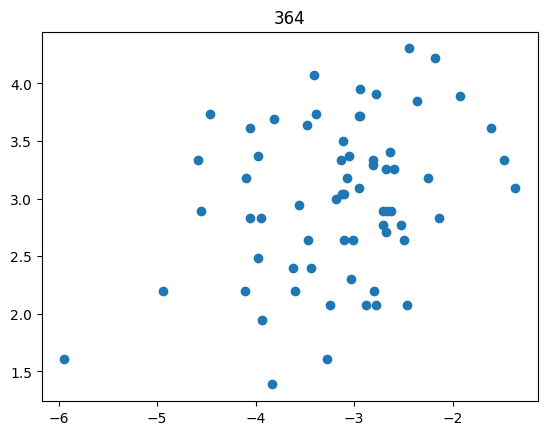

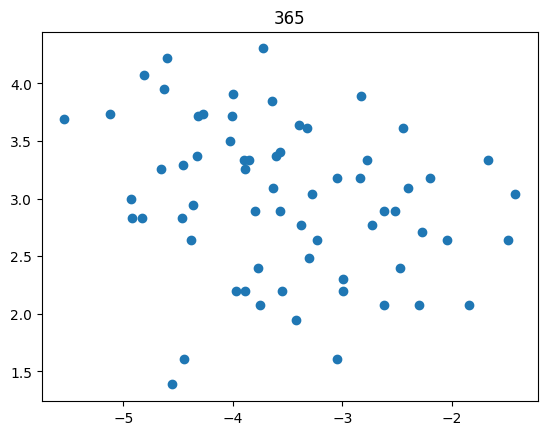

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 16


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


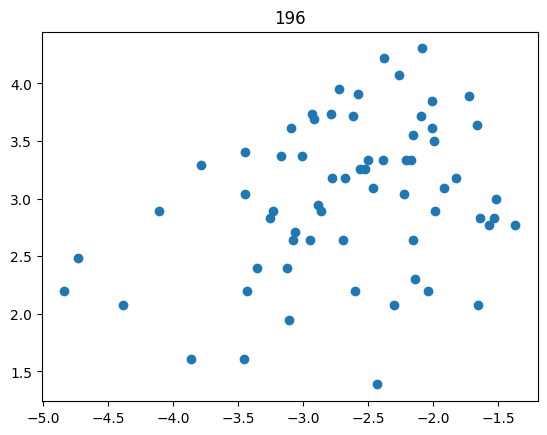

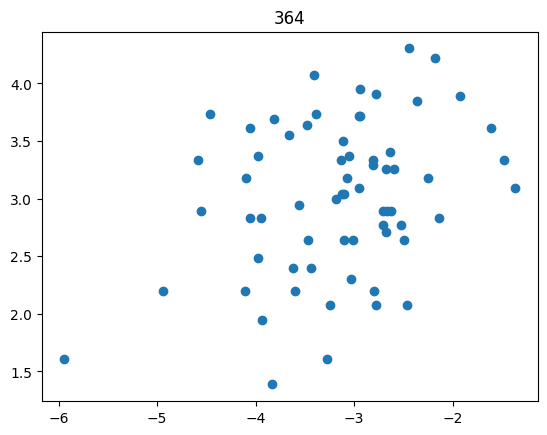

Processing mouse 17


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

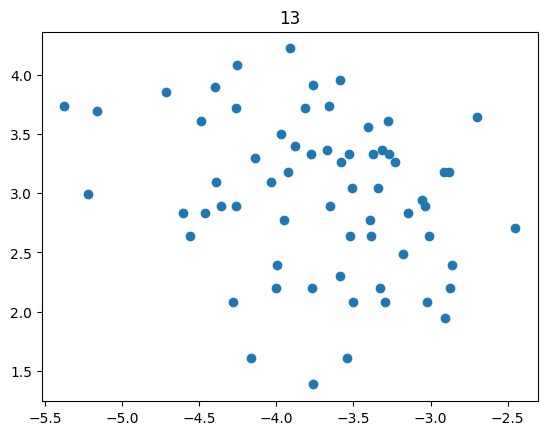

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


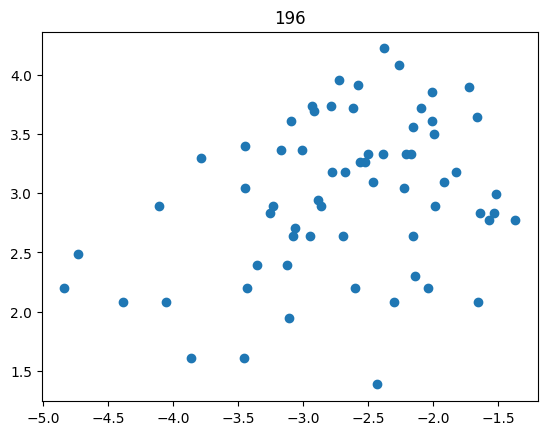

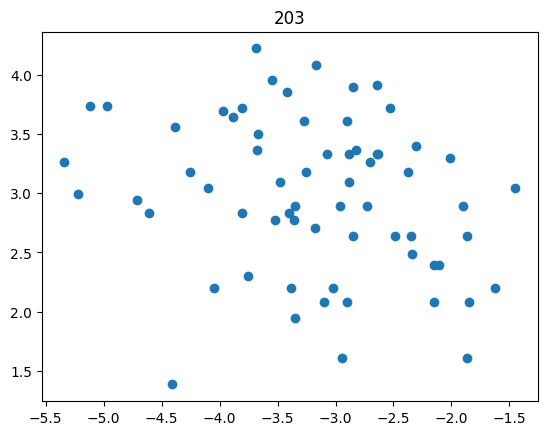

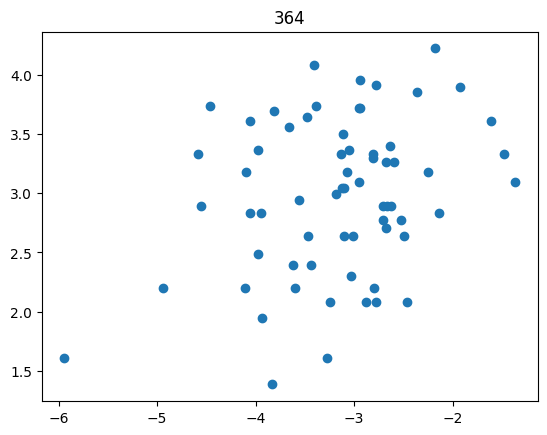

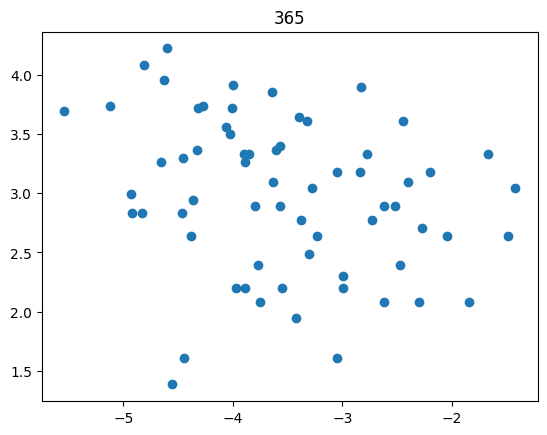

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 18


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

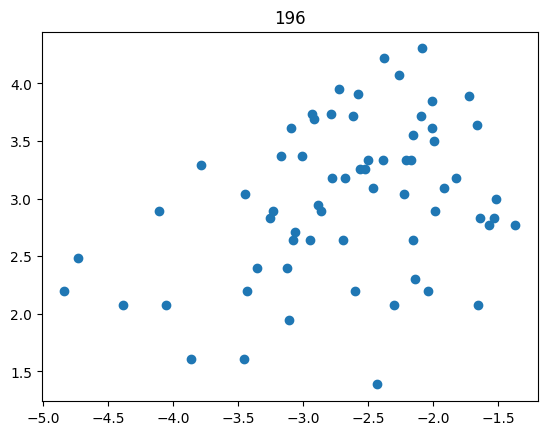

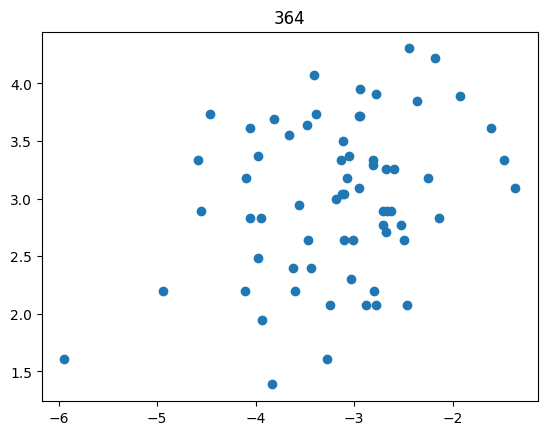

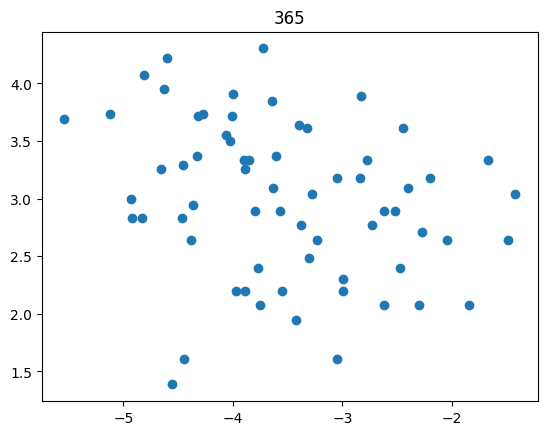

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 19


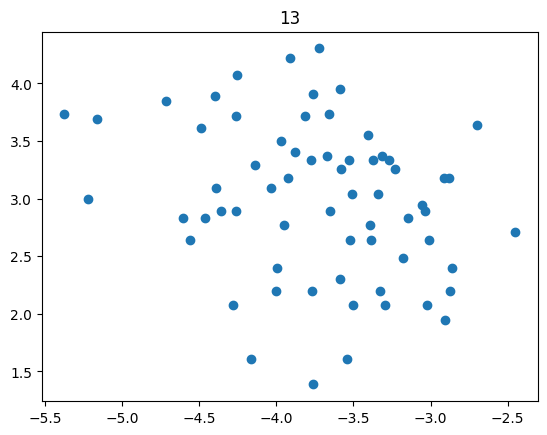

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


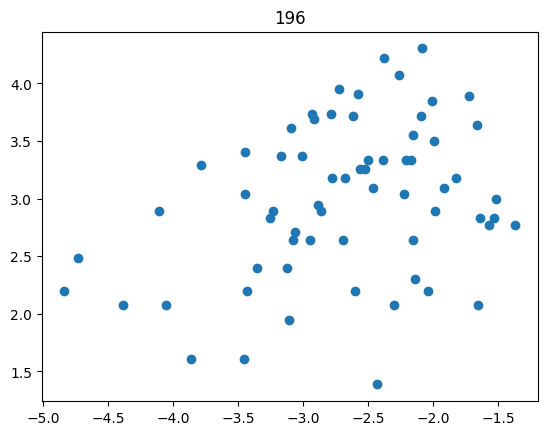

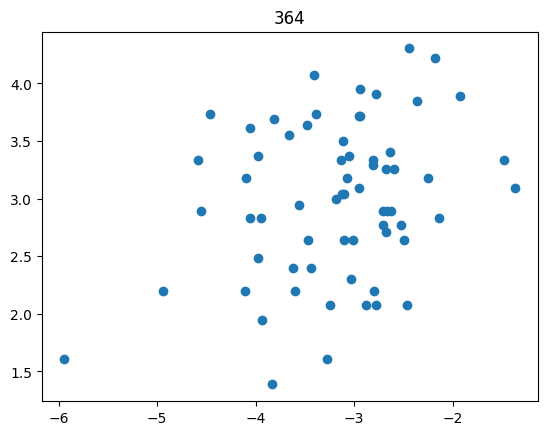

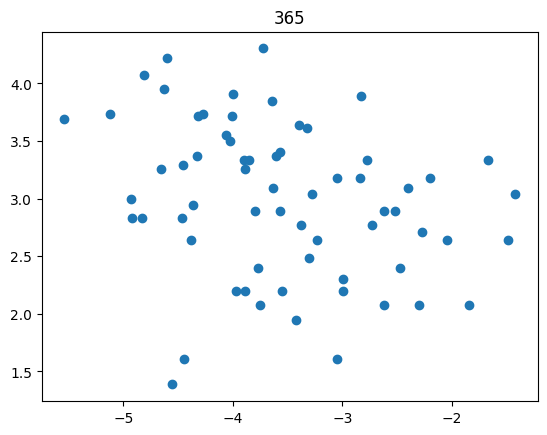

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 20


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

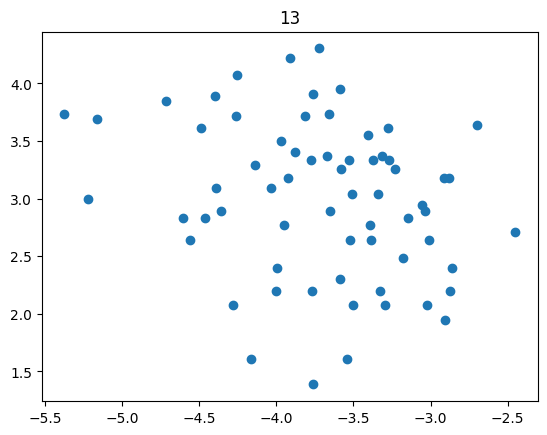

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


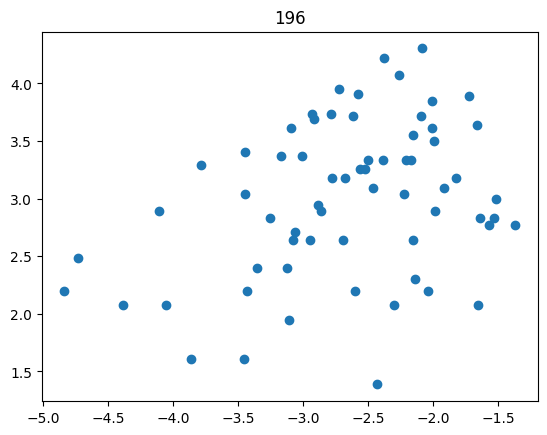

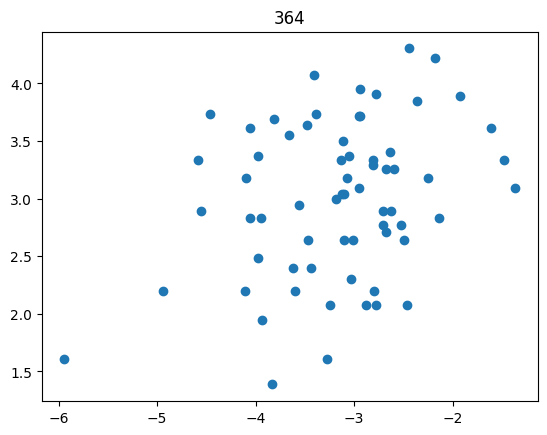

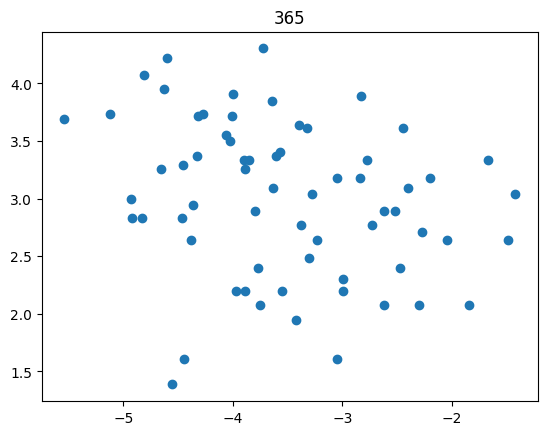

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 21


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

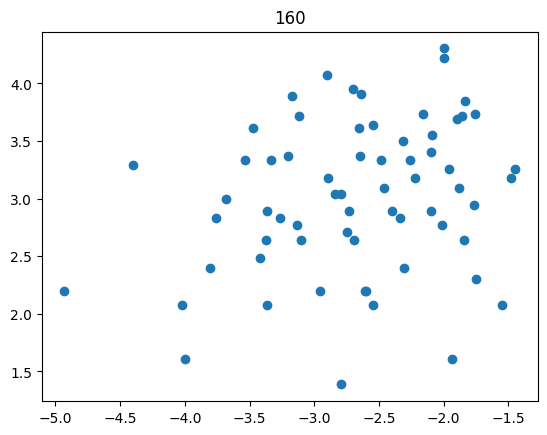

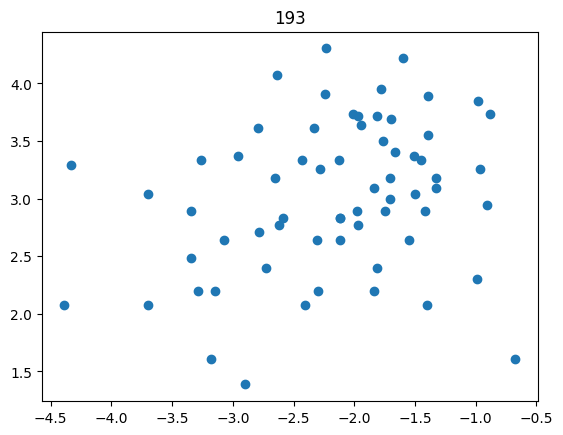

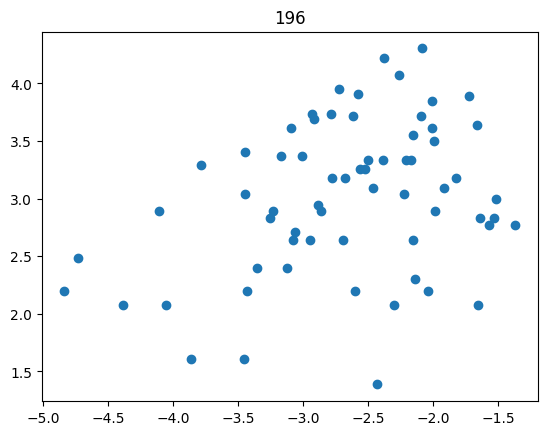

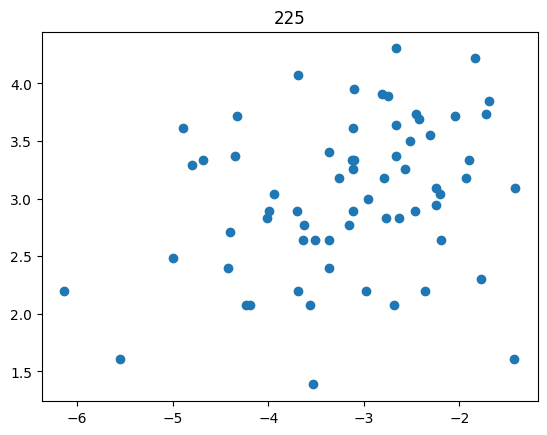

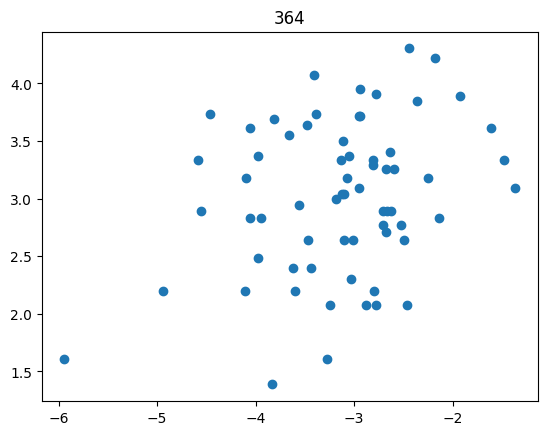

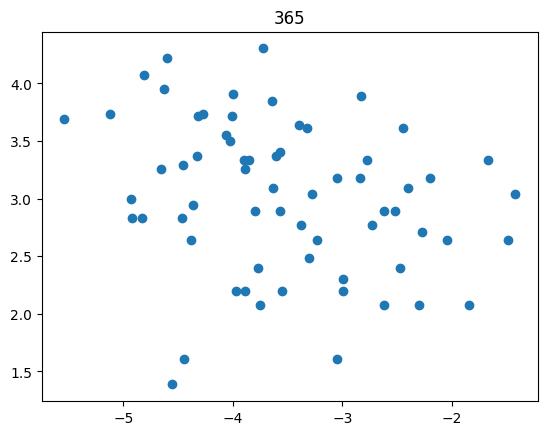

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 22


/home/ines/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4891: RuntimeWarning: invalid value encountered in subtract
  xm = x - xmean


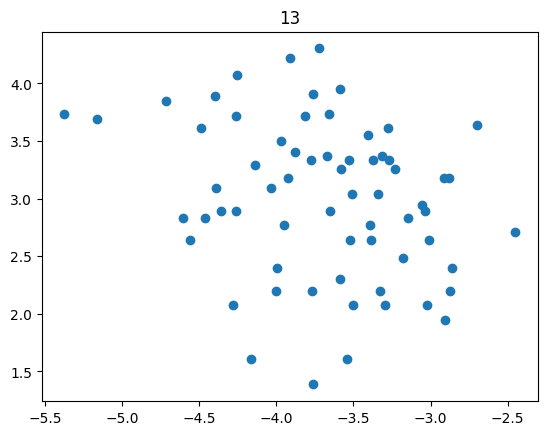

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


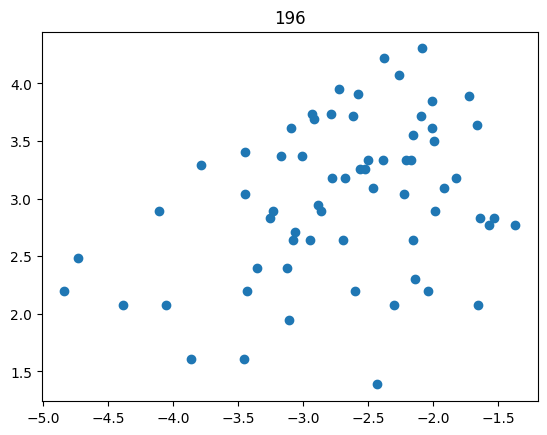

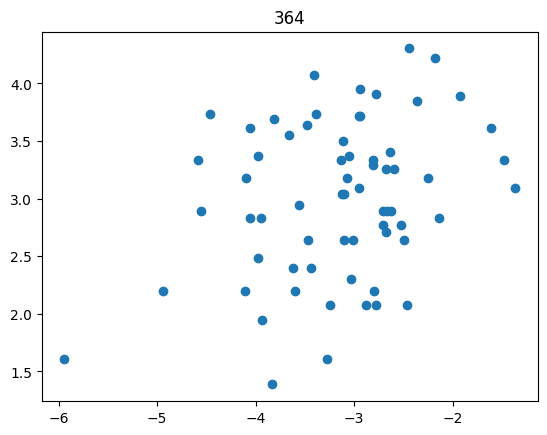

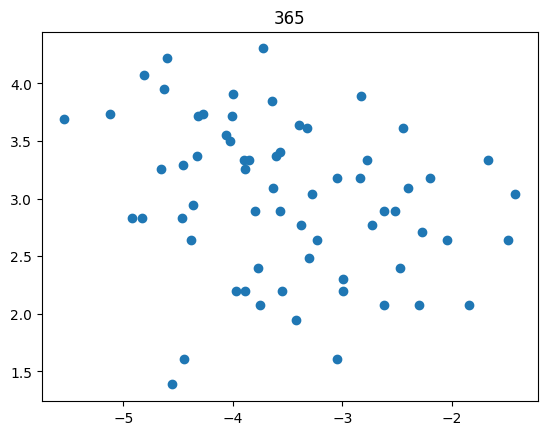

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 23


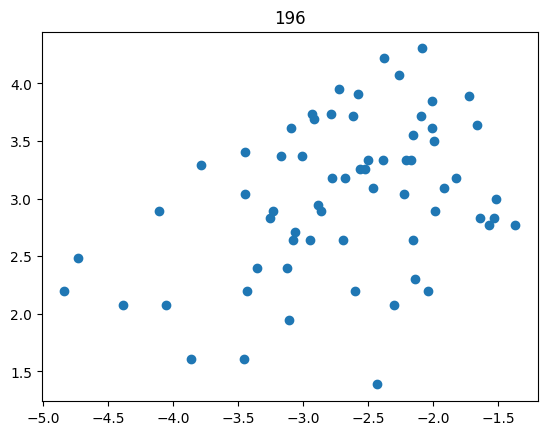

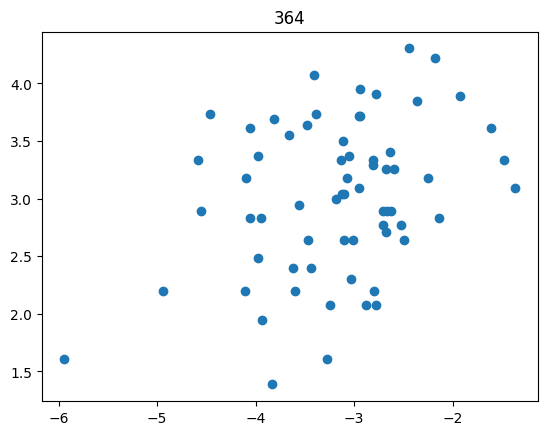

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 24


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

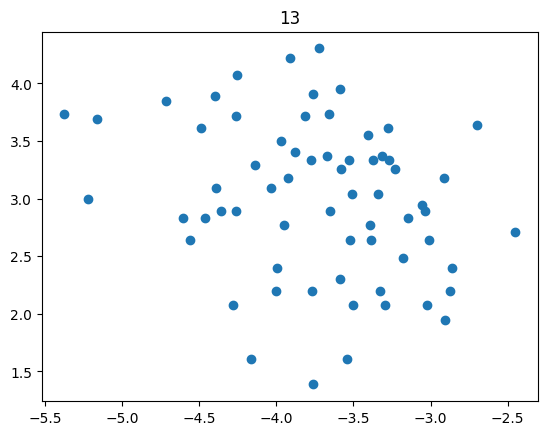

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


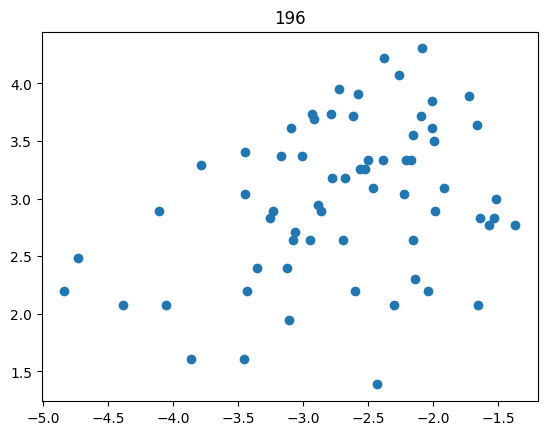

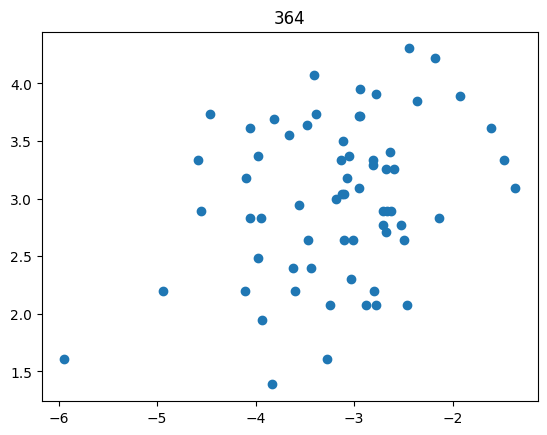

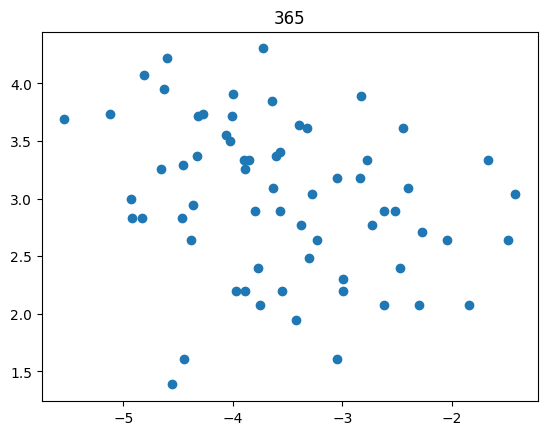

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 25


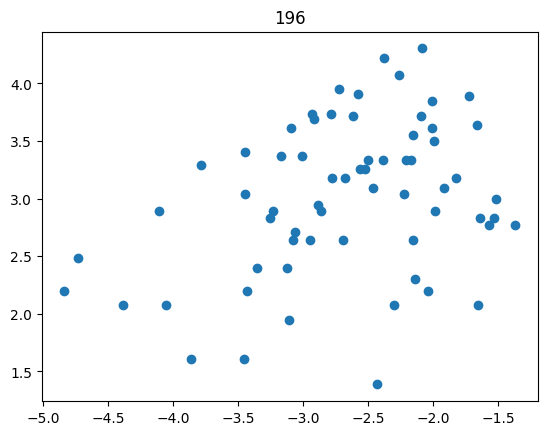

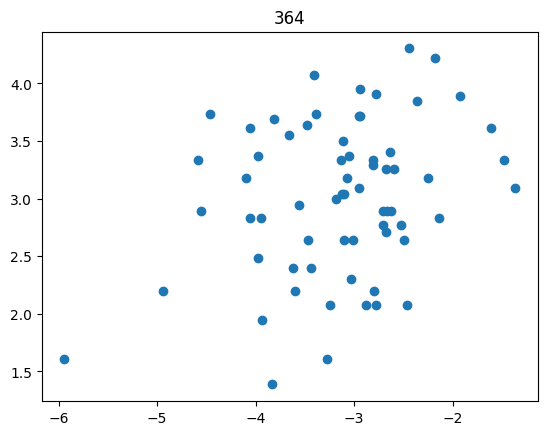

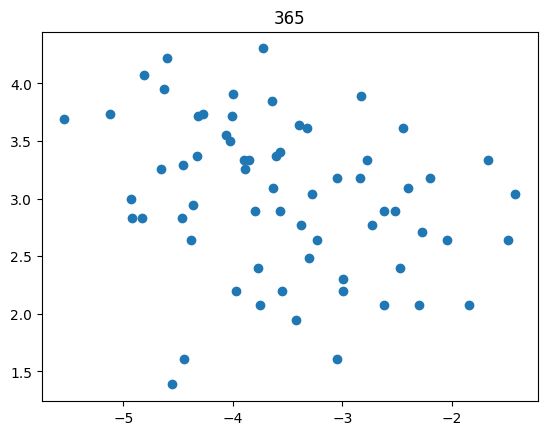

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 26


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


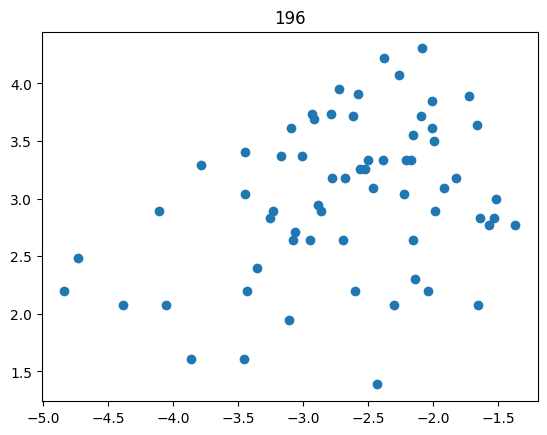

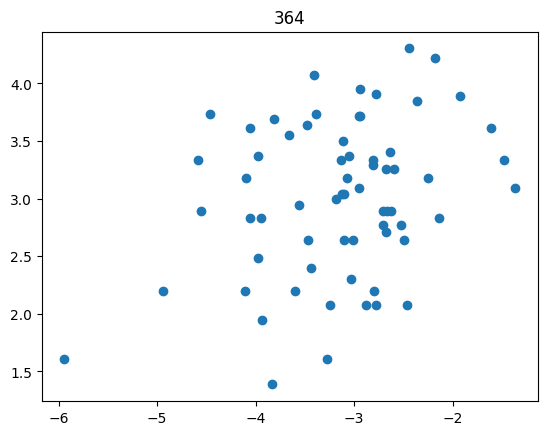

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 27


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

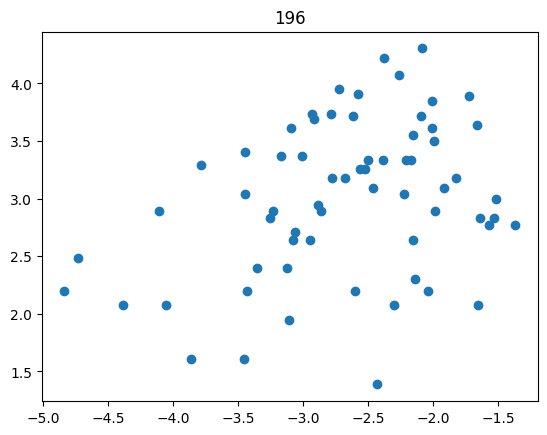

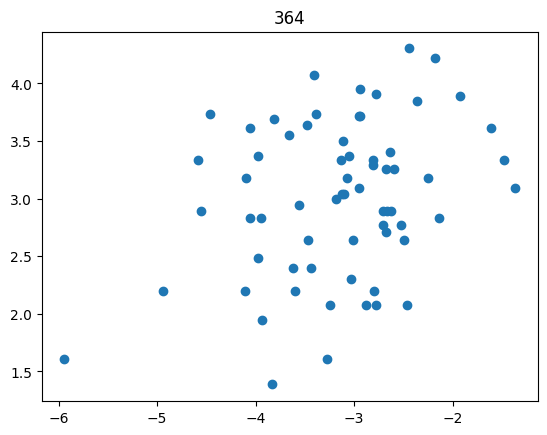

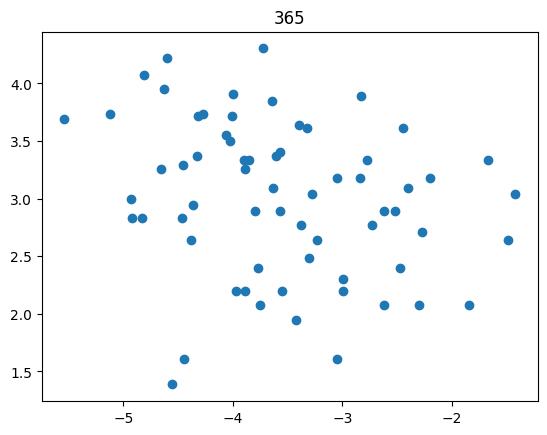

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 28


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

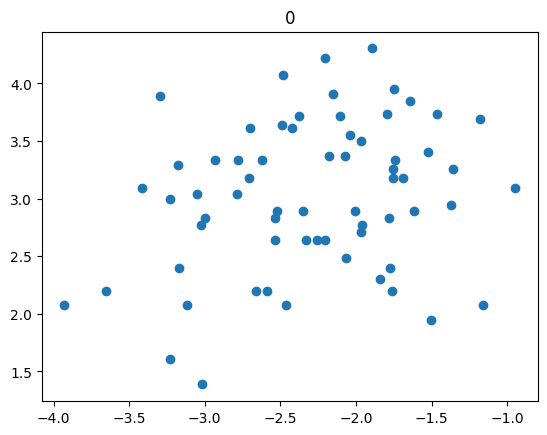

/home/ines/miniconda3/envs/iblenv/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/ines/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4891: RuntimeWarning: invalid value encountered in subtract
  xm = x - xmean


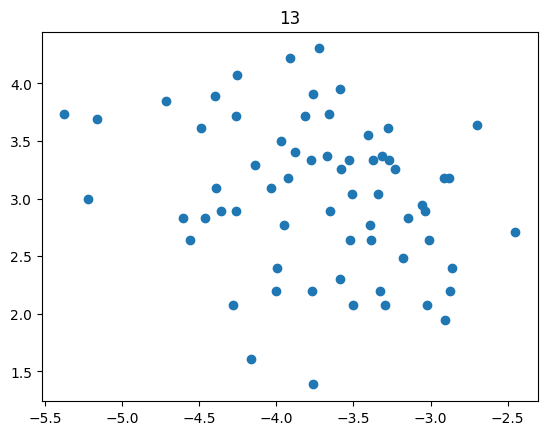

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


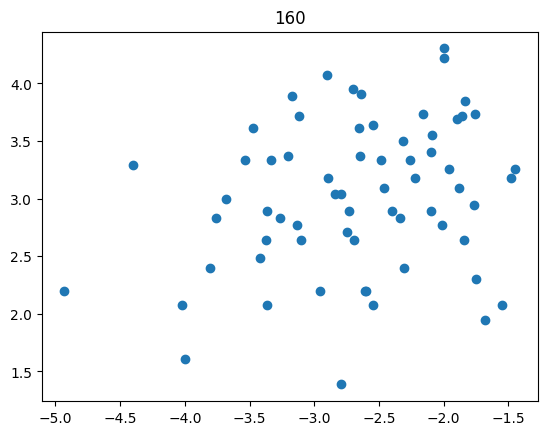

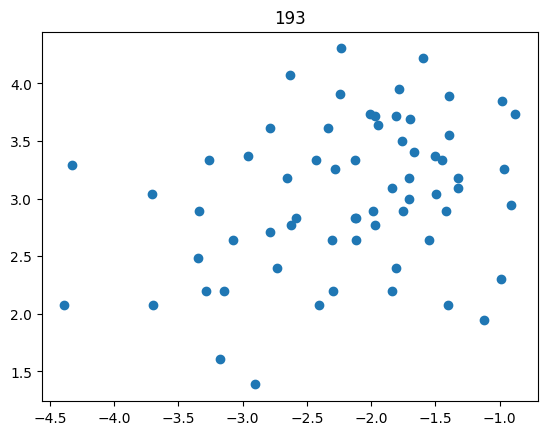

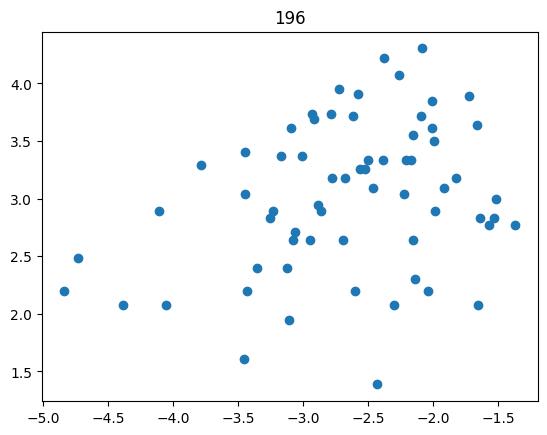

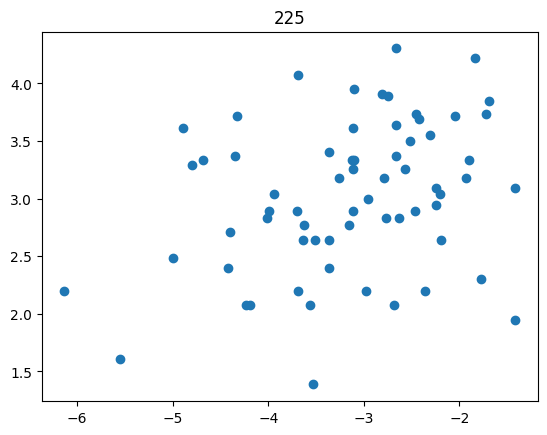

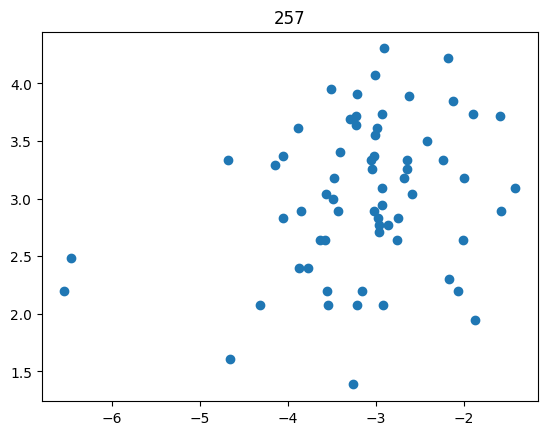

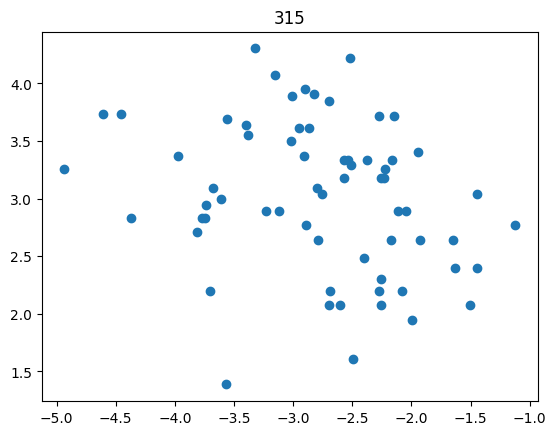

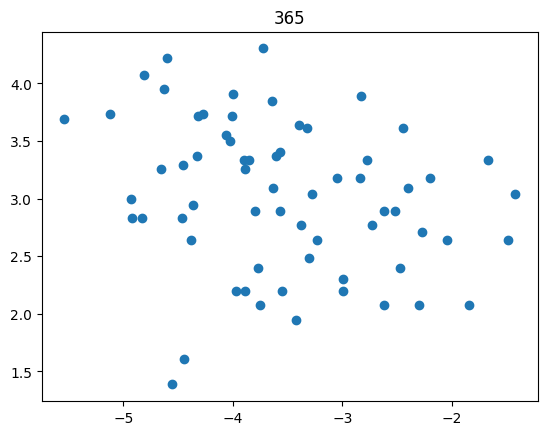

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 29


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

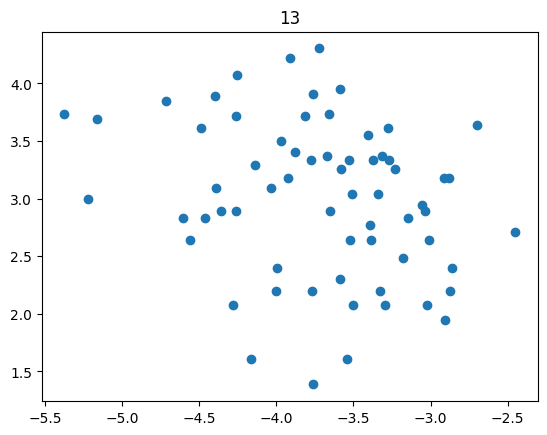

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


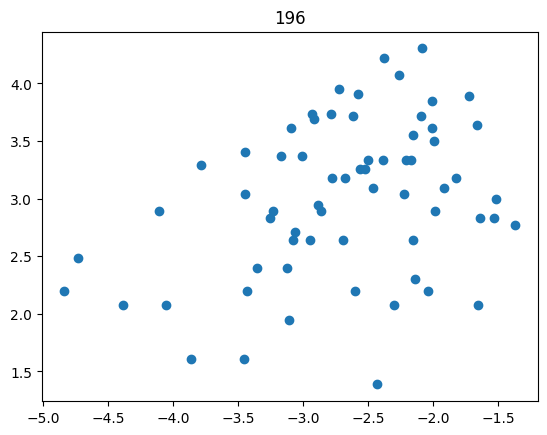

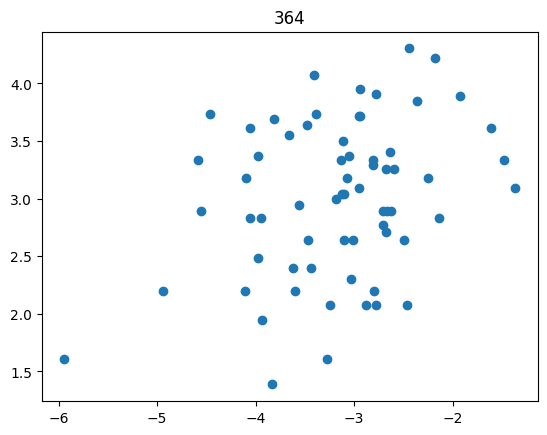

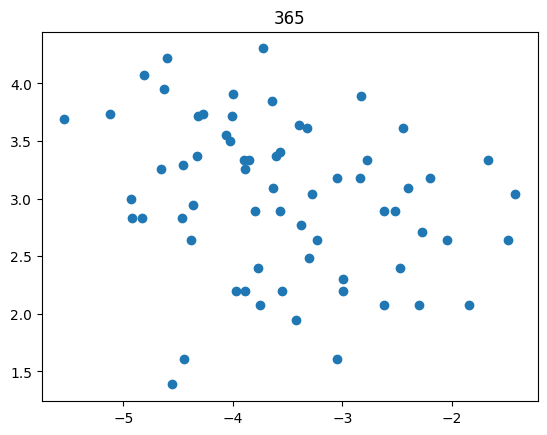

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 30


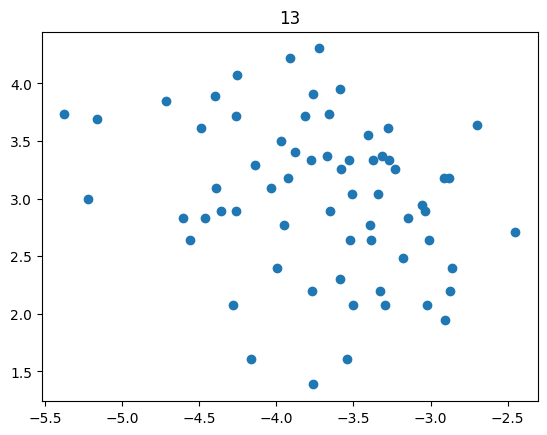

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


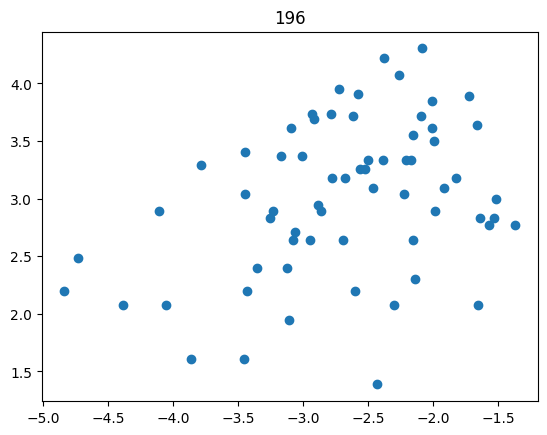

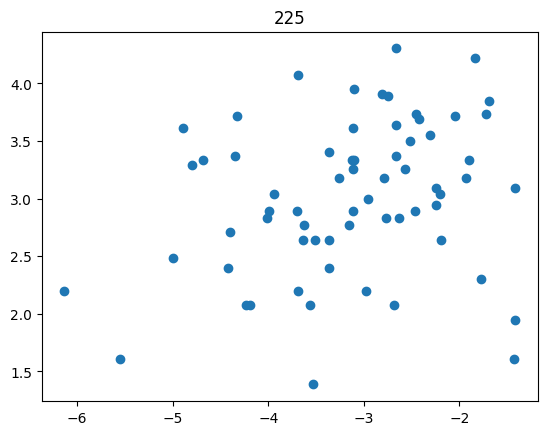

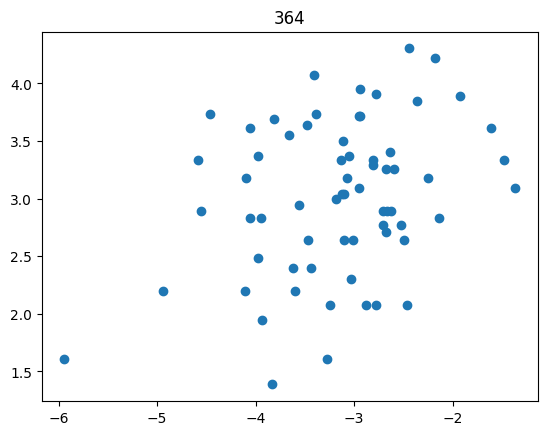

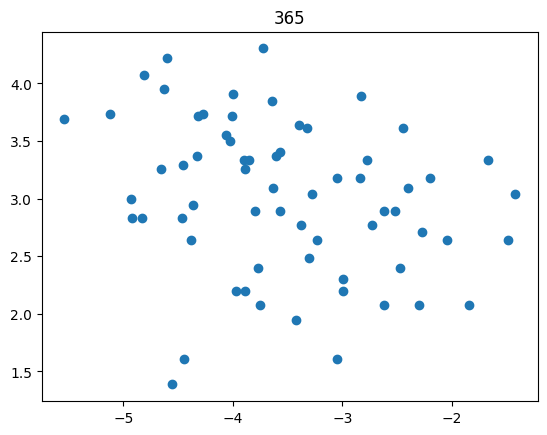

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 31


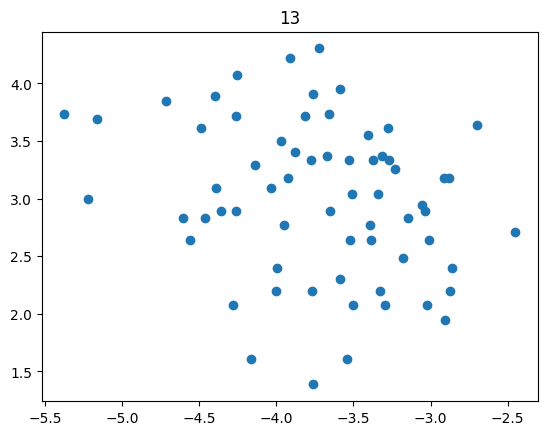

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


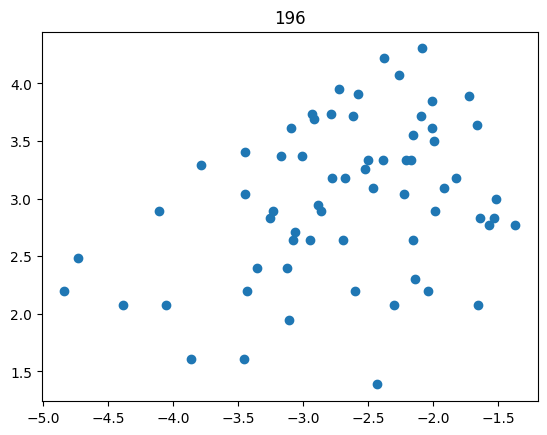

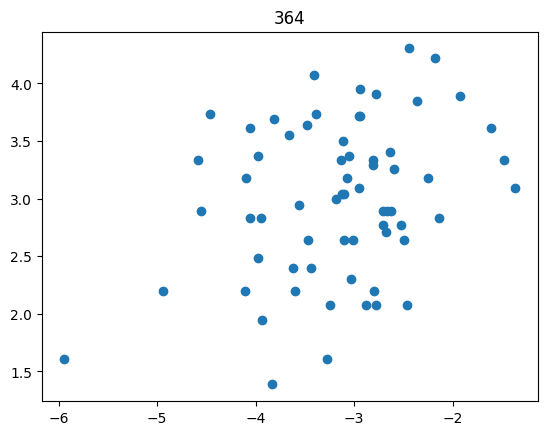

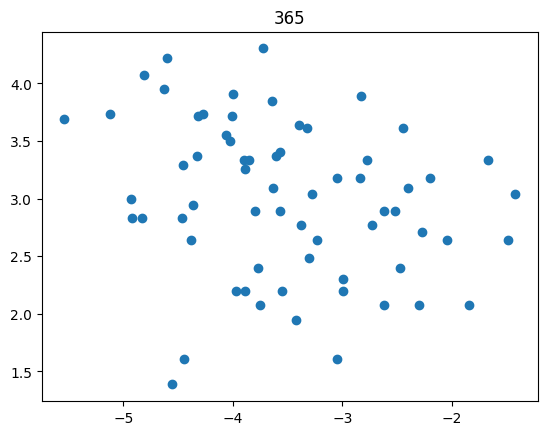

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 32


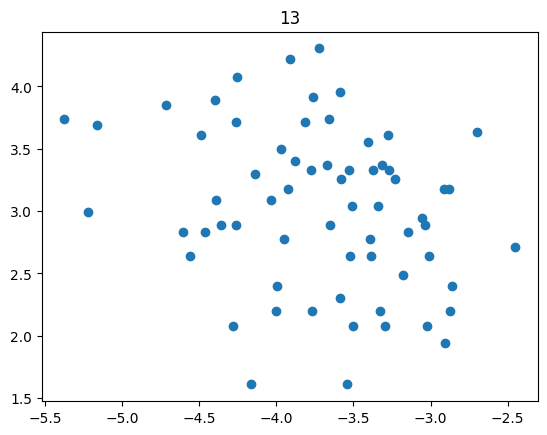

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


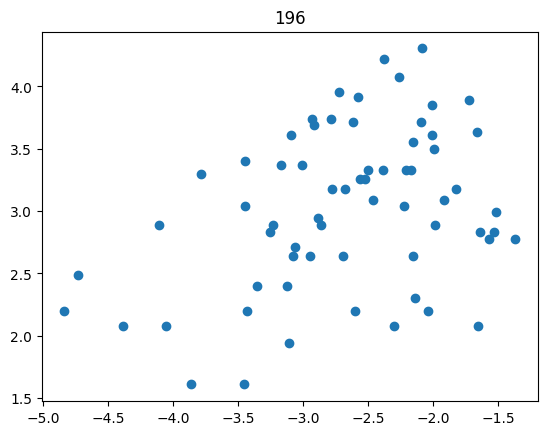

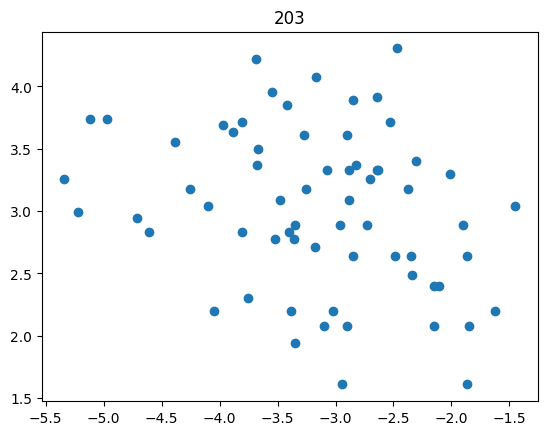

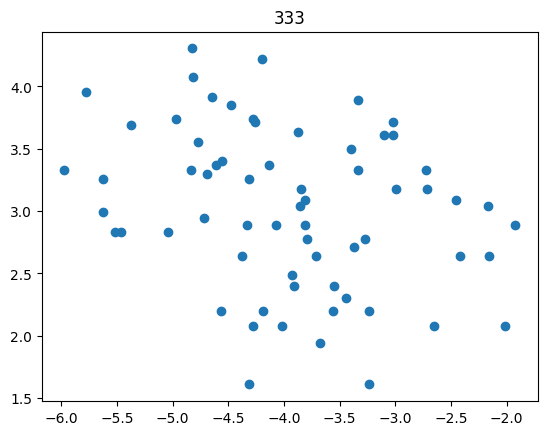

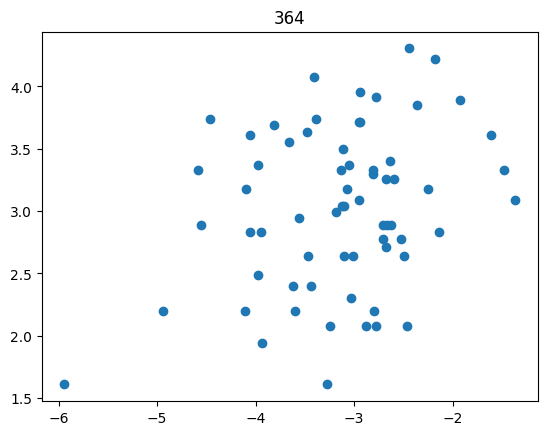

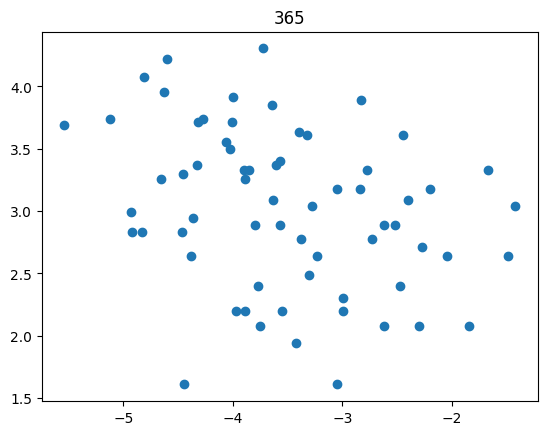

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 33


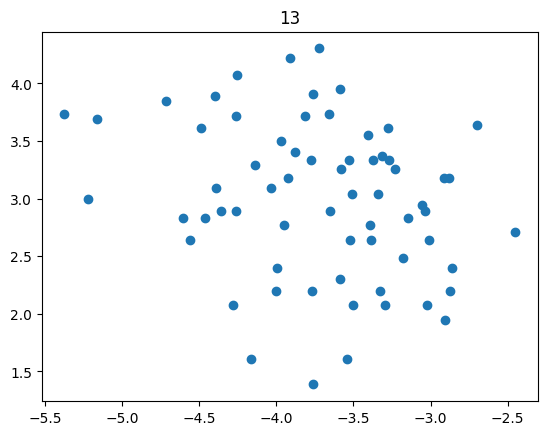

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


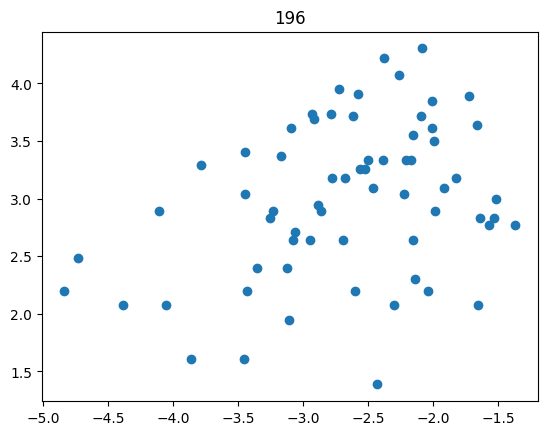

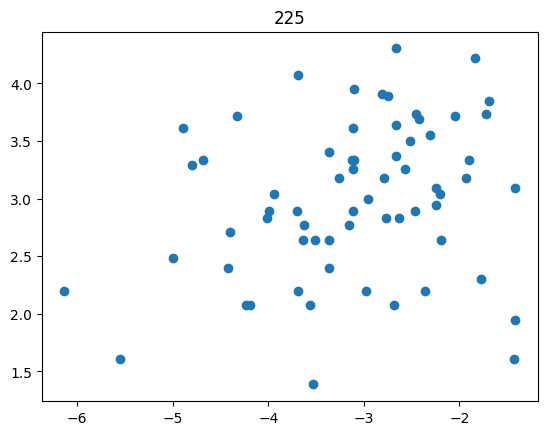

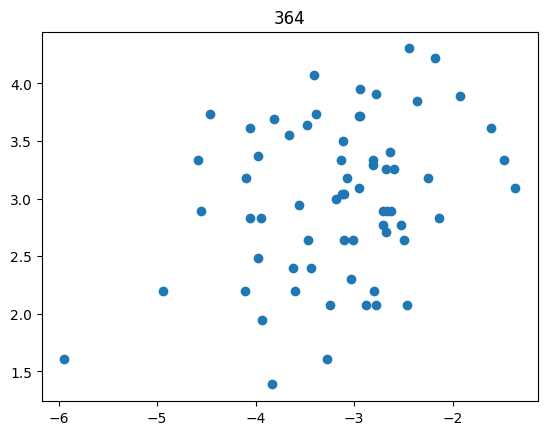

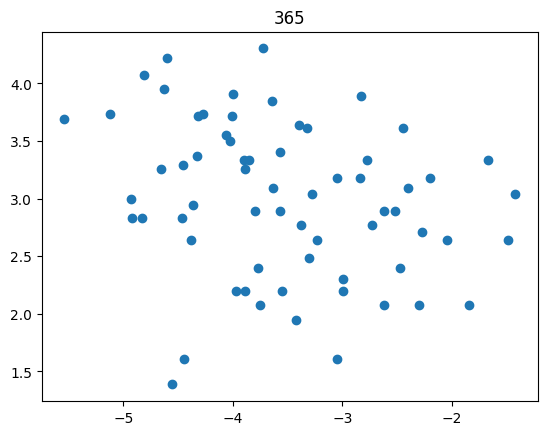

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 34


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

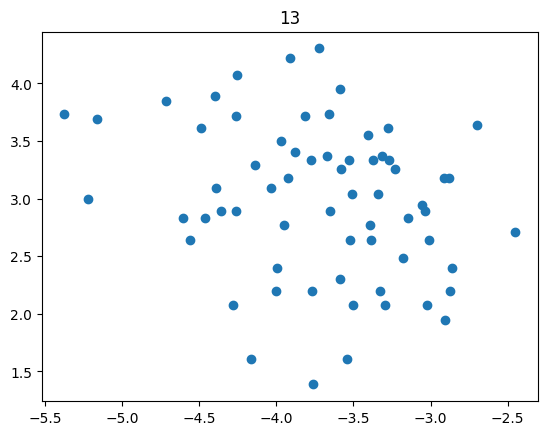

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


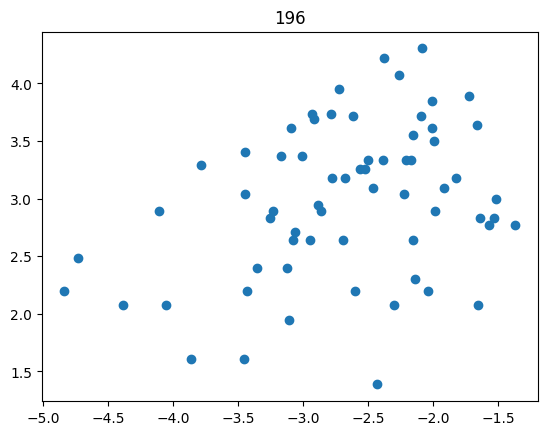

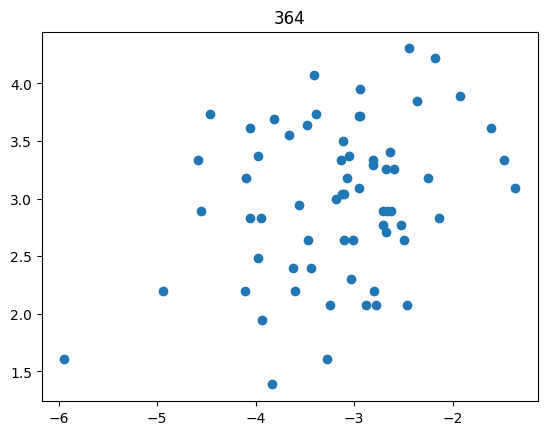

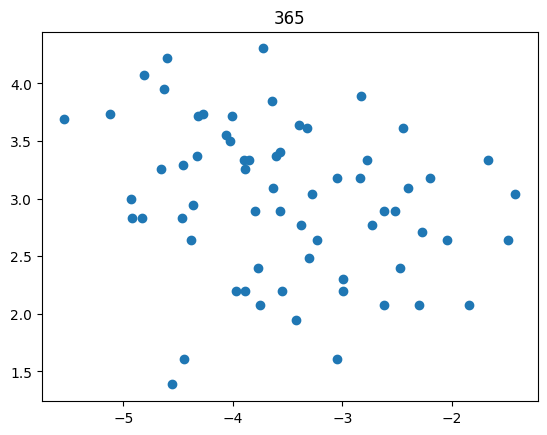

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 35


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

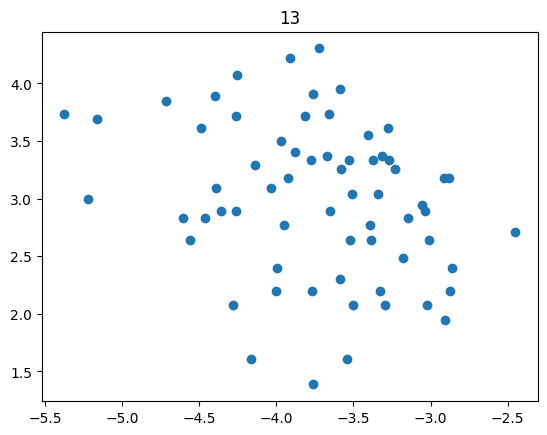

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


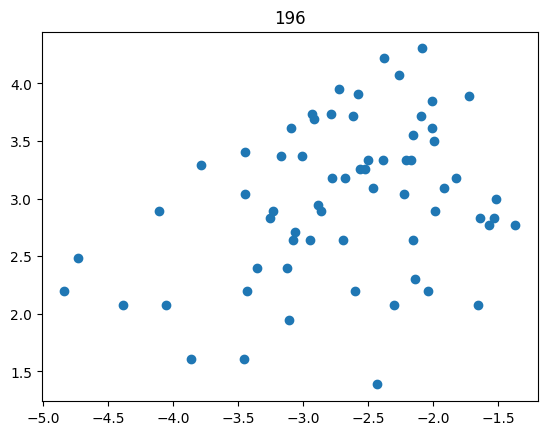

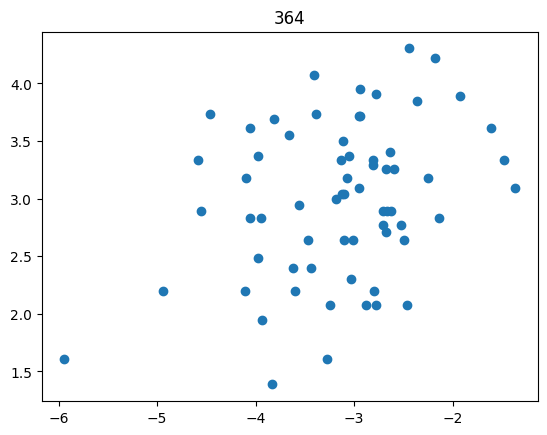

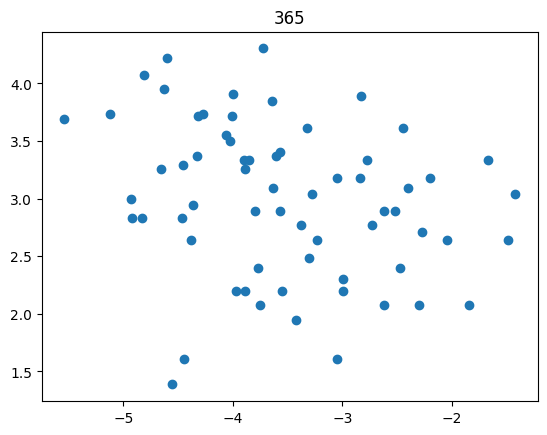

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 36


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


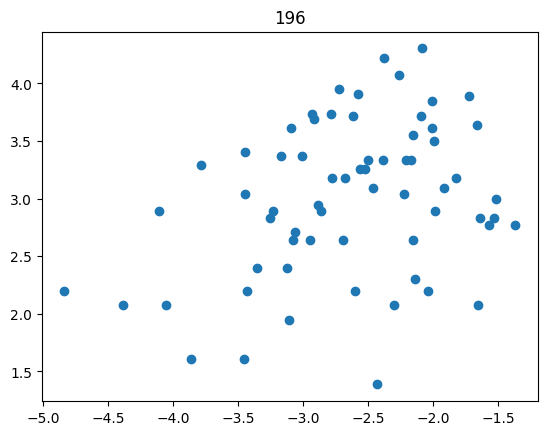

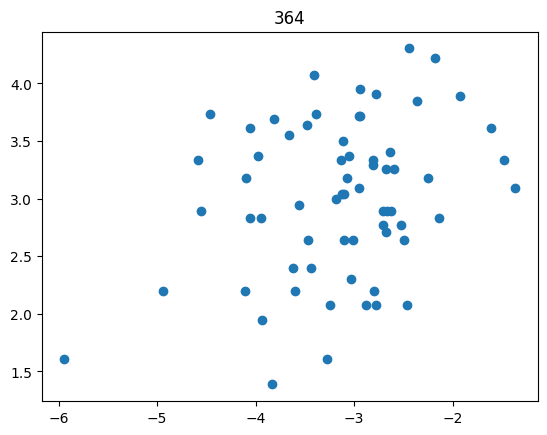

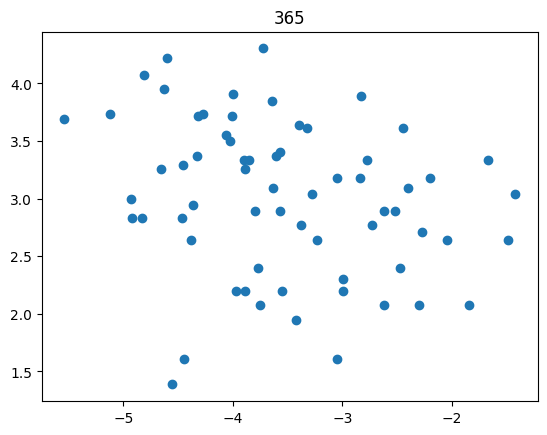

Processing mouse 37


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

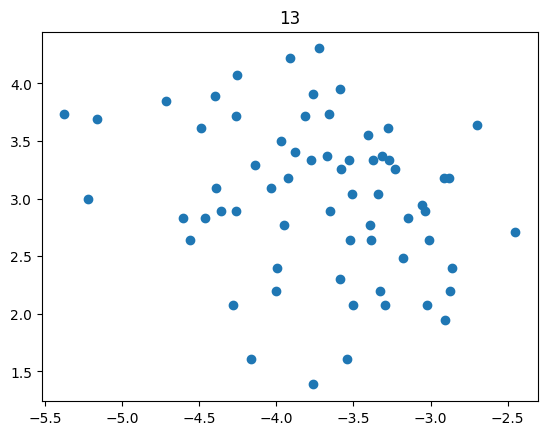

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


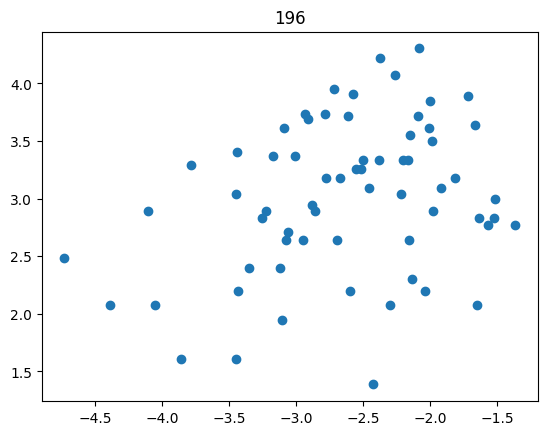

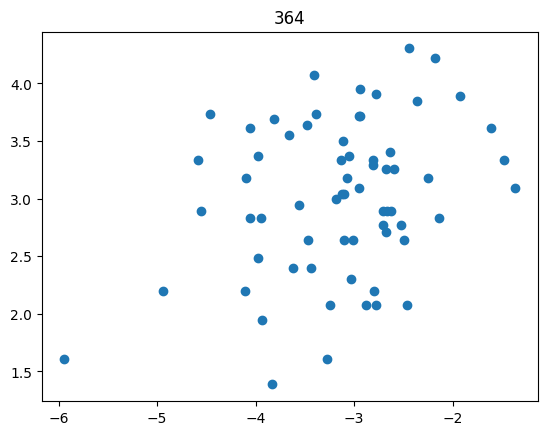

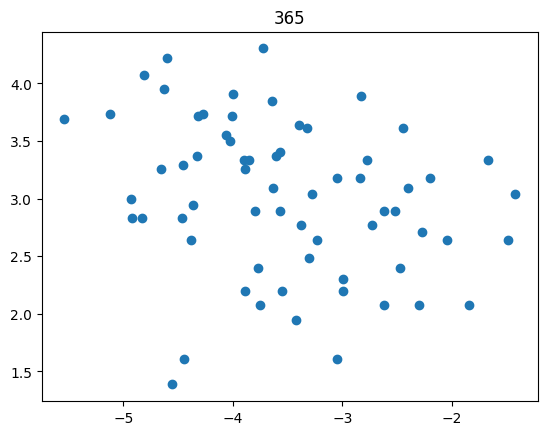

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 38


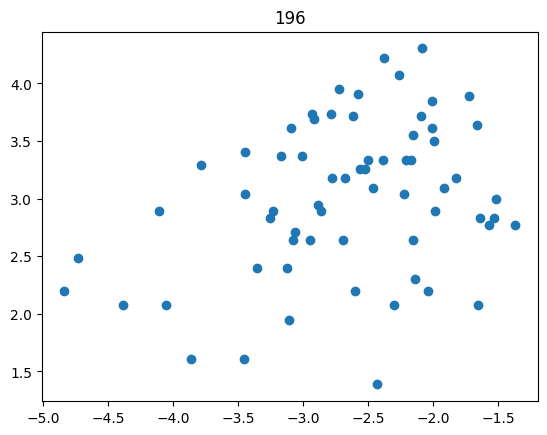

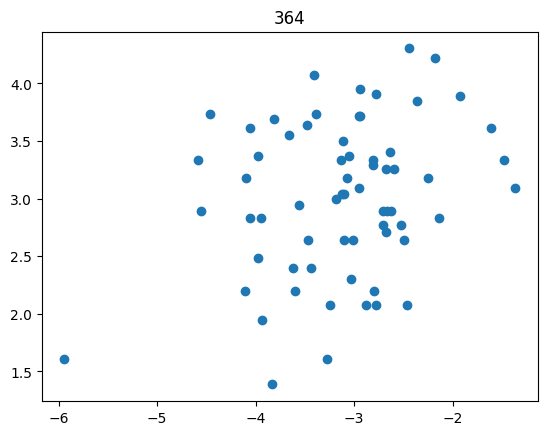

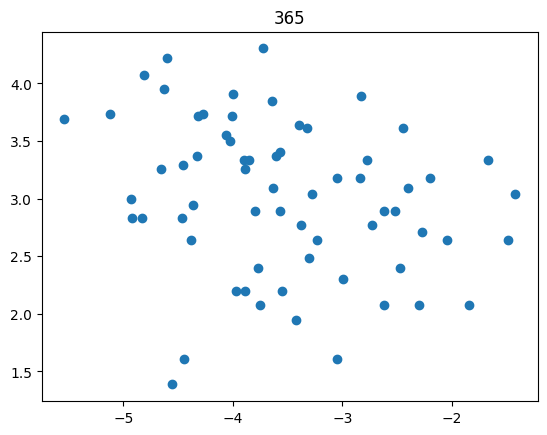

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 39


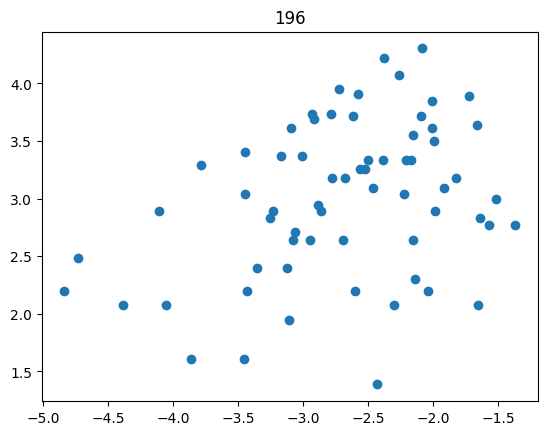

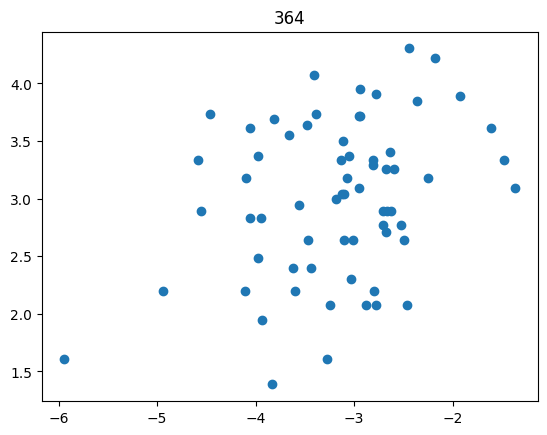

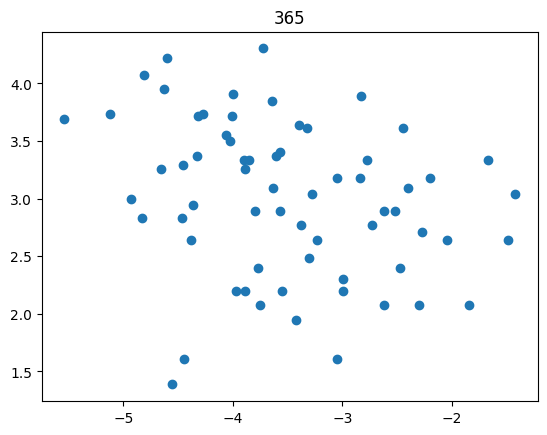

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 40


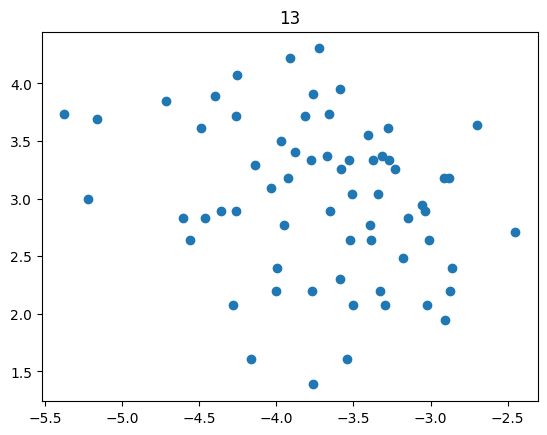

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


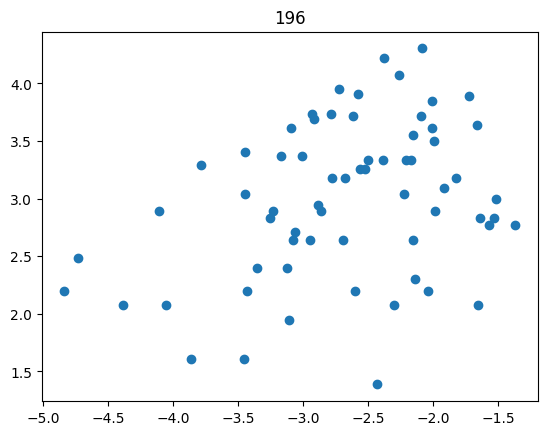

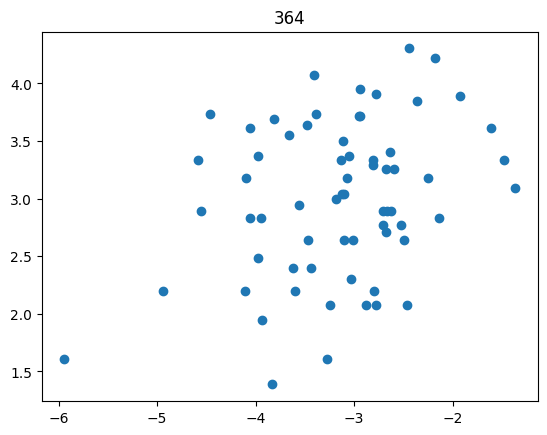

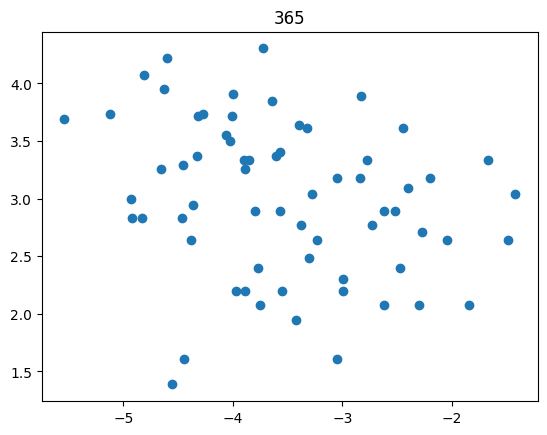

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 41


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


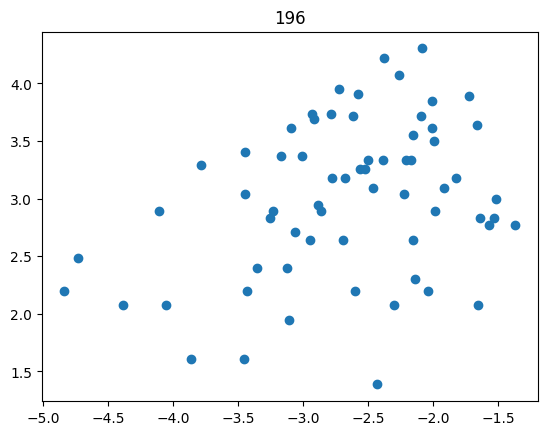

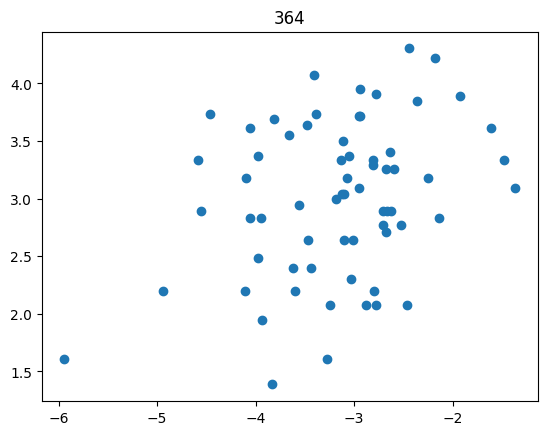

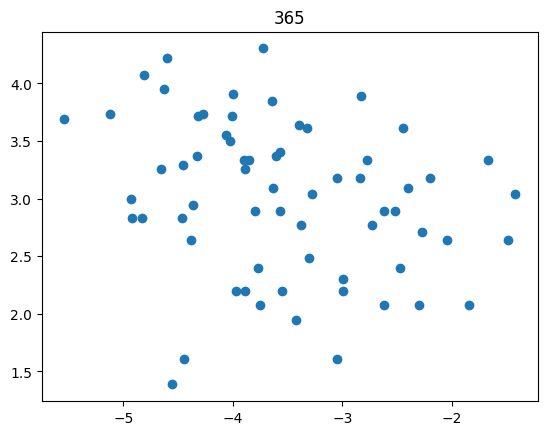

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 42


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

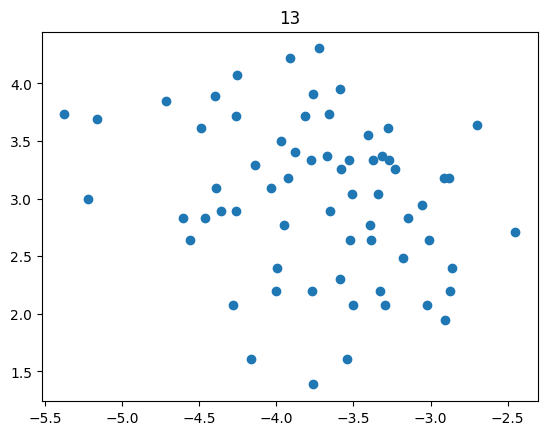

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


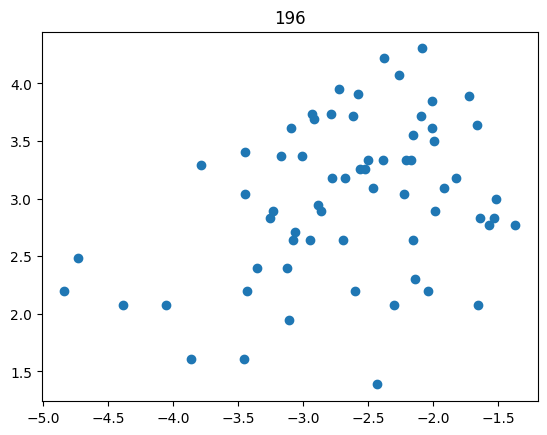

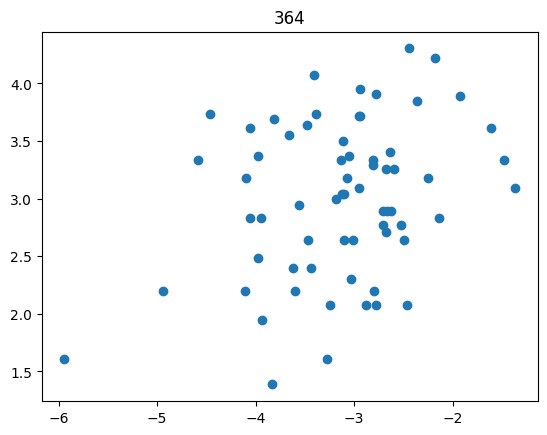

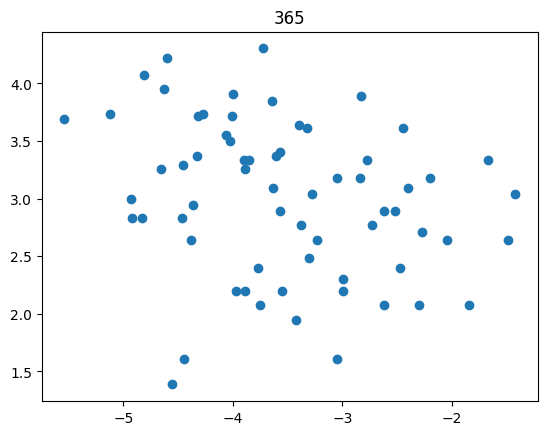

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 43


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

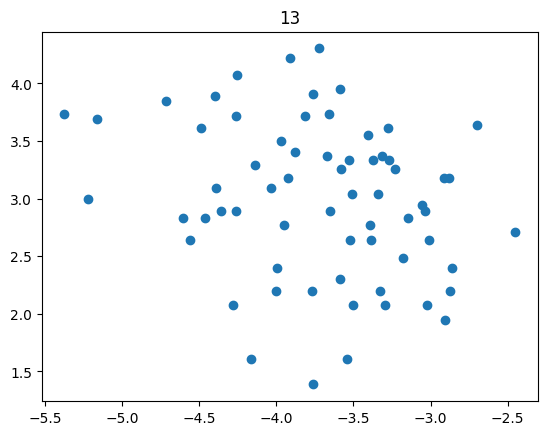

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


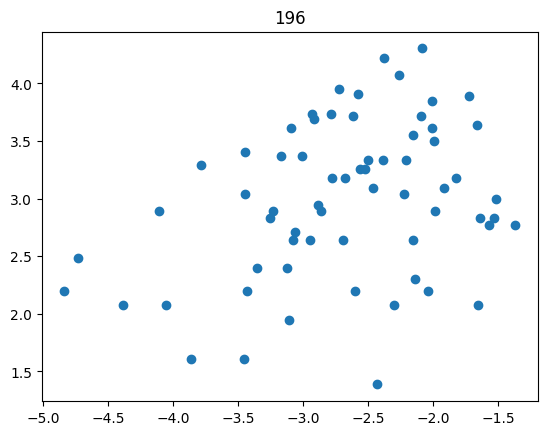

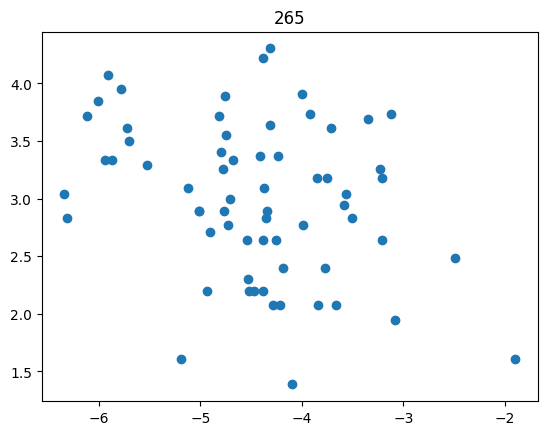

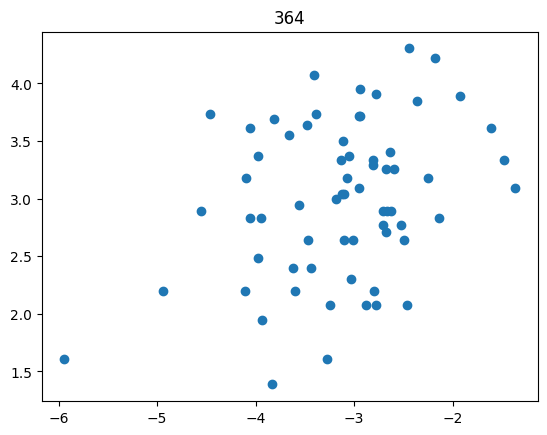

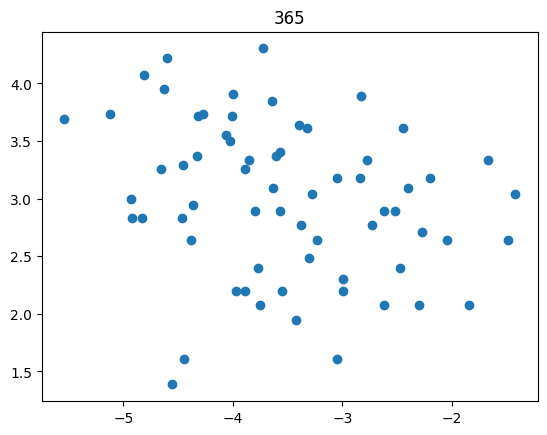

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 44


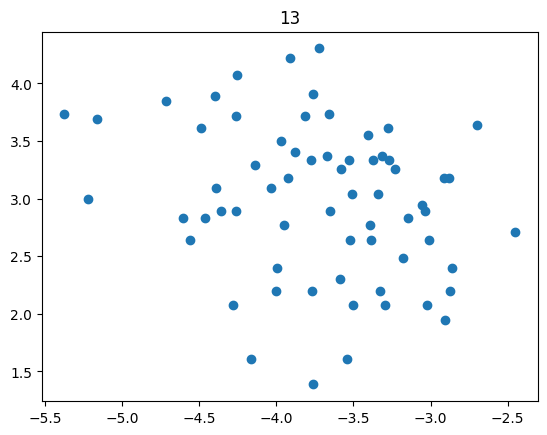

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


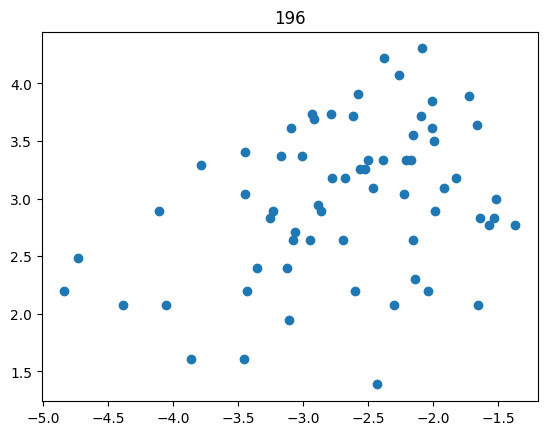

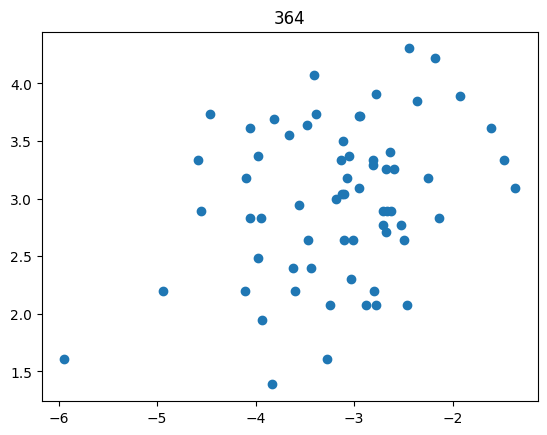

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 45


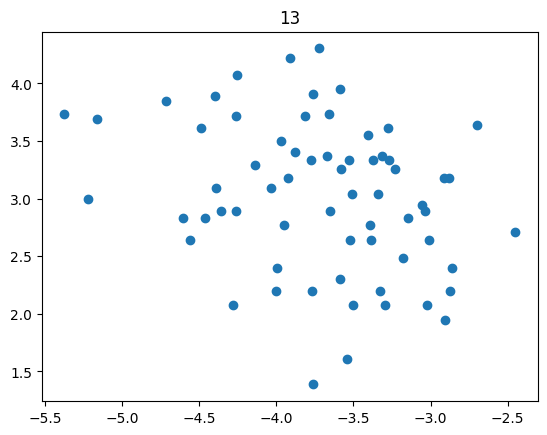

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


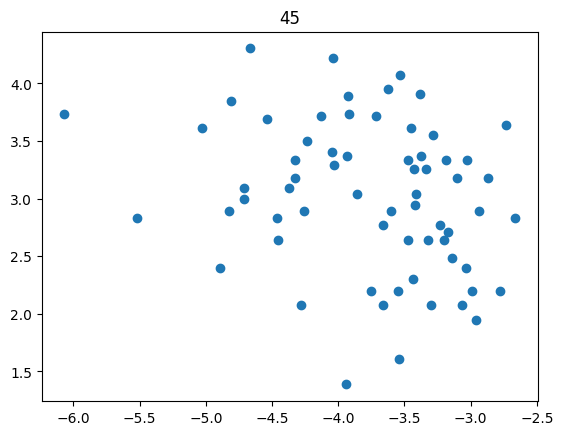

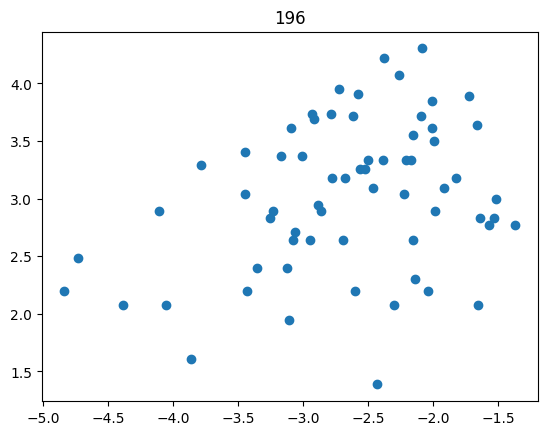

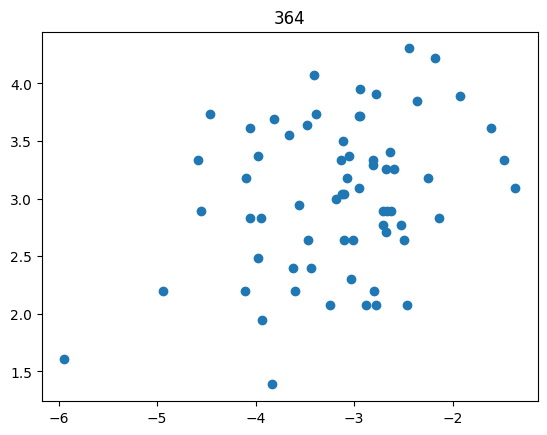

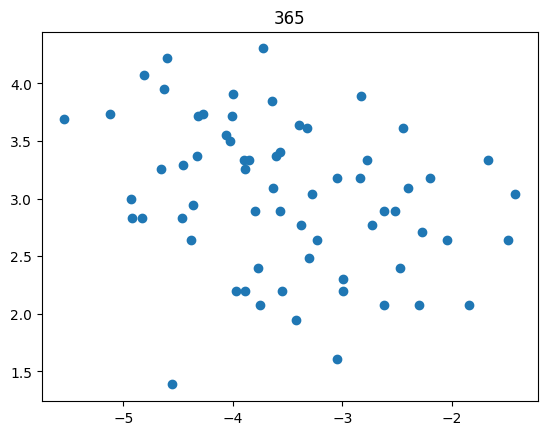

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 46


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

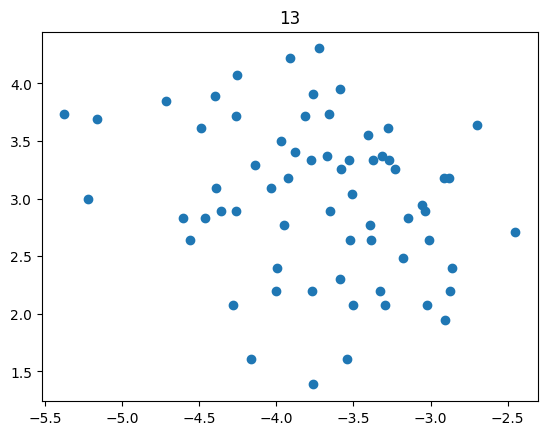

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


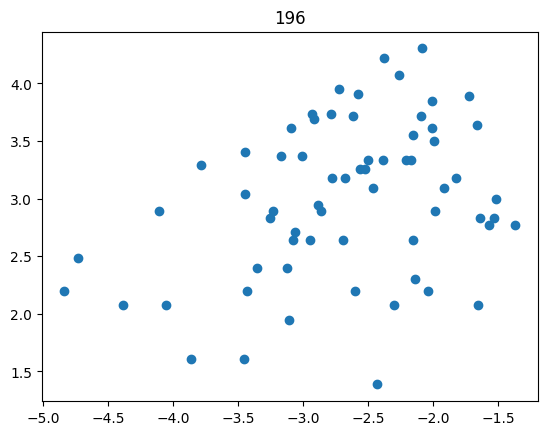

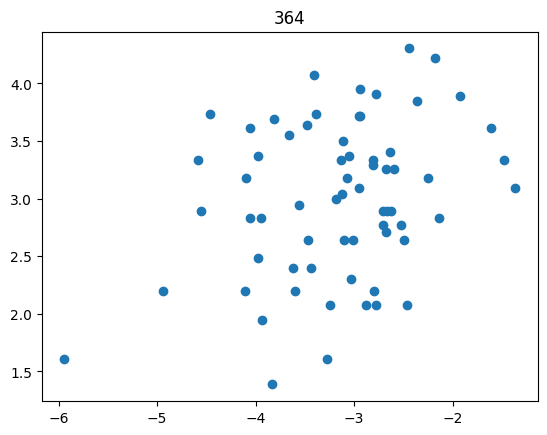

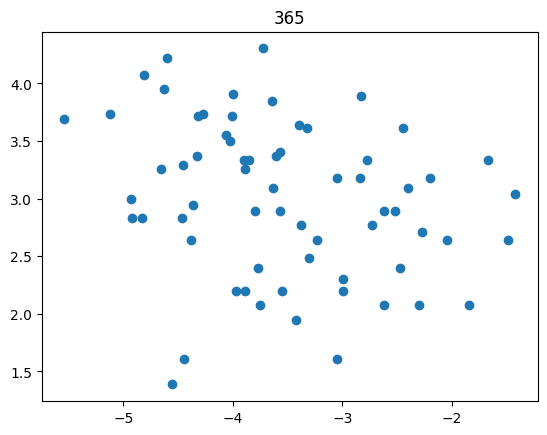

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 47


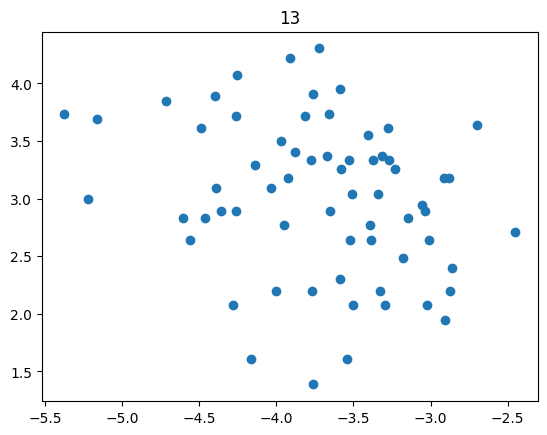

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


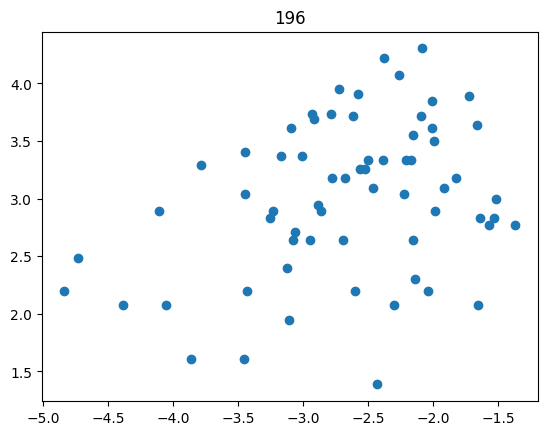

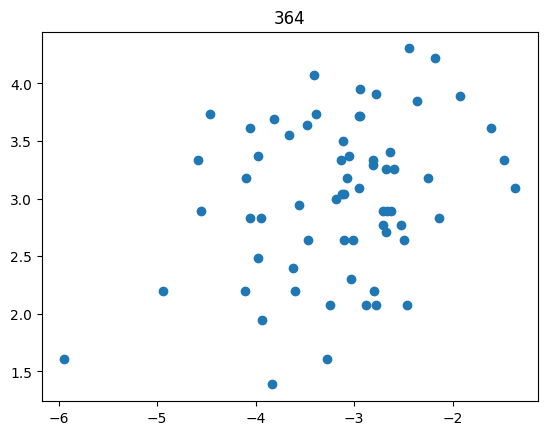

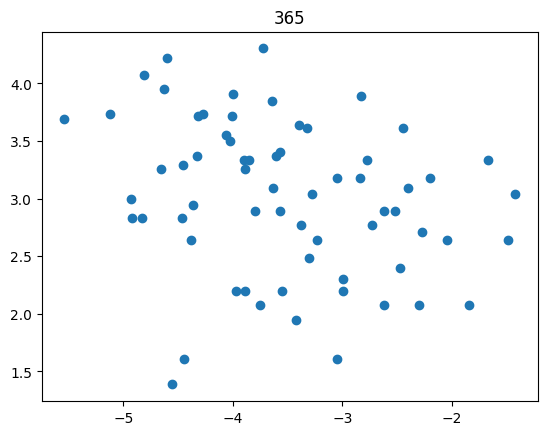

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 48


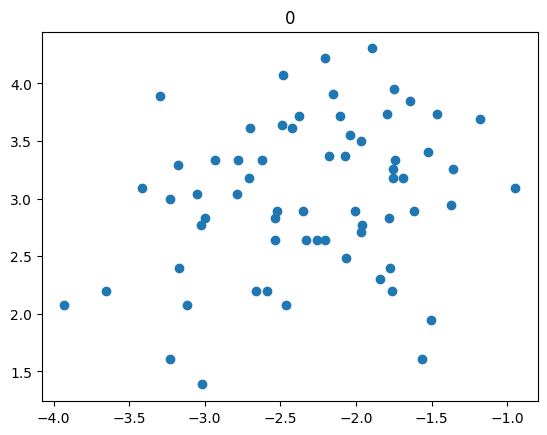

/home/ines/miniconda3/envs/iblenv/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/ines/.local/lib/python3.10/site-packages/scipy/stats/_stats_py.py:4891: RuntimeWarning: invalid value encountered in subtract
  xm = x - xmean
/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


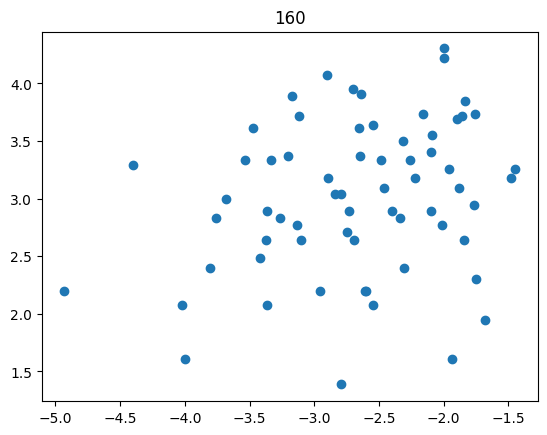

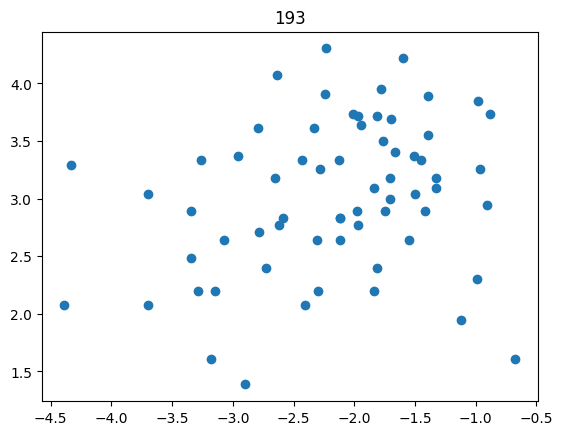

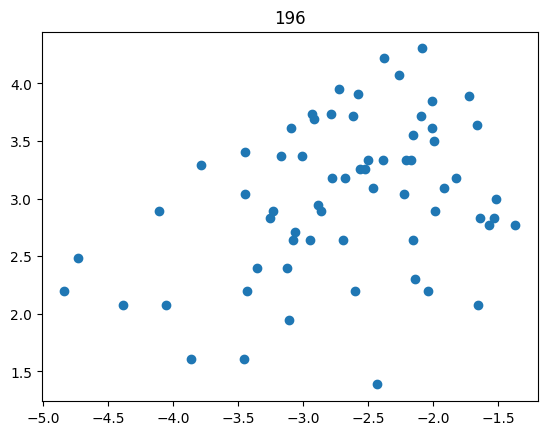

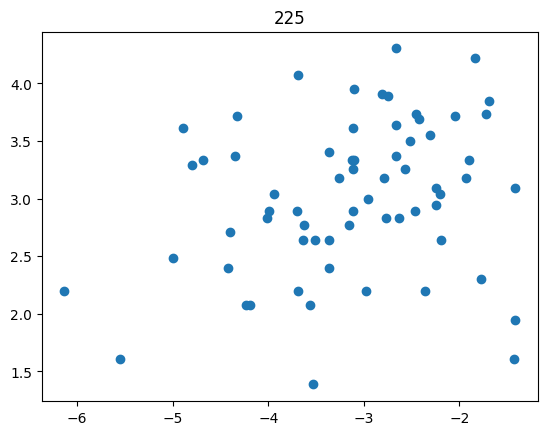

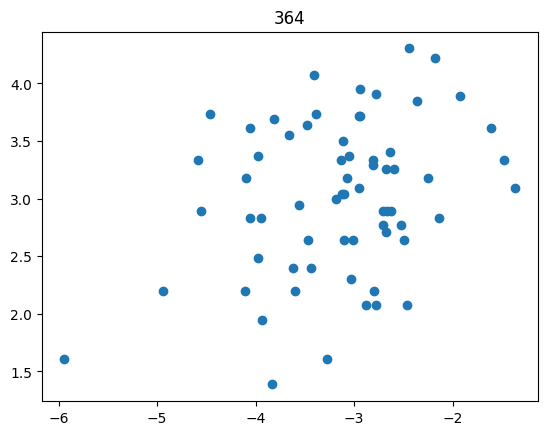

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 49


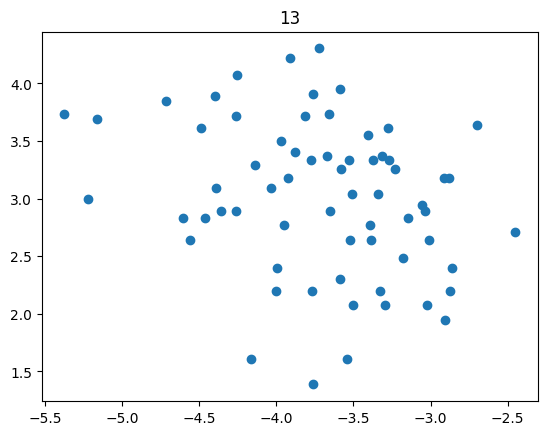

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


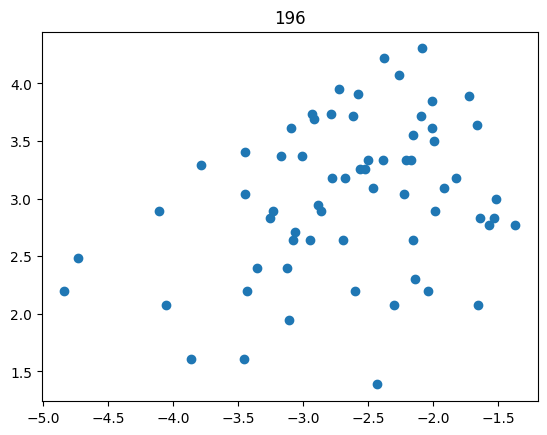

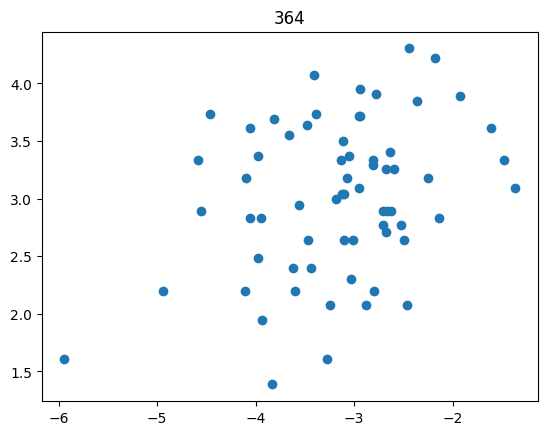

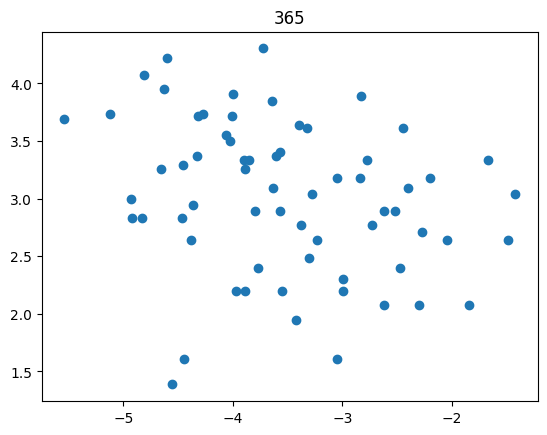

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 50


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

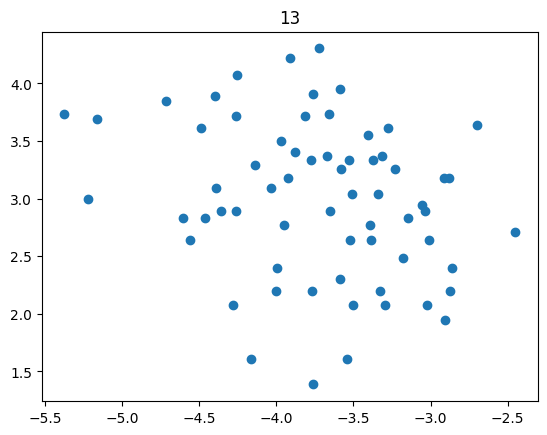

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


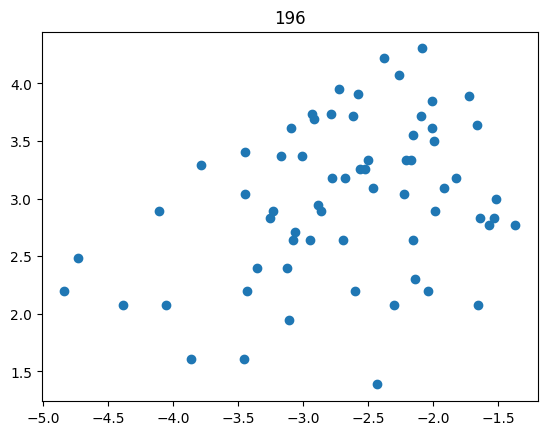

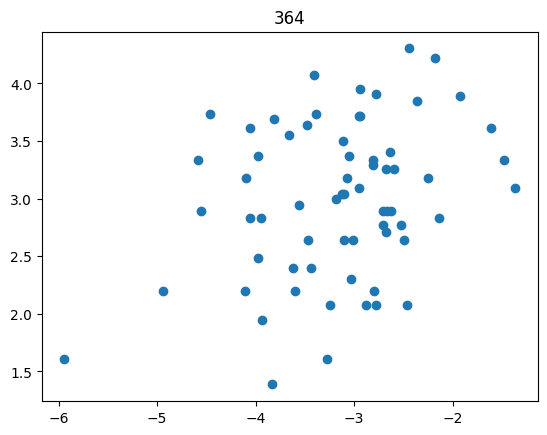

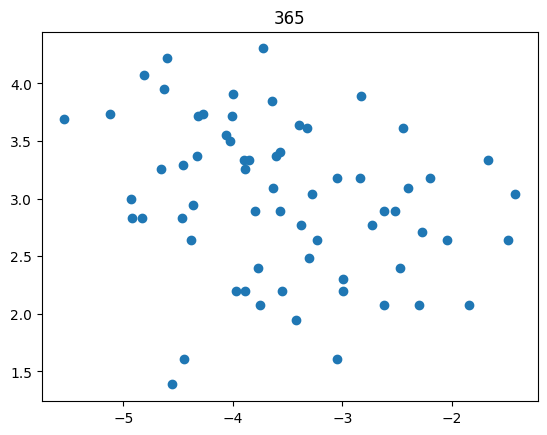

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 51


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

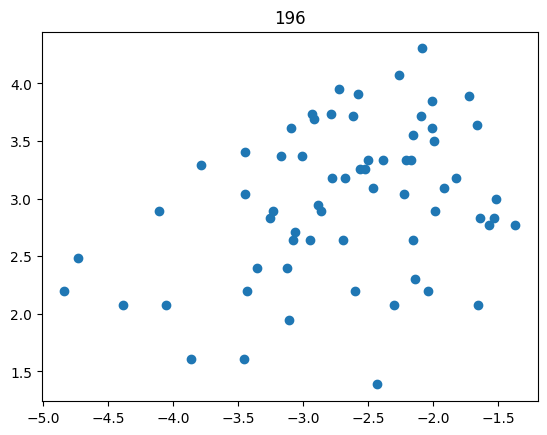

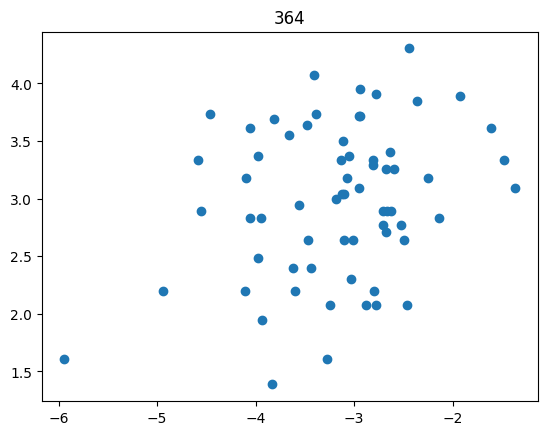

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 52


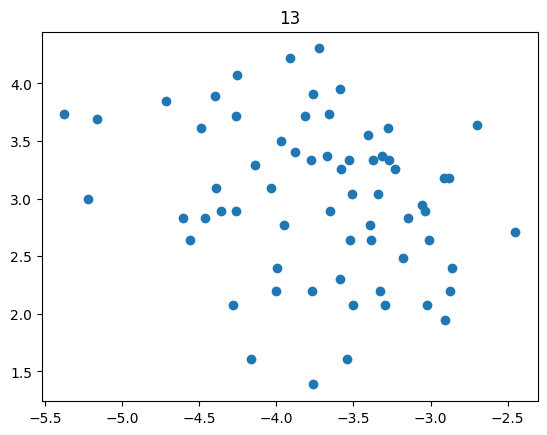

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


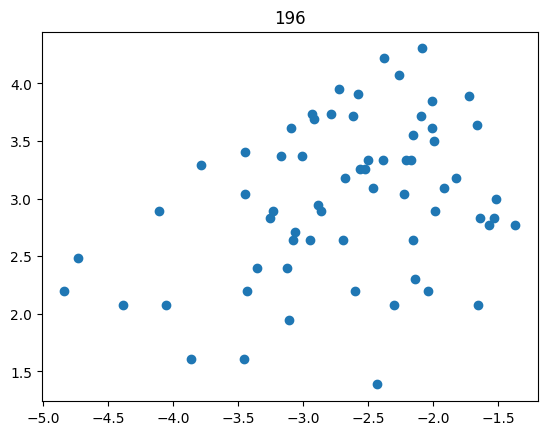

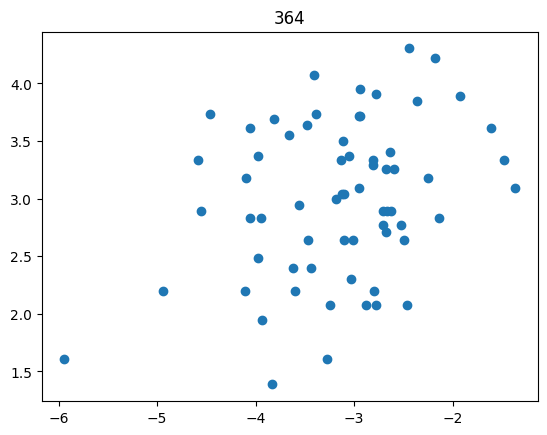

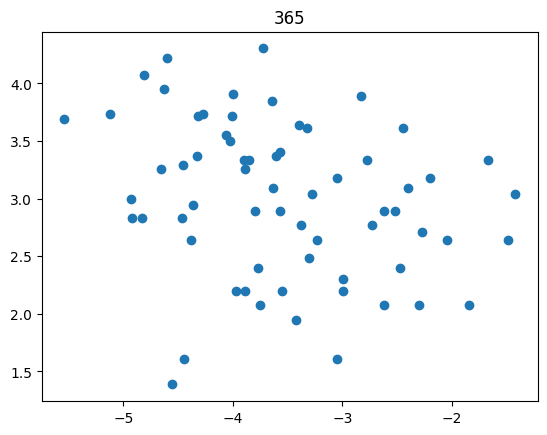

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 53


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

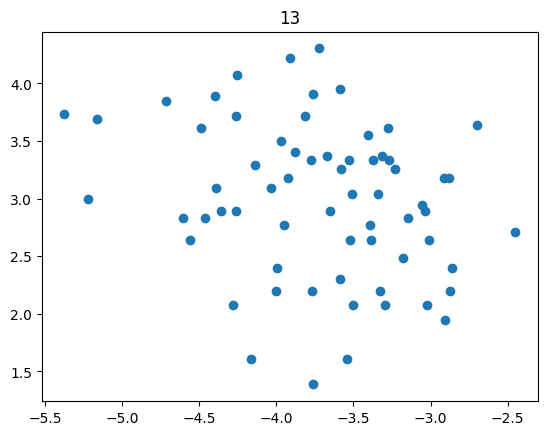

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


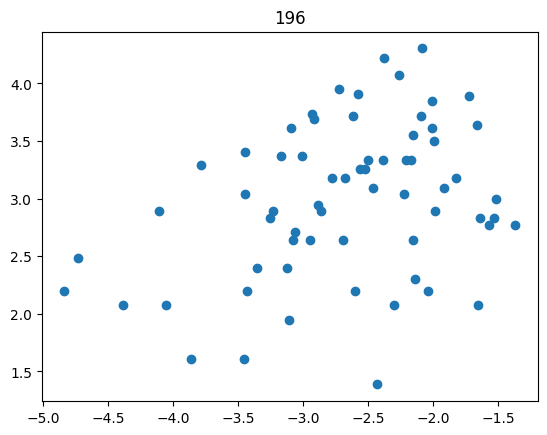

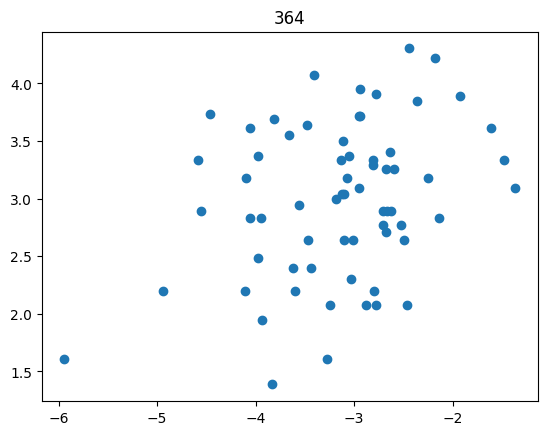

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 54


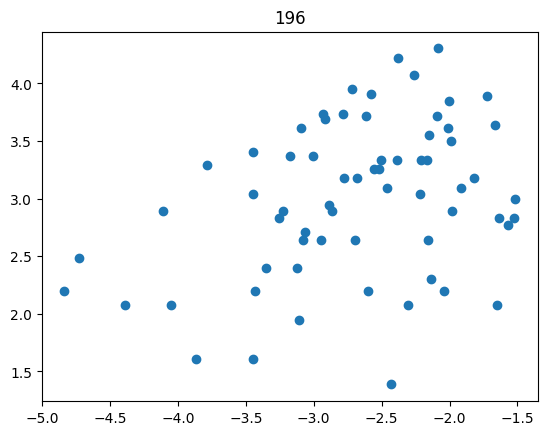

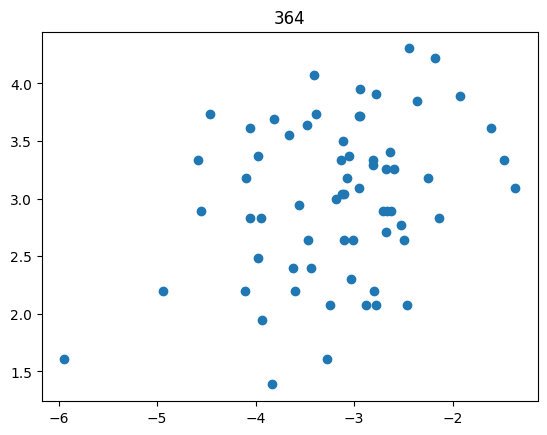

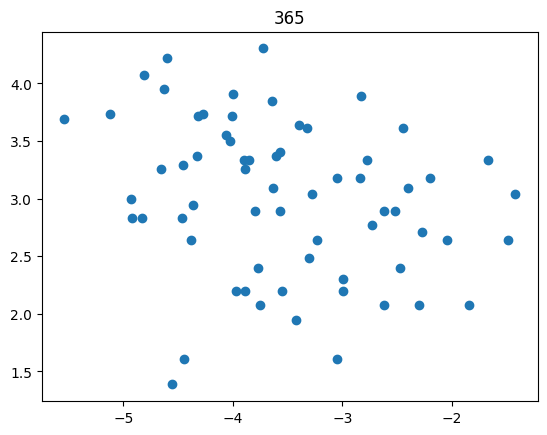

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 55


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

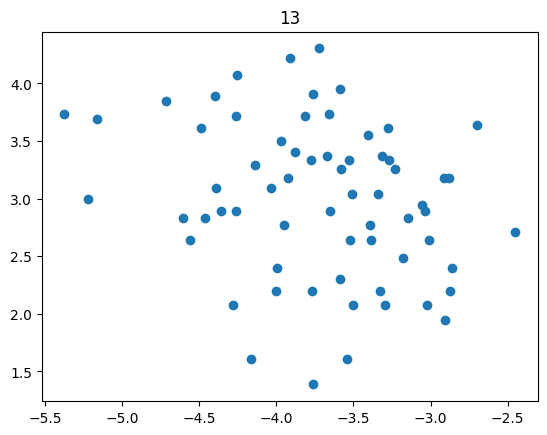

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


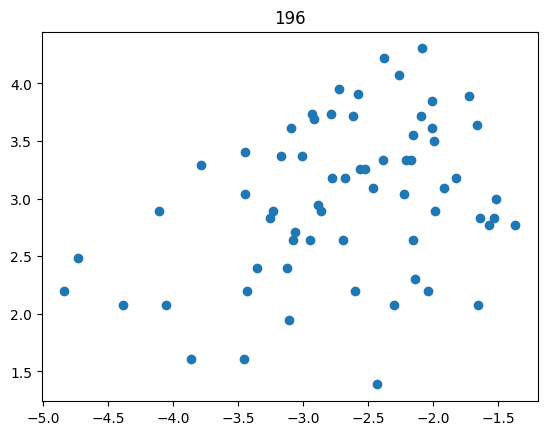

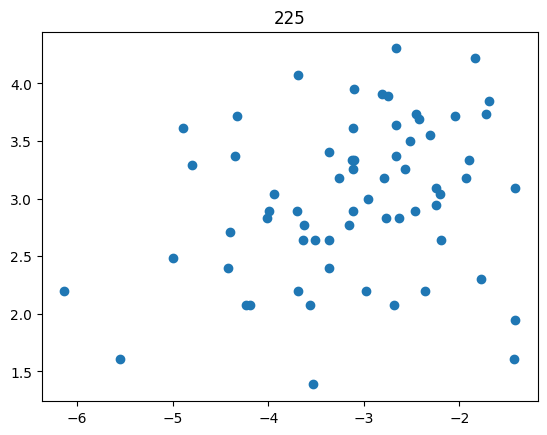

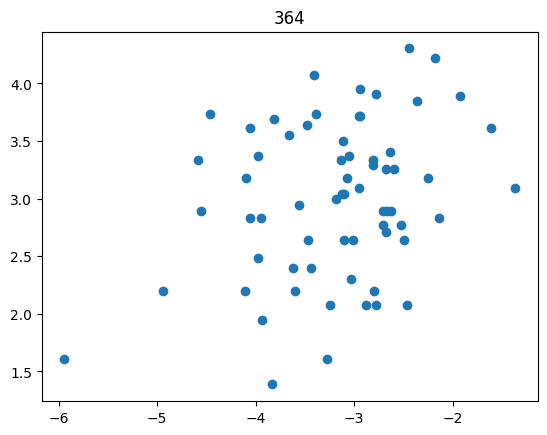

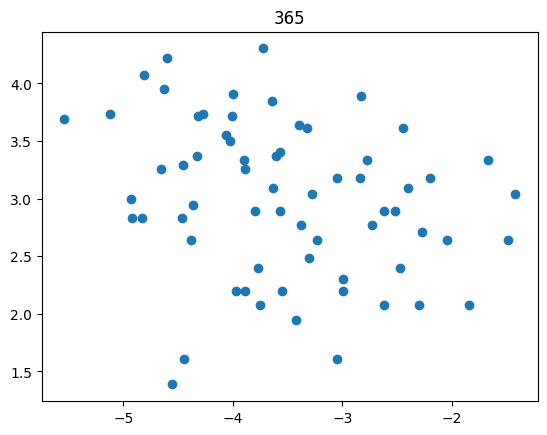

Processing mouse 56


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

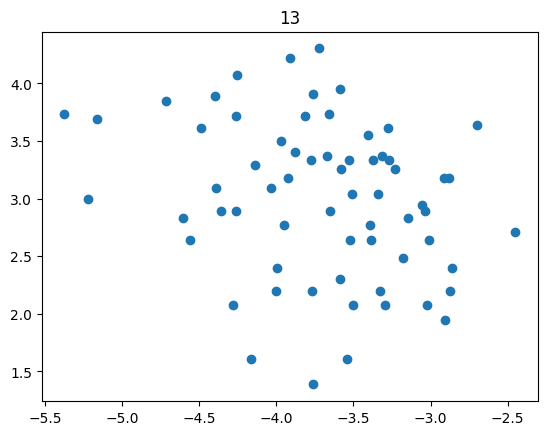

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


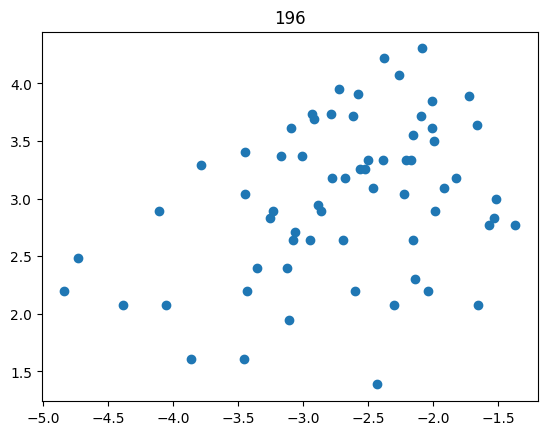

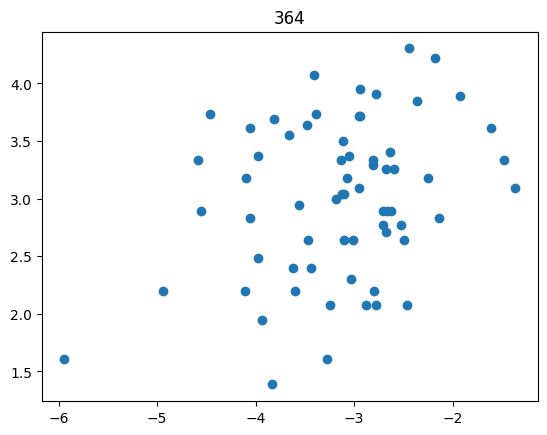

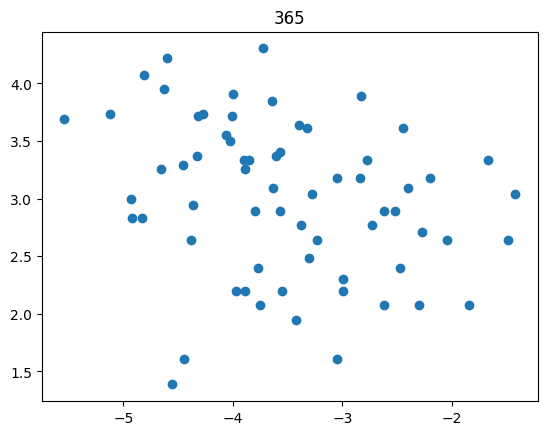

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 57


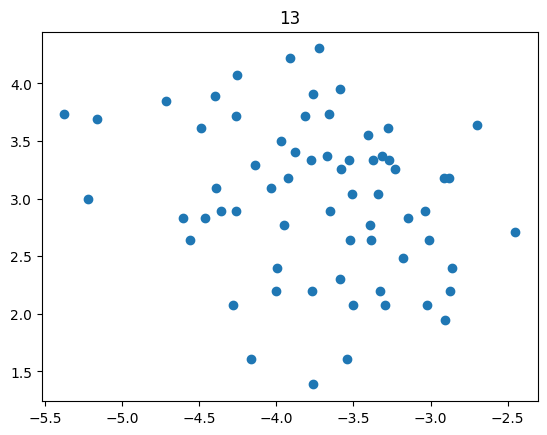

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


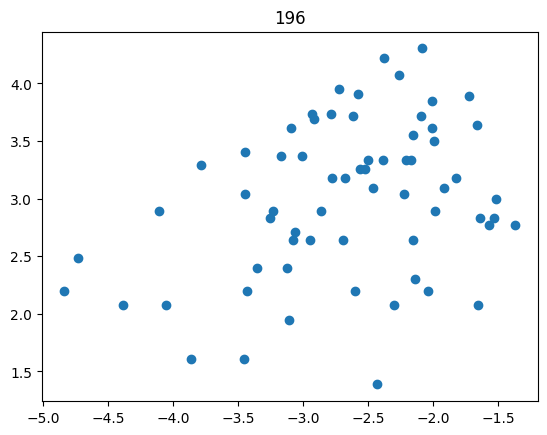

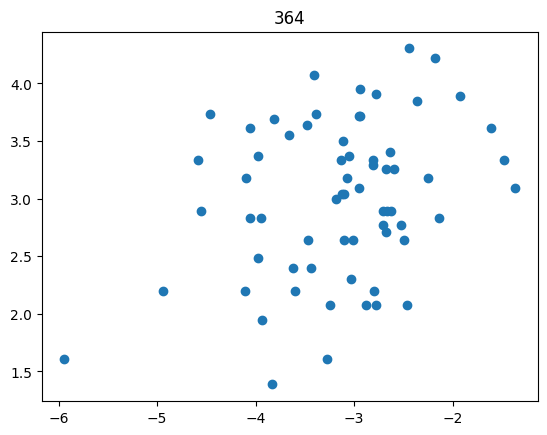

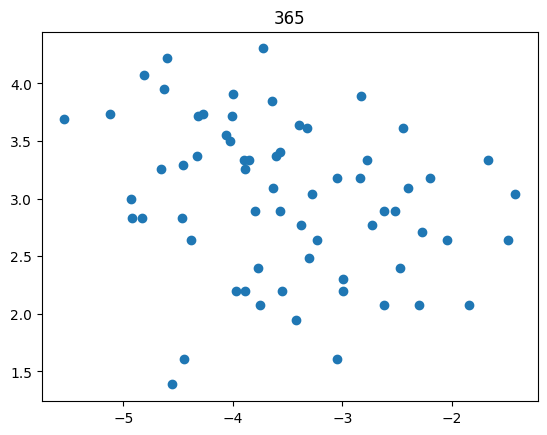

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 58


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


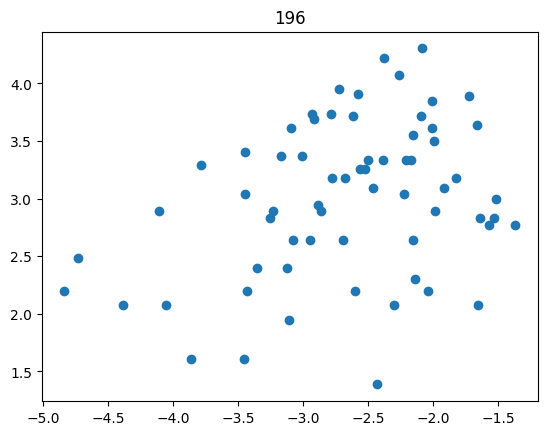

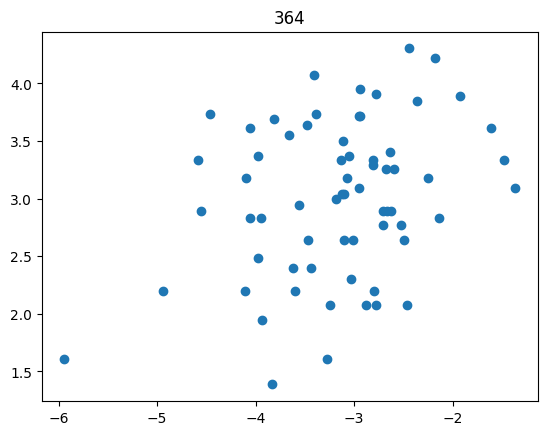

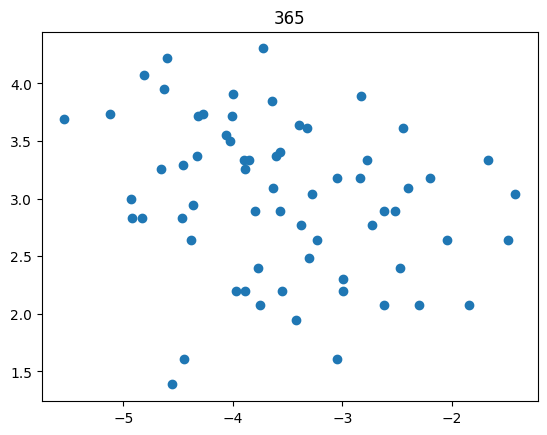

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 59


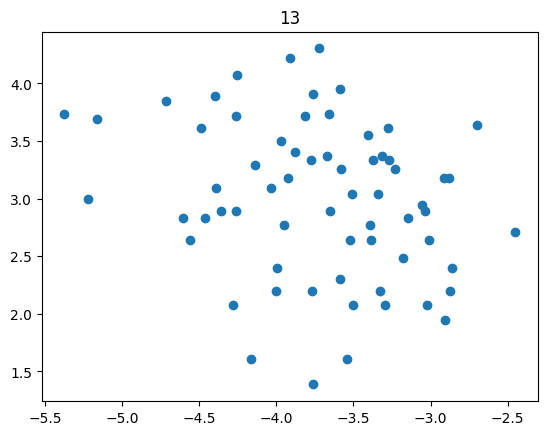

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


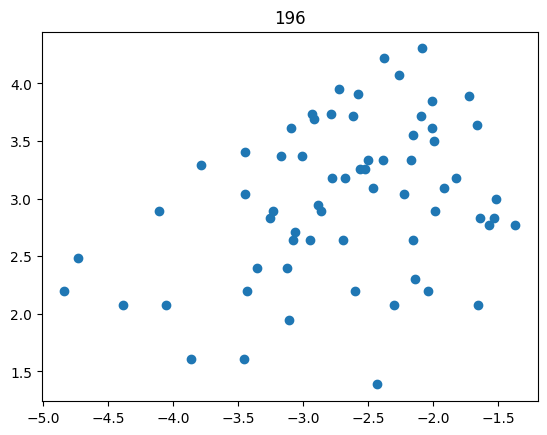

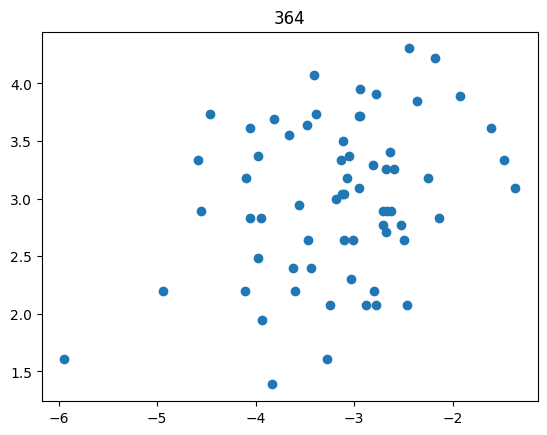

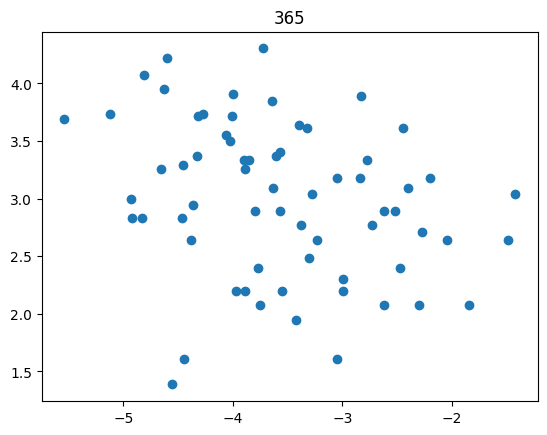

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 60


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

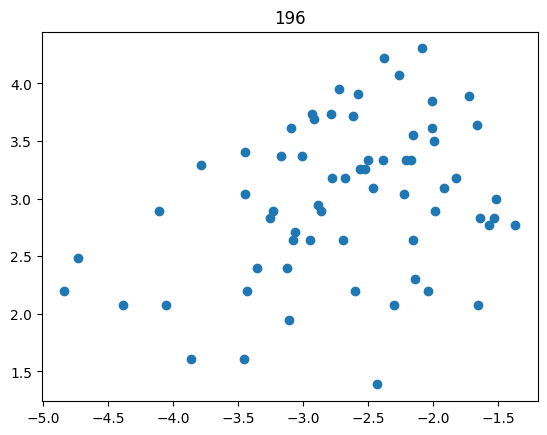

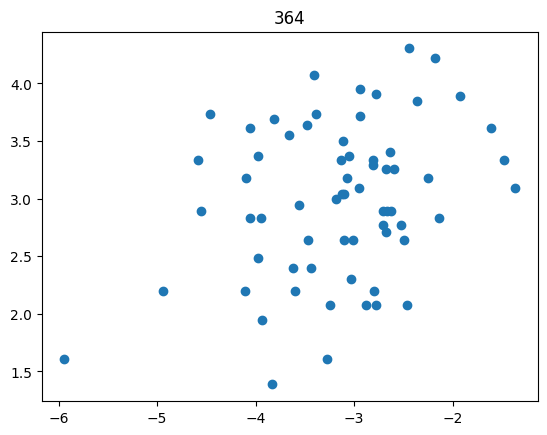

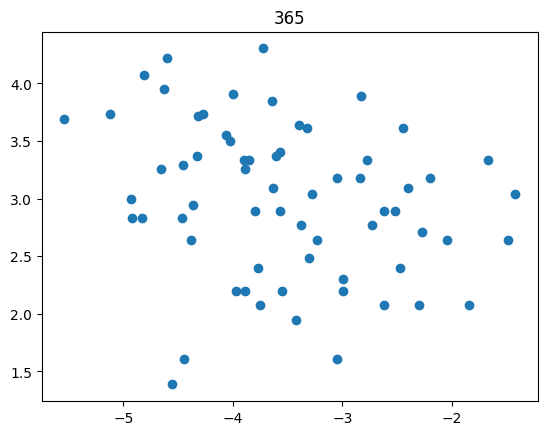

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 61


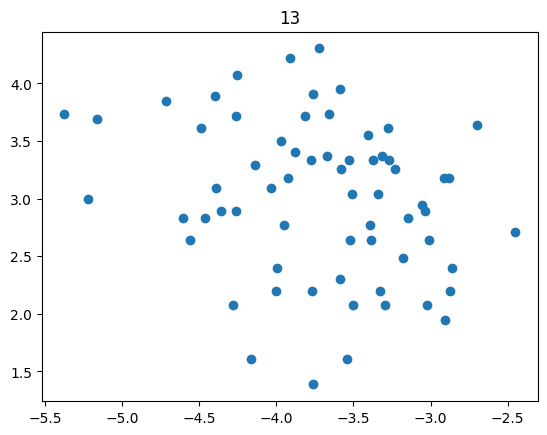

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


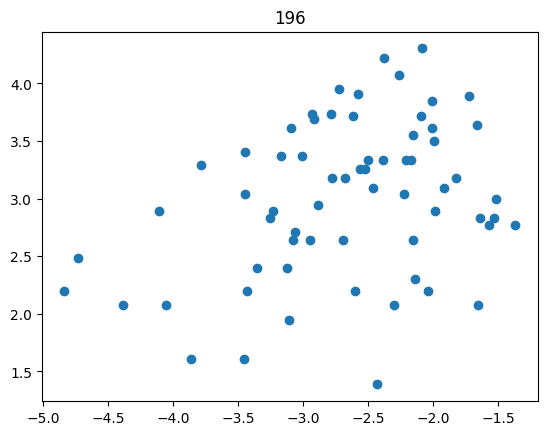

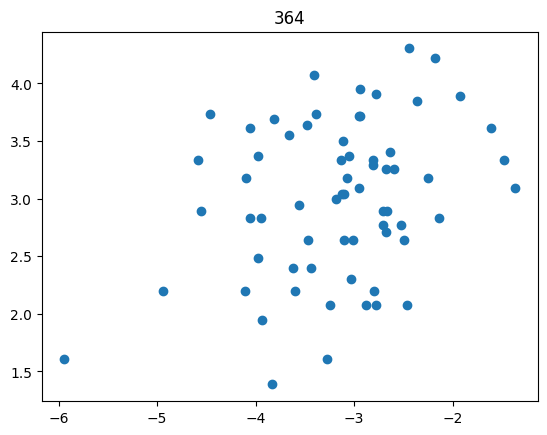

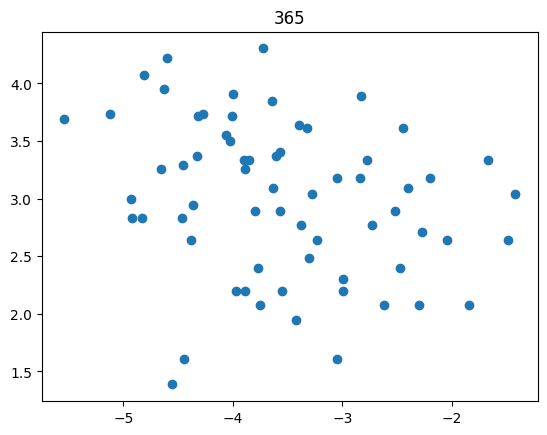

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 62


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

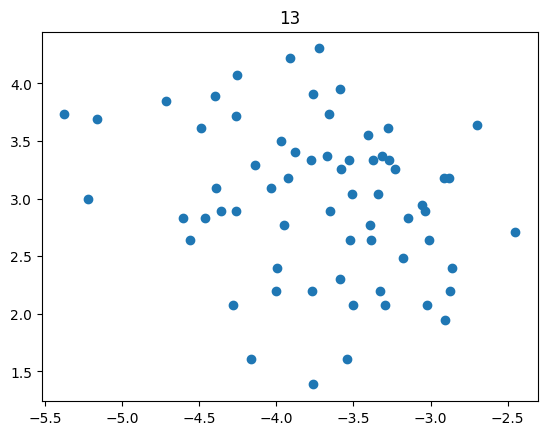

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


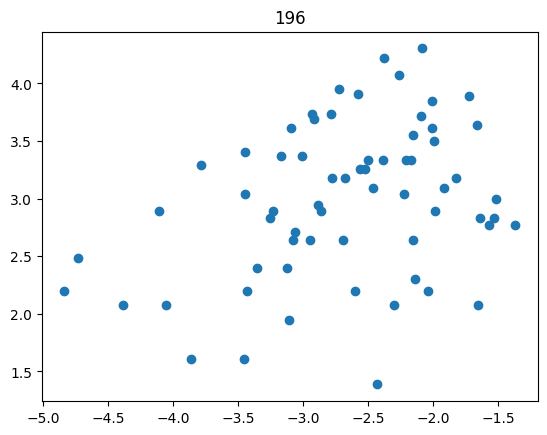

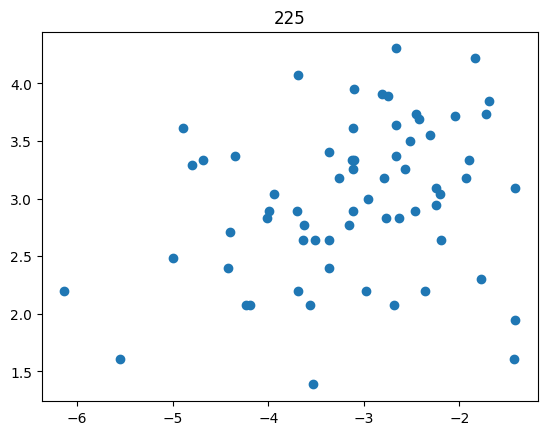

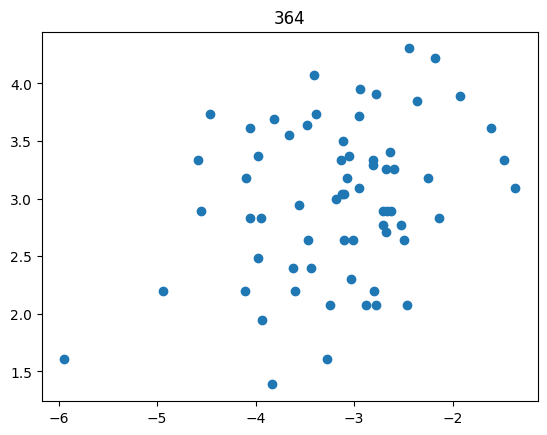

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 63


/tmp/ipykernel_7802/2531426902.py:41: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/2531426902.py:42: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

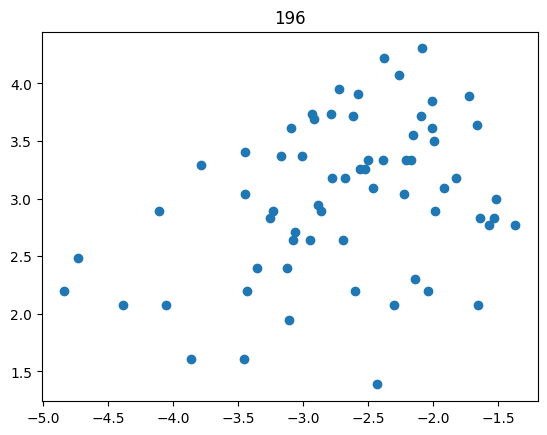

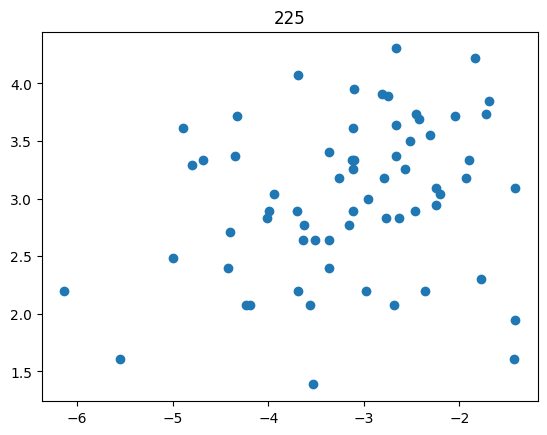

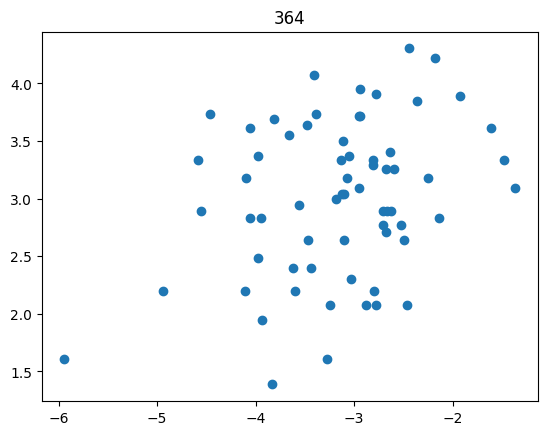

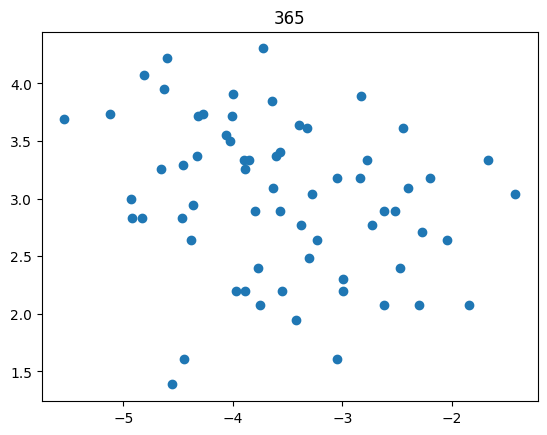

Processing mouse 64


/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

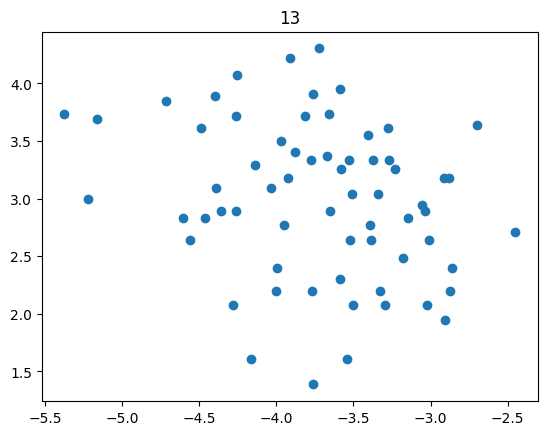

/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


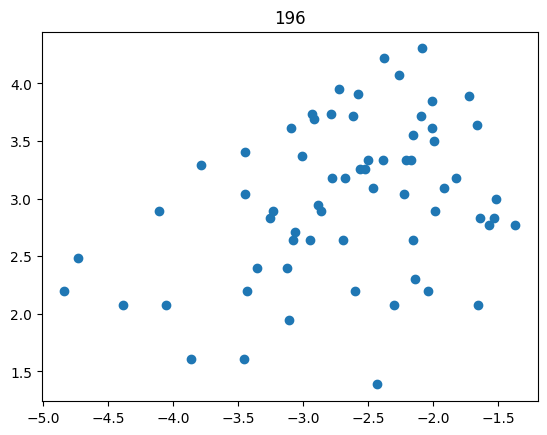

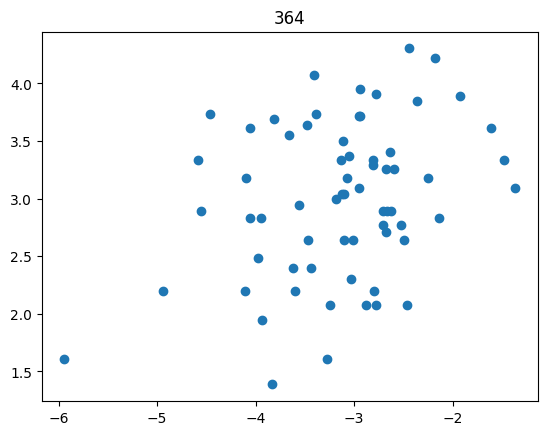

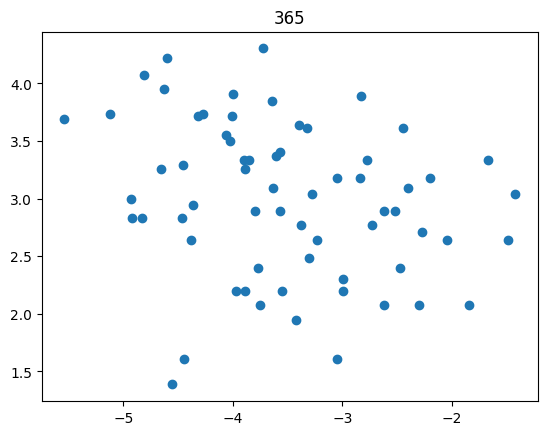

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

Processing mouse 65


/tmp/ipykernel_7802/2531426902.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = spearmanr(x, y)
/tmp/ipykernel_7802/2531426902.py:38: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pearson, p_value = pearsonr(x, y)


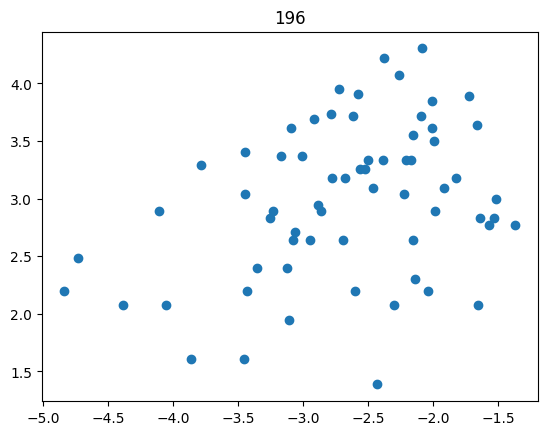

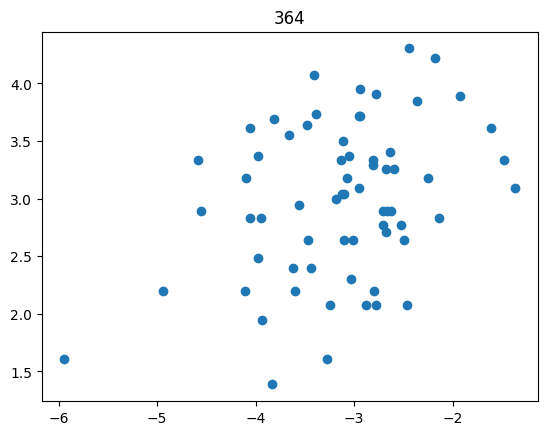

/tmp/ipykernel_7802/2531426902.py:49: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  significant_mouse['mouse'][m] = mouse
/tmp/ipykernel_7802/2531426902.py:50: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You a

In [89]:
syllables = np.arange(0, np.shape(final_matrix)[1])

if shuffle == True:
    use_mat = mat.reindex(np.random.permutation(mat.index)).reset_index().drop(columns='index')
    use_mat['training_time'] = np.log(mat['training_time'])
    use_mat['mouse_number'] = mat['mouse_number']
else:
    use_mat = mat.copy()
    use_mat['training_time'] = np.log(use_mat['training_time'])
mice = use_mat['mouse_number'].drop_duplicates()

features_df = pd.DataFrame(columns=['p_value', 'mouse', 'positive_features', 'negative_features', 'positive_ratio', 'negative_ratio'])
# negative_features = pd.DataFrame(columns=['p_value', 'mouse', 'significant_features'])

pvalues = [0.0001, 0.001, 0.01, 0.05, 0.1]
pvalues = [0.001, 0.01, 0.05]
# pvalues = [0.01, 0.05]
# pvalues = [0.05]

for p, p_v in enumerate(pvalues):
    significant_mouse = pd.DataFrame(columns=['p_value', 'mouse', 'positive_features', 'negative_features', 'positive_ratio', 'negative_ratio'], index=range(len(mice)))

    for m, mouse in enumerate(mice):
    
        print('Processing mouse '+str(mouse))
        
        training = use_mat.loc[use_mat['mouse_number']!=m]
        pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
        prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

        for s, syllable in enumerate(syllables):
            
            # x = prob_syllable[s]
            x = np.sqrt(prob_syllable[s])
            x = np.log(prob_syllable[s])
            y = prob_syllable['training_time']
            pearson, p_value = spearmanr(x, y)
            pearson, p_value = pearsonr(x, y)
            
            # Save data
            pearson_df['syllable'][s] = s
            pearson_df['pearson'][s] = pearson
            pearson_df['p_value'][s] = p_value
            if p_value <p_v:
                plt.scatter(x, y)
                plt.title(syllable)
                plt.show()
        
        significant_mouse['mouse'][m] = mouse
        significant_mouse['p_value'][m] = p_v
        significant_mouse['positive_features'][m] = np.array(pearson_df.loc[(pearson_df['p_value']<p_v) &
                                                        (pearson_df['pearson']>0), 'syllable'])
        significant_mouse['negative_features'][m] = np.array(pearson_df.loc[(pearson_df['p_value']<p_v) &
                                                        (pearson_df['pearson']<0), 'syllable'])
        significant_mouse['positive_ratio'][m] = len(np.array(pearson_df.loc[(pearson_df['p_value']<p_v) &
                                                        (pearson_df['pearson']>0), 'syllable']))/np.shape(final_matrix)[1]
        significant_mouse['negative_ratio'][m] = len(np.array(pearson_df.loc[(pearson_df['p_value']<p_v) &
                                                        (pearson_df['pearson']<0), 'syllable']))/np.shape(final_matrix)[1]
    features_df = pd.concat([features_df, significant_mouse])

Text(0, 0.5, 'Number of significant features')

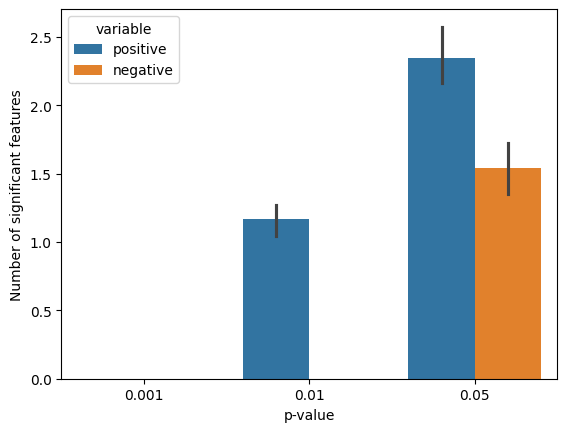

In [90]:
plot_df = pd.melt(features_df, id_vars=['p_value', 'mouse'], value_vars=['positive_ratio', 'negative_ratio'])
plot_df.loc[plot_df['variable']=='positive_ratio', 'variable'] = 'positive'
plot_df.loc[plot_df['variable']=='negative_ratio', 'variable'] = 'negative'
plot_df['value'] = plot_df['value']*np.shape(final_matrix)[1]
sns.barplot(x='p_value', y='value', hue='variable', data=plot_df)
plt.xlabel('p-value')
plt.ylabel('Fraction of significant features')
plt.ylabel('Number of significant features')

Text(0, 0.5, 'Number of significant features')

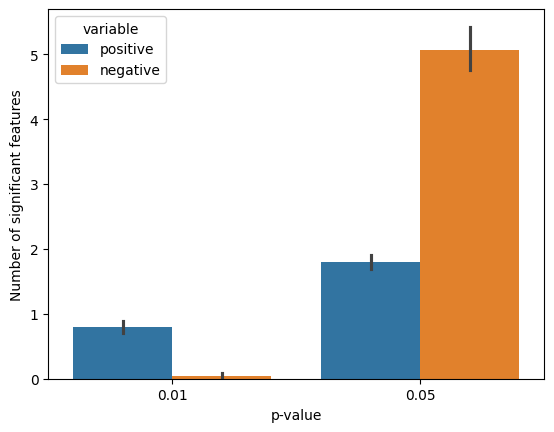

In [23]:
plot_df = pd.melt(features_df, id_vars=['p_value', 'mouse'], value_vars=['positive_ratio', 'negative_ratio'])
plot_df.loc[plot_df['variable']=='positive_ratio', 'variable'] = 'positive'
plot_df.loc[plot_df['variable']=='negative_ratio', 'variable'] = 'negative'
plot_df['value'] = plot_df['value']*np.shape(final_matrix)[1]
sns.barplot(x='p_value', y='value', hue='variable', data=plot_df)
plt.xlabel('p-value')
plt.ylabel('Fraction of significant features')
plt.ylabel('Number of significant features')

Text(0, 0.5, 'Number of significant features')

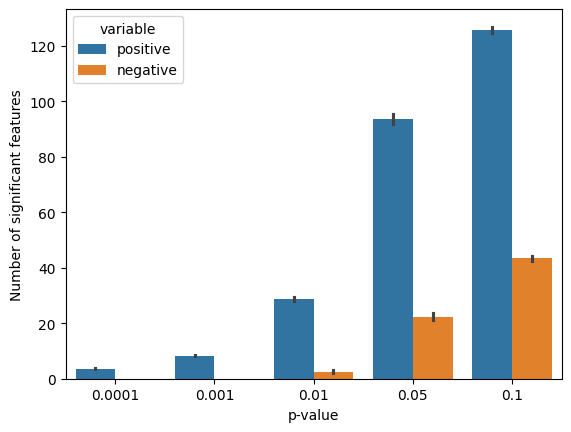

In [278]:
plot_df = pd.melt(features_df, id_vars=['p_value', 'mouse'], value_vars=['positive_ratio', 'negative_ratio'])
plot_df.loc[plot_df['variable']=='positive_ratio', 'variable'] = 'positive'
plot_df.loc[plot_df['variable']=='negative_ratio', 'variable'] = 'negative'
plot_df['value'] = plot_df['value']*640
sns.barplot(x='p_value', y='value', hue='variable', data=plot_df)
plt.xlabel('p-value')
plt.ylabel('Fraction of significant features')
plt.ylabel('Number of significant features')

## Tests for different p-values
Takes ~60 mins to run

In [37]:
from sklearn import svm

In [91]:
syllables = np.arange(0, np.shape(final_matrix)[1])
all_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
pvalues = [0.0001, 0.001, 0.01, 0.05, 0.1]
pvalues = [0.001, 0.01, 0.05]
pvalues = [0.001]
pvalues = [0.01, 0.05]
pvalues = [0.05]

for p, p_v in enumerate(pvalues):
    
    y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
    y_df['mouse_number'] = list(mat['mouse_number'])
    y_df['training_time'] = list(np.log(mat['training_time']))
    y_df = y_df.drop_duplicates().reset_index()
    y_df['p_v'] = p_v

    use_mat = mat.copy()
    use_mat['training_time'] = np.log(mat['training_time'])

    for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
        print('Processing mouse '+str(mouse))
        
        training = use_mat.loc[use_mat['mouse_number']!=m]
        pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
        prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

        for s, syllable in enumerate(syllables):
            
            x = np.sqrt(prob_syllable[s])
            x = np.exp(prob_syllable[s])
            y = prob_syllable['training_time']
            pearson, p_value = spearmanr(x, y)
            pearson, p_value = pearsonr(x, y)
            
            # Save data
            pearson_df['syllable'][s] = s
            pearson_df['pearson'][s] = pearson
            pearson_df['p_value'][s] = p_value

        # Construct feature strength per subject
        training_mice = training.mouse_number.unique()
        significant_features = np.array(pearson_df.loc[pearson_df['p_value']<p_v, 'syllable'])

        X_train = np.ones((len(training_mice), len(significant_features))) * np.nan
        y_train = np.ones(len(training_mice)) * np.nan
        for mm, mmouse in enumerate(training_mice):
            
            mouse_vector = np.sqrt(training.loc[training['mouse_number']==mmouse, syllables].mean(axis=0))
            X_train[mm, :] = mouse_vector[significant_features]
            y_train[mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
        
        X = np.vstack([X_train.T, np.ones(len(training_mice))]).T
        model = RidgeCV(alphas=np.logspace(-3, 3, 10)).fit(np.array(X), np.array(y_train))
        # model = svm.SVR().fit(np.array(X), np.array(y_train))

        # Predict test mouse
        test = use_mat.loc[use_mat['mouse_number']==m]
        test_prob_syllable = np.sqrt(test.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index())
        X_test = np.array(test_prob_syllable[significant_features])
        new_X = np.vstack([X_test.T, np.ones(1)]).T
        predicted_time = model.predict(new_X)

        # Save
        y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)

    all_df = pd.concat([all_df, y_df])

Processing mouse 0


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 1


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 2


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 3


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 4


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 5


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 6


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 7


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 8


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 9


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 10


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 11


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 12


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 13


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 14


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 15


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 16


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 17


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 18


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 19


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 20


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 21


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 22


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 23


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 24


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 25


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 26


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 27


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 28


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 29


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 30


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 31


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 32


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 33


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 34


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 35


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 36


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 37


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 38


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 39


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 40


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 41


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 42


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 43


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 44


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 45


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 46


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 47


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 48


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 49


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 50


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 51


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 52


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 53


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 54


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 55


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 56


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 57


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 58


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 59


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 60


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 61


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 62


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 63


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 64


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

Processing mouse 65


/tmp/ipykernel_7802/3362982861.py:36: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_7802/3362982861.py:37: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

## SVM with all variables

In [57]:
syllables = np.arange(0, np.shape(final_matrix)[1])
all_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
pvalues = [0.0001, 0.001, 0.01, 0.05, 0.1]
pvalues = [0.001, 0.01, 0.05]
pvalues = [0.5]
# for p, p_v in enumerate(pvalues):
    
y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time', 'p_v'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
y_df = y_df.drop_duplicates().reset_index()
# y_df['p_v'] = p_v

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])

for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
    prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

    # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    significant_features = np.array(pearson_df.loc[pearson_df['p_value']<p_v, 'syllable'])

    X_train = np.ones((len(training_mice), len(syllables))) * np.nan
    y_train = np.ones(len(training_mice)) * np.nan
    for mm, mmouse in enumerate(training_mice):
        
        mouse_vector = np.sqrt(training.loc[training['mouse_number']==mmouse, syllables].mean(axis=0))
        X_train[mm, :] = mouse_vector
        y_train[mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
    
    X = np.vstack([X_train.T, np.ones(len(training_mice))]).T
    # model = RidgeCV(alphas=np.logspace(-3, 3, 10)).fit(np.array(X), np.array(y_train))
    model = svm.SVR(kernel="poly", C=100, gamma="auto", degree=3, epsilon=0.1, coef0=1).fit(np.array(X), np.array(y_train))

    # Predict test mouse
    test = use_mat.loc[use_mat['mouse_number']==m]
    test_prob_syllable = np.sqrt(test.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index())
    X_test = np.array(test_prob_syllable[syllables])
    new_X = np.vstack([X_test.T, np.ones(1)]).T
    predicted_time = model.predict(new_X)

    # Save
    y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)
    all_df = pd.concat([all_df, y_df])

Processing mouse 0


/tmp/ipykernel_7802/60913335.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_df = pd.concat([all_df, y_df])


Processing mouse 1
Processing mouse 2
Processing mouse 3
Processing mouse 4
Processing mouse 5
Processing mouse 6
Processing mouse 7
Processing mouse 8
Processing mouse 9
Processing mouse 10
Processing mouse 11
Processing mouse 12
Processing mouse 13
Processing mouse 14
Processing mouse 15
Processing mouse 16
Processing mouse 17
Processing mouse 18
Processing mouse 19
Processing mouse 20
Processing mouse 21
Processing mouse 22
Processing mouse 23
Processing mouse 24
Processing mouse 25
Processing mouse 26
Processing mouse 27
Processing mouse 28
Processing mouse 29
Processing mouse 30
Processing mouse 31
Processing mouse 32
Processing mouse 33
Processing mouse 34
Processing mouse 35
Processing mouse 36
Processing mouse 37
Processing mouse 38
Processing mouse 39
Processing mouse 40
Processing mouse 41
Processing mouse 42
Processing mouse 43
Processing mouse 44
Processing mouse 45
Processing mouse 46
Processing mouse 47
Processing mouse 48
Processing mouse 49
Processing mouse 50
Processin

In [331]:
file_to_save = all_df.copy()
filename = "model_comparison_significance"
save_path = prefix + 'representation_learning_variability/Models/Sub-trial/4_analyses/8_Learning_speed/'
file_format = 'parquet'
script_name = '8.3_learning_speed_prediction.ipynb'
meta = save_and_log(file_to_save, filename, file_format, save_path, script_name)

In [92]:
save_df = all_df.copy()

PearsonRResult(statistic=np.float64(-0.4102438330269467), pvalue=np.float64(0.0006237332547844487))


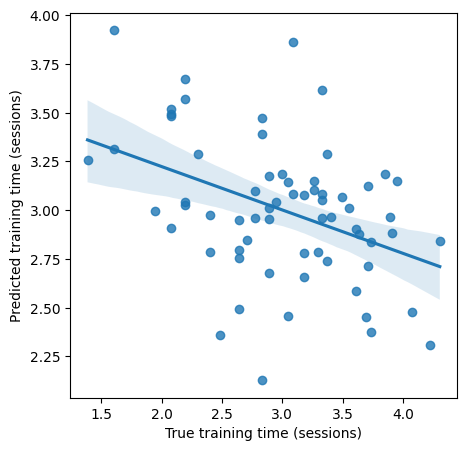

In [94]:
plot_data = save_df.loc[save_df['predicted_time']>0]
# plot_data = save_df.copy()
plt.figure(figsize=(5, 5))
sns.regplot(x=np.array(plot_data['training_time']).astype(float), y=plot_data['predicted_time'].astype(float), ci=95) 
plt.xticks([1.5, 2.5, 3.5, 4.5], np.round(np.exp([1.5, 2.5, 3.5, 4.5])))
plt.yticks([1.5, 2.5, 3.5, 4.5], np.round(np.exp([1.5, 2.5, 3.5, 4.5])))
plt.xlabel('True training time (sessions)')
plt.ylabel('Predicted training time (sessions)')
res = stats.pearsonr(plot_data['training_time'].astype(float), plot_data['predicted_time'].astype(float))
print(res)

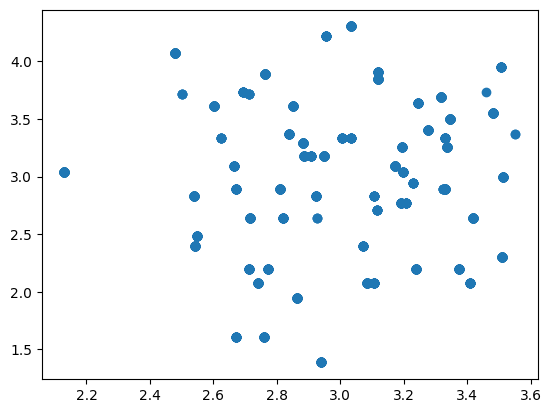

In [50]:
plt.scatter(save_df['predicted_time'], save_df['training_time'])

In [44]:
save_df['predicted_time'] = save_df['predicted_time'].astype(float)
r2 = save_df.groupby(['p_v']).apply(lambda x :r2_score(x['training_time'], x['predicted_time'])).reset_index()
r = save_df.groupby(['p_v']).apply(lambda x :stats.pearsonr(x['training_time'], x['predicted_time'])).reset_index()
r['p_value'] = r[0].apply(lambda x: x[1])
r['corr'] = r[0].apply(lambda x: x[0])

/tmp/ipykernel_7802/3411895360.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  r2 = save_df.groupby(['p_v']).apply(lambda x :r2_score(x['training_time'], x['predicted_time'])).reset_index()


ValueError: cannot insert p_v, already exists

Text(0, 0.5, 'Training time prediction R²')

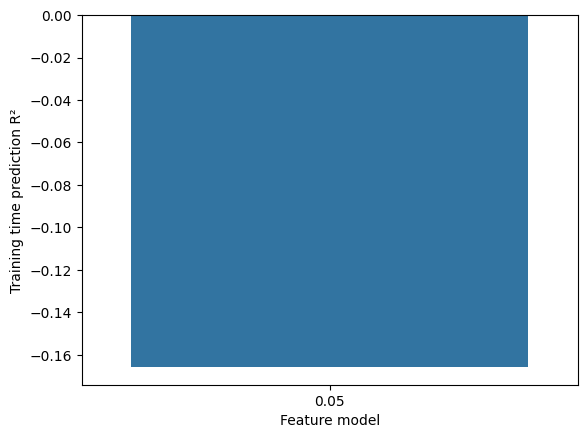

In [45]:
sns.barplot(x='p_v', y=0, data=r2)
plt.xlabel('Feature model')
plt.ylabel('Training time prediction R²')

Text(0, 0.5, 'Training time prediction R²')

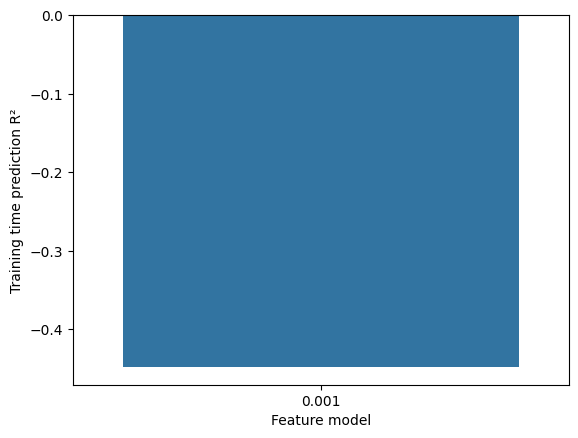

In [73]:
sns.barplot(x='p_v', y=0, data=r2)
plt.xlabel('Feature model')
plt.ylabel('Training time prediction R²')

Text(0, 0.5, 'Training time correlation coefficient')

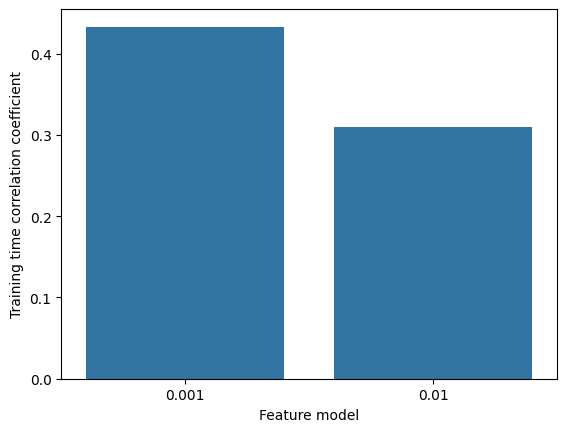

In [25]:
sns.barplot(x='p_v', y='corr', data=r)
plt.xlabel('Feature model')
plt.ylabel('Training time correlation coefficient')

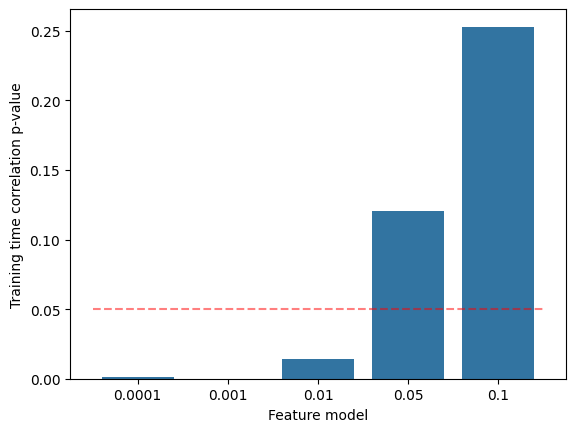

In [329]:
sns.barplot(x='p_v', y='p_value', data=r)
plt.xlabel('Feature model')
plt.ylabel('Training time correlation p-value')
plt.hlines(0.05, -.5, 4.5, linestyles='--', alpha=0.5, color='red')

## Which features are significantly correlated

In [39]:
syllables = np.arange(0, np.shape(final_matrix)[1])

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])
mice = use_mat['mouse_number'].drop_duplicates()

sign_feat_pos = np.zeros((len(mice), np.shape(final_matrix)[1]))
sign_feat_neg = np.zeros((len(mice), np.shape(final_matrix)[1]))

# feature_coeffs = {}
# feature_coeffs = np.zeros((len(mice), np.shape(final_matrix)[1]))
# scores = np.zeros(len(use_mat['mouse_number'].drop_duplicates()))

for m, mouse in enumerate(mice):
    
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
    prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

    for s, syllable in enumerate(syllables):
        
        x = np.sqrt(prob_syllable[s])
        y = prob_syllable['training_time']
        pearson, p_value = spearmanr(x, y)
        # if p_value < 0.001:
        #     plt.scatter(x, y)
        #     plt.title(syllable)
        #     plt.show()
        
        # Save data
        pearson_df['syllable'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value

    # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    significant_features_pos = np.array(pearson_df.loc[(pearson_df['p_value']<0.001) &
                                                       (pearson_df['pearson']>0), 'syllable']).astype(int)
    significant_features_neg = np.array(pearson_df.loc[(pearson_df['p_value']<0.001) &
                                                       (pearson_df['pearson']<0), 'syllable']).astype(int)
    # sign_feat_count[m] = len(significant_features)
    sign_feat_pos[m, significant_features_pos] = 1
    sign_feat_neg[m, significant_features_neg] = 1

Processing mouse 0


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 1


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 2


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 3


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 4


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 5


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 6


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 7


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 8


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 9


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 10


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 11


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 12


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 13


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 14


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 15


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 16


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 17


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 18


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 19


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 20


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 21


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 22


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 23


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 24


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 25


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 26


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 27


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 28


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 29


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 30


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 31


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 32


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 33


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 34


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 35


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 36


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 37


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 38


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 39


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 40


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 41


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 42


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 43


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 44


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 45


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 46


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 47


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 48


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 49


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 50


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 51


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 52


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 53


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 54


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 55


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 56


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 57


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 58


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 59


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 60


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 61


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 62


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 63


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 64


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 65


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 66


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 67


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 68


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 69


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 70


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 71


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 72


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 73


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 74


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 75


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 76


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 77


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 78


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 79


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

Processing mouse 80


/tmp/ipykernel_13718/1109455783.py:38: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/1109455783.py:39: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are set

In [40]:
use_states = int(max(np.unique(use_sequences)))+1
timesteps = np.shape(use_sequences)[1]
reshaped_importances = np.zeros((use_states, timesteps)) * np.nan
reshaped_features = pd.DataFrame(columns=['syllable', 'timestep', 'significance'], index=range(use_states * timesteps))

# for m in mice:
for t in range(timesteps):
       # feats = sign_feat[m, :]
       feats = sign_feat_pos.mean(axis=0)
       reshaped_features['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
              '210', '310', '001', '101', '201', '301', '011',
              '111', '211', '311']
       reshaped_features['timestep'][t*use_states:(t+1)*use_states] = t
       reshaped_features['significance'][t*use_states:(t+1)*use_states] = feats[t*use_states:(t+1)*use_states]
              # reshaped_features['mouse'][t*use_states:(t+1)*use_states] = m


/tmp/ipykernel_13718/2795835458.py:10: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  reshaped_features['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
/tmp/ipykernel_13718/2795835458.py:13: FutureWarni

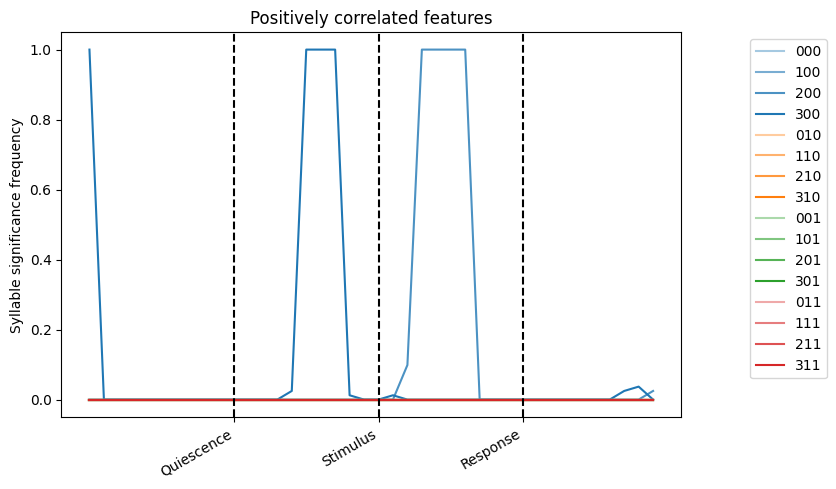

In [41]:
palette_16 = create_grouped_gradient_palette(n_groups=4, shades_per_group=4, base_palette='tab10')
palette_16_list = [palette_16(i) for i in range(palette_16.N)]  # Extract colors properly
order = ['000', '100', '200', '300', '010', '110',
           '210', '310', '001', '101', '201', '301', '011',
           '111', '211', '311']
state_to_color = dict(zip(order, palette_16_list))

fig, axs = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(8, 5))

sns.lineplot(x='timestep', y='significance', hue='syllable', data=reshaped_features, 
             ax=axs, palette=palette_16_list)
axs.axvline(x=10, color='k', linestyle='--')
axs.axvline(x=20, color='k', linestyle='--')
axs.axvline(x=30, color='k', linestyle='--')
axs.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
axs.set_ylabel('Syllable significance frequency')
axs.set_title('Positively correlated features')
axs.set_xlabel('')
axs.set_xticks(np.arange(10, 31, 10), ['Quiescence', 'Stimulus', 'Response'], rotation=30, ha='right')

## Feature coefficients

In [12]:
syllables = np.arange(0, np.shape(final_matrix)[1])

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])
mice = use_mat['mouse_number'].drop_duplicates()

feature_coeffs = np.zeros((len(mice), np.shape(final_matrix)[1]))

for m, mouse in enumerate(mice):
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)
    prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

    for s, syllable in enumerate(syllables):
        
        x = np.sqrt(prob_syllable[s])
        y = prob_syllable['training_time']
        pearson, p_value = spearmanr(x, y)
        
        # Save data
        pearson_df['syllable'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value

    # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    significant_features = np.array(pearson_df.loc[pearson_df['p_value']<0.001, 'syllable'])
    # sign_feat_count[m] = len(significant_features)
    # sign_feat[m] = significant_features

    X_train = np.ones((len(training_mice), len(significant_features))) * np.nan
    y_train = np.ones(len(training_mice)) * np.nan
    for mm, mmouse in enumerate(training_mice):
        
        mouse_vector = np.sqrt(training.loc[training['mouse_number']==mmouse, syllables].mean(axis=0))
        X_train[mm, :] = mouse_vector[significant_features]
        y_train[mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
    
    # Train model leaving one out
    X = np.vstack([X_train.T, np.ones(len(training_mice))]).T
    model = RidgeCV(alphas=np.logspace(-3, 3, 10)).fit(np.array(X), np.array(y_train))

    # Predict test mouse
    test = use_mat.loc[use_mat['mouse_number']==m]
    test_prob_syllable = np.sqrt(test.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index())
    X_test = np.array(test_prob_syllable[significant_features])
    
    new_X = np.vstack([X_test.T, np.ones(1)]).T
    predicted_time = model.predict(new_X)

    # Save
    y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)
    # scores[m] = model.score(X, y_train)
    feature_coeffs[m, significant_features.astype(int)] = model.coef_[:-1]


Processing mouse 0


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 1


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 2


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 3


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 4


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 5


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 6


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 7


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 8


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 9


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 10


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 11


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 12


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 13


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 14


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 15


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 16


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 17


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 18


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 19


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 20


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 21


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 22


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 23


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 24


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 25


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 26


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 27


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 28


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 29


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 30


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 31


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 32


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 33


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 34


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 35


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 36


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 37


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 38


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 39


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 40


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 41


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 42


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 43


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 44


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 45


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 46


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 47


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 48


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 49


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 50


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 51


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 52


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 53


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 54


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 55


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 56


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 57


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 58


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 59


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 60


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 61


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 62


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 63


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 64


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 65


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 66


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 67


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 68


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 69


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 70


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 71


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 72


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 73


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 74


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 75


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 76


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 77


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 78


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 79


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 80


/tmp/ipykernel_13718/68488269.py:28: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_13718/68488269.py:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

In [27]:
use_states = int(max(np.unique(use_sequences)))+1
timesteps = np.shape(use_sequences)[1]
reshaped_importances = np.zeros((use_states, timesteps)) * np.nan
reshaped_features = pd.DataFrame(columns=['mouse', 'syllable', 'timestep', 'coefficient'])

for m in mice:
       reshaped_features_mouse = pd.DataFrame(columns=['mouse', 'syllable', 'timestep', 'coefficient'], index=range(use_states * timesteps))
       for t in range(timesteps):
              feats = feature_coeffs[m, :]
              # feats = feature_coeffs.mean(axis=0)
              reshaped_features_mouse['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
                     '210', '310', '001', '101', '201', '301', '011',
                     '111', '211', '311']
              reshaped_features_mouse['timestep'][t*use_states:(t+1)*use_states] = t
              reshaped_features_mouse['coefficient'][t*use_states:(t+1)*use_states] = feats[t*use_states:(t+1)*use_states]
              reshaped_features_mouse['mouse'][t*use_states:(t+1)*use_states] = m
       
       reshaped_features = pd.concat([reshaped_features, reshaped_features_mouse])


/tmp/ipykernel_13718/1820927992.py:11: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  reshaped_features_mouse['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
/tmp/ipykernel_13718/1820927992.py:14: Futur

In [31]:
use_states = int(max(np.unique(use_sequences)))+1
timesteps = np.shape(use_sequences)[1]
reshaped_importances = np.zeros((use_states, timesteps)) * np.nan
reshaped_features = pd.DataFrame(columns=['mouse', 'syllable', 'timestep', 'coefficient'])

# for m in mice:
reshaped_features_mouse = pd.DataFrame(columns=['mouse', 'syllable', 'timestep', 'coefficient'], index=range(use_states * timesteps))
for t in range(timesteps):
        feats = feature_coeffs[m, :]
        # feats = feature_coeffs.mean(axis=0)
        reshaped_features_mouse['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
                '210', '310', '001', '101', '201', '301', '011',
                '111', '211', '311']
        reshaped_features_mouse['timestep'][t*use_states:(t+1)*use_states] = t
        reshaped_features_mouse['coefficient'][t*use_states:(t+1)*use_states] = feats[t*use_states:(t+1)*use_states]
        # reshaped_features_mouse['mouse'][t*use_states:(t+1)*use_states] = m

reshaped_features = pd.concat([reshaped_features, reshaped_features_mouse])


/tmp/ipykernel_13718/913717610.py:11: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  reshaped_features_mouse['syllable'][t*use_states:(t+1)*use_states] = ['000', '100', '200', '300', '010', '110',
/tmp/ipykernel_13718/913717610.py:14: FutureW

In [32]:
reshaped_features

,mouse,syllable,timestep,coefficient
0,NaN,000,0,0.0
1,NaN,100,0,0.0
2,NaN,200,0,0.0
3,NaN,300,0,0.140881
4,NaN,010,0,0.0
...,...,...,...,...
635,NaN,301,39,0.0
636,NaN,011,39,0.0
637,NaN,111,39,0.0
638,NaN,211,39,0.0


In [33]:
reshaped_features.loc[reshaped_features['coefficient']==0, 'coefficient'] = np.nan

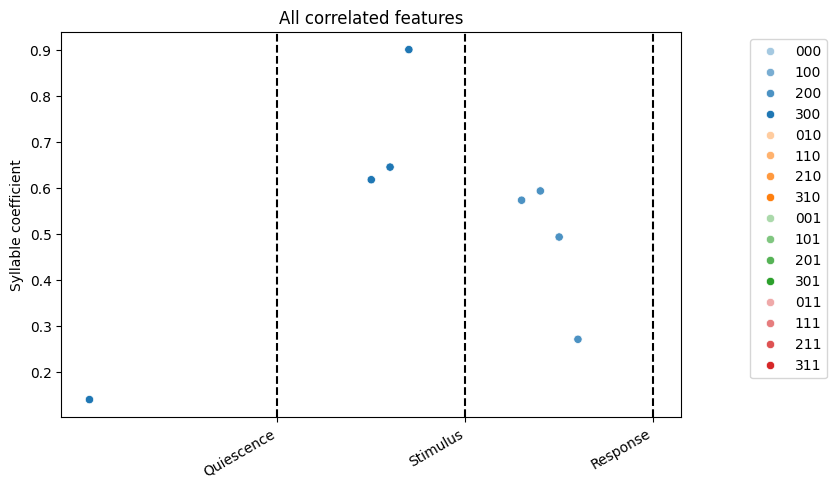

In [34]:
palette_16 = create_grouped_gradient_palette(n_groups=4, shades_per_group=4, base_palette='tab10')
palette_16_list = [palette_16(i) for i in range(palette_16.N)]  # Extract colors properly
order = ['000', '100', '200', '300', '010', '110',
           '210', '310', '001', '101', '201', '301', '011',
           '111', '211', '311']
state_to_color = dict(zip(order, palette_16_list))

fig, axs = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(8, 5))

sns.scatterplot(x='timestep', y='coefficient', hue='syllable', data=reshaped_features.reset_index(), 
             ax=axs, palette=palette_16_list) # , alpha=0.8
axs.axvline(x=10, color='k', linestyle='--')
axs.axvline(x=20, color='k', linestyle='--')
axs.axvline(x=30, color='k', linestyle='--')
axs.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
axs.set_ylabel('Syllable coefficient')
axs.set_title('All correlated features')
axs.set_xlabel('')
axs.set_xticks(np.arange(10, 31, 10), ['Quiescence', 'Stimulus', 'Response'], rotation=30, ha='right')

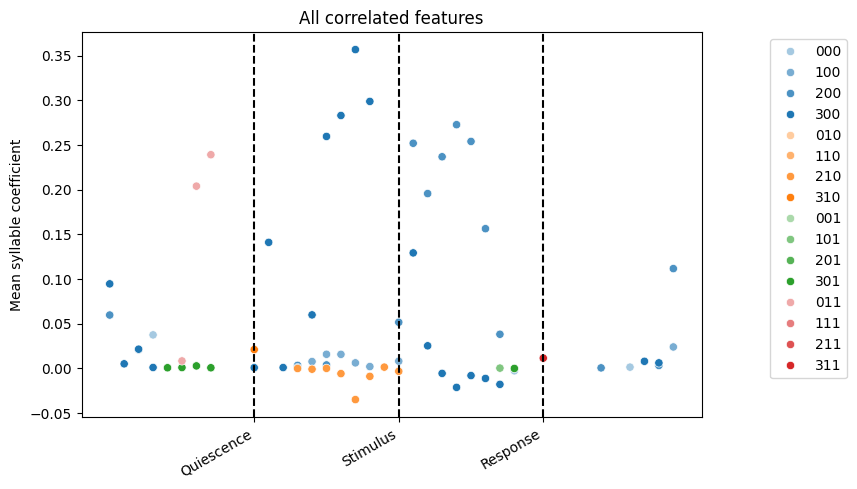

In [450]:
palette_16 = create_grouped_gradient_palette(n_groups=4, shades_per_group=4, base_palette='tab10')
palette_16_list = [palette_16(i) for i in range(palette_16.N)]  # Extract colors properly
order = ['000', '100', '200', '300', '010', '110',
           '210', '310', '001', '101', '201', '301', '011',
           '111', '211', '311']
state_to_color = dict(zip(order, palette_16_list))

fig, axs = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(8, 5))

sns.scatterplot(x='timestep', y='coefficient', hue='syllable', data=reshaped_features.reset_index(), 
             ax=axs, palette=palette_16_list) # , alpha=0.8
axs.axvline(x=10, color='k', linestyle='--')
axs.axvline(x=20, color='k', linestyle='--')
axs.axvline(x=30, color='k', linestyle='--')
axs.legend(loc='upper left', bbox_to_anchor=(1.1, 1))
axs.set_ylabel('Syllable coefficient')
axs.set_title('All correlated features')
axs.set_xlabel('')
axs.set_xticks(np.arange(10, 31, 10), ['Quiescence', 'Stimulus', 'Response'], rotation=30, ha='right')

In [276]:
test_R2 = r2_score(all_df.loc[all_df['p_v']==0.001, 'training_time'][:2], all_df.loc[all_df['p_v']==0.001, 'predicted_time'][:2])
print(test_R2)
mse = mean_squared_error(all_df.loc[all_df['p_v']==0.001, 'training_time'][:2], all_df.loc[all_df['p_v']==0.001, 'predicted_time'][:2])
mse

-4.154128961978314


0.3513592276975928

In [452]:
test_R2 = r2_score(y_df['training_time'], y_df['predicted_time'])
print(test_R2)
mse = mean_squared_error(y_df['training_time'], y_df['predicted_time'])
mse

0.04250107550171467


0.2919514047829991

(array([ 8., 13., 33., 17.,  7.,  0.,  0.,  0.,  2.,  1.]),
 array([0.26718376, 0.27444258, 0.2817014 , 0.28896022, 0.29621904,
        0.30347786, 0.31073668, 0.3179955 , 0.32525433, 0.33251315,
        0.33977197]),
 <BarContainer object of 10 artists>)

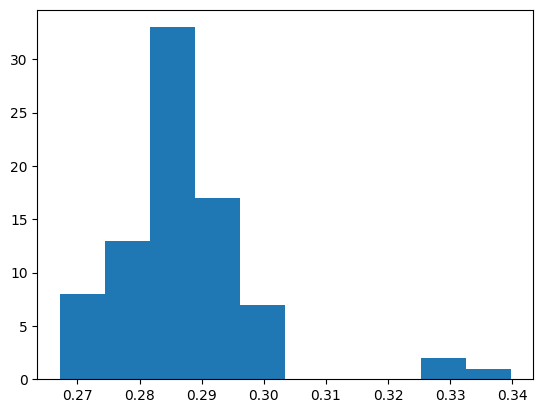

In [60]:
plt.hist(scores)

(0.2709715252126585, 0.01441296452020729)


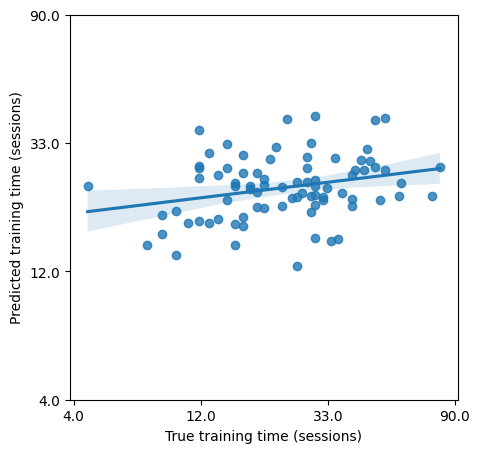

In [451]:
plot_data = y_df.loc[y_df['predicted_time']>0]
plot_data = y_df.copy()
plt.figure(figsize=(5, 5))
sns.regplot(x=np.array(plot_data['training_time']).astype(float), y=y_reg.astype(float), ci=95) 
plt.xticks([1.5, 2.5, 3.5, 4.5], np.round(np.exp([1.5, 2.5, 3.5, 4.5])))
plt.yticks([1.5, 2.5, 3.5, 4.5], np.round(np.exp([1.5, 2.5, 3.5, 4.5])))
plt.xlabel('True training time (sessions)')
plt.ylabel('Predicted training time (sessions)')
res = stats.pearsonr(plot_data['training_time'], plot_data['predicted_time'])
print(res)

# Old code

Processing mouse 0


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

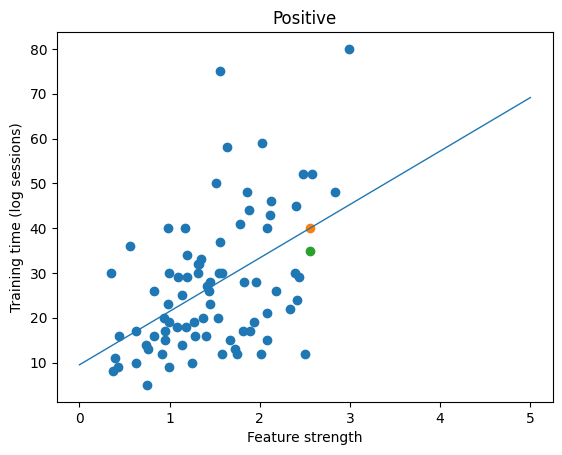

Processing mouse 1


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

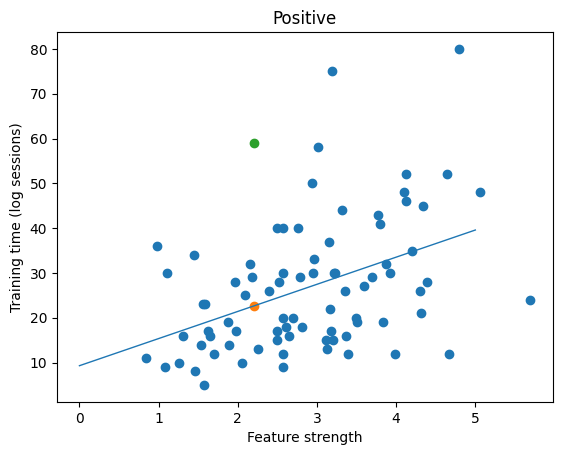

Processing mouse 2


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

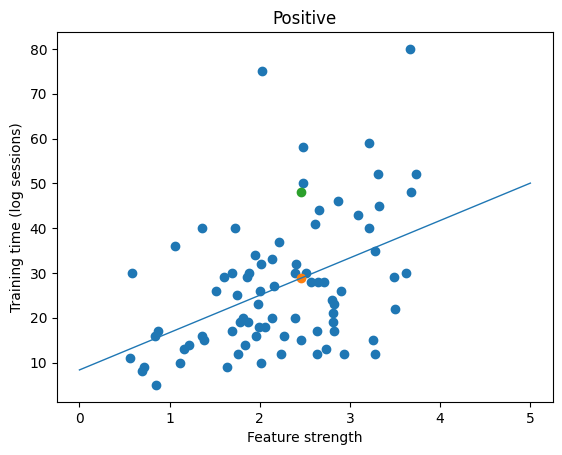

Processing mouse 3


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

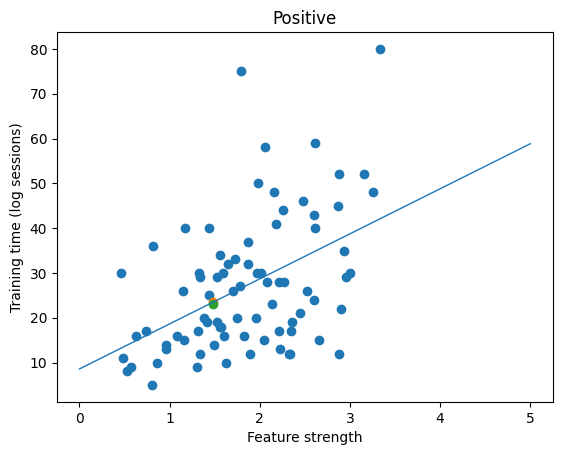

Processing mouse 4


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

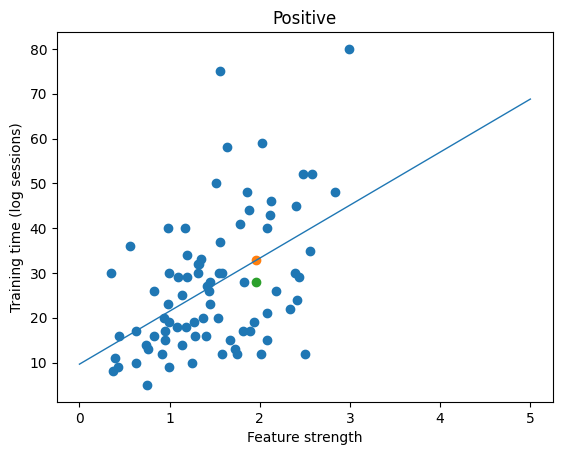

Processing mouse 5


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

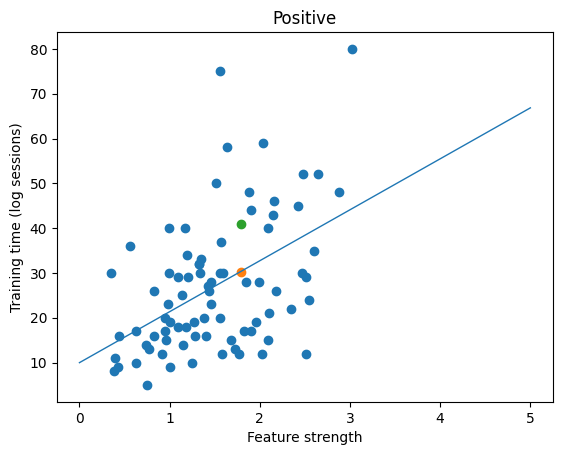

Processing mouse 6


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

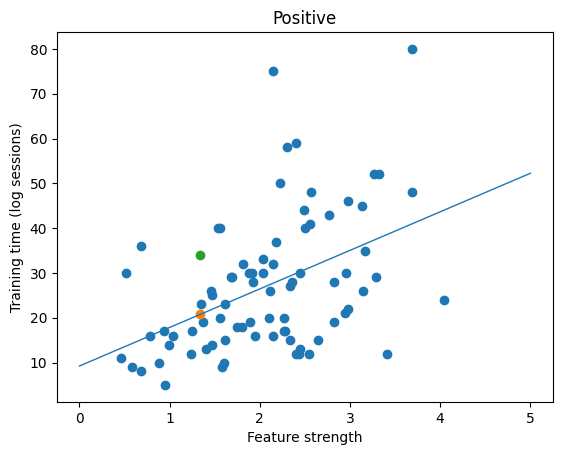

Processing mouse 7


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

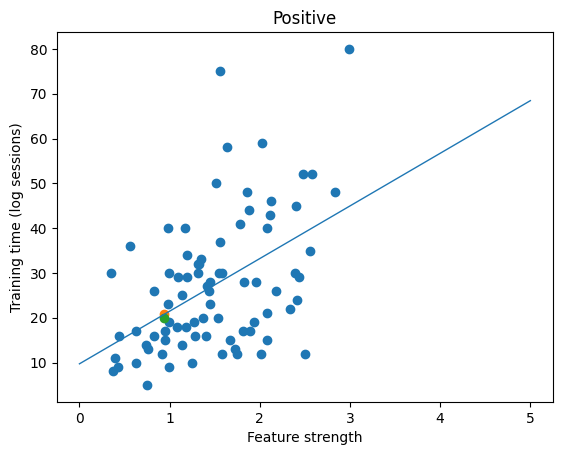

Processing mouse 8


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

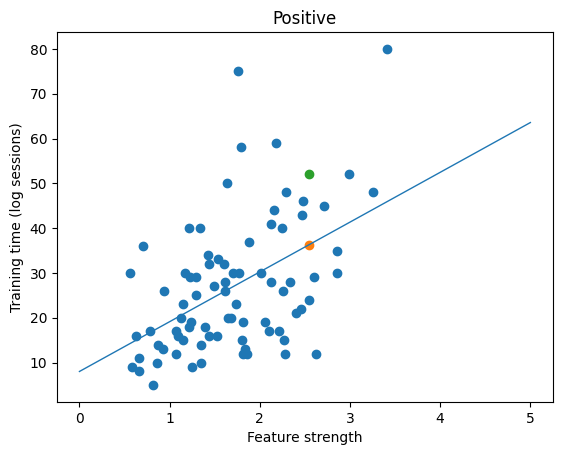

Processing mouse 9


/tmp/ipykernel_8198/1377116057.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['syllable'][s] = s
/tmp/ipykernel_8198/1377116057.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setti

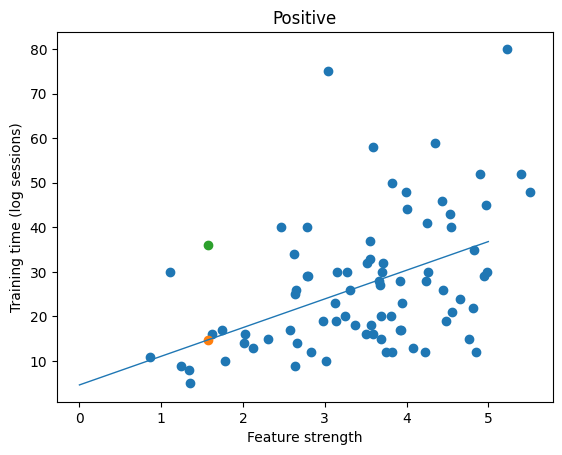

In [ ]:
syllables = np.arange(0, np.shape(final_matrix)[1])

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_pos', 'predicted_neg', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
# y_df['training_time'] = list(np.log(mat['training_time']))
y_df['training_time'] = list(mat['training_time'])
y_df['predicted_pos'] = y_df['training_time'] * np.nan
y_df['predicted_neg'] = y_df['training_time'] * np.nan
y_df['predicted_time'] = y_df['training_time'] * np.nan
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
# use_mat['training_time'] = np.log(mat['training_time'])

for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()[:10]):
    
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['syllable', 'pearson', 'p_value'], index=syllables)

    prob_syllable = training.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()

    for s, syllable in enumerate(syllables):
        
        x = prob_syllable[s]
        y = prob_syllable['training_time']
        
        pearson, p_value = stats.pearsonr(x, y)
        
        # Save data
        pearson_df['syllable'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value
        
        # if p_value <= 0.01:
        #     plt.scatter(x, y)
        #     plt.title(str(syllable - np.floor(syllable/16) * 16))
        #     plt.show()
        
    # # Plot pearson values
    # plt.hist(pearson_df.loc[pearson_df['p_value']>0.05, 'pearson'], alpha=0.4)
    # plt.hist(pearson_df.loc[pearson_df['p_value']<0.05, 'pearson'], alpha=0.8)
    # plt.show()
    
    # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    
    positive_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.05) & (pearson_df['pearson']>0), 'syllable'])
    negative_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.05) & (pearson_df['pearson']<0), 'syllable'])
    
    feature_strength_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'positive_strength', 'negative_strength'], index=range(len(training_mice)))
    for mm, mmouse in enumerate(training_mice):
        
        mouse_vector = training.loc[training['mouse_number']==mmouse, syllables].mean(axis=0)
        positive_strength = mouse_vector[positive_features].sum()
        negative_strength = mouse_vector[negative_features].sum()
        
        # Save
        feature_strength_df['mouse_number'][mm] = mmouse
        feature_strength_df['training_time'][mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
        feature_strength_df['positive_strength'][mm] = positive_strength
        feature_strength_df['negative_strength'][mm] = negative_strength
            
    
    # Training set model
    # pos_x = feature_strength_df['positive_strength']
    # neg_x = feature_strength_df['negative_strength']
    # y = feature_strength_df['training_time']

    pos_x = np.array(feature_strength_df['positive_strength'])
    neg_x = np.array(feature_strength_df['negative_strength'])
    y = np.array(feature_strength_df['training_time'])

    # X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
    # ols_pos = LinearRegression(fit_intercept=False)
    # ols_pos.fit(np.array(X_pos), np.array(y))
    # # slope, intersect = np.linalg.lstsq(X_pos.astype('float'), y.astype('float'))[0]

    # X_neg = np.vstack([neg_x, np.ones(len(neg_x))]).T
    # ols_neg = LinearRegression(fit_intercept=False)
    # ols_neg.fit(np.array(X_neg), np.array(y))
    
    X = np.vstack([pos_x, neg_x, np.ones(len(neg_x))]).T
    ols = LinearRegression(fit_intercept=False)
    ols.fit(np.array(X), np.array(y))
    
    # plt.scatter(pos_x, y)
    # # plt.scatter(neg_x, y)
    # # # plt.scatter(X, y)
    # new_x = np.arange(0, 40, 1)
    # # new_X = np.vstack([new_x, np.ones(len(new_x))]).T
    # slope = ols_pos.coef_[0]
    # intercept = ols_pos.coef_[1]
    # plt.plot(
    #     new_x,
    #     slope* new_x + intercept,
    #     label="Linear Regression Model",
    #     linewidth=1,
    # )
    # plt.xlabel('Feature strength')
    # plt.ylabel('Training time (log sessions)')
    # plt.title('Positive')
    # plt.show()

    # Predict test mouse
    test = use_mat.loc[use_mat['mouse_number']==m]
    test_prob_syllable = test.groupby(['mouse_number', 'training_time'])[syllables].mean().reset_index()
    positive_mouse_strength = np.array(test_prob_syllable[positive_features]).sum()
    negative_mouse_strength = np.array(test_prob_syllable[negative_features]).sum()
    
    # new_pos_X = np.vstack([positive_mouse_strength, np.ones(1)]).T
    # new_neg_X = np.vstack([negative_mouse_strength, np.ones(1)]).T
    # predicted_time_pos = ols_pos.predict(new_pos_X)
    # predicted_time_neg = ols_neg.predict(new_neg_X)
    new_X = np.vstack([positive_mouse_strength, negative_mouse_strength, np.ones(1)]).T
    predicted_time = ols.predict(new_X)

    # Save
    # y_df.loc[y_df['mouse_number']==m, 'predicted_pos'] = np.round(predicted_time_pos[0], 1)
    # y_df.loc[y_df['mouse_number']==m, 'predicted_neg'] = np.round(predicted_time_neg[0], 1)
    y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 1)




    # pos_x = np.array(feature_strength_df['positive_strength'])
    # y = np.array(feature_strength_df['training_time'])

    # X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
    # ols_pos = LinearRegression(fit_intercept=False)
    # ols_pos.fit(np.array(X_pos), np.array(y))

    # plt.scatter(pos_x, y)
    # new_x = np.arange(0, 6, 1)
    # slope = ols_pos.coef_[0]
    # intercept = ols_pos.coef_[1]
    # plt.plot(
    #     new_x,
    #     slope* new_x + intercept,
    #     label="Linear Regression Model",
    #     linewidth=1,
    # )
    # plt.xlabel('Feature strength')
    # plt.ylabel('Training time (log sessions)')
    # plt.title('Positive')
    
    # new_X = np.vstack([positive_mouse_strength, np.ones(1)]).T
    # predicted_time = ols_pos.predict(new_X)
    # true_time = list(y_df.loc[y_df['mouse_number']==m, 'training_time'])[0]
    # plt.scatter(positive_mouse_strength, predicted_time)
    # plt.scatter(positive_mouse_strength, true_time)
    # plt.show()
    # res = stats.pearsonr(pos_x, y)
    # res

In [ ]:
pos_x = np.array(feature_strength_df['positive_strength'])
neg_x = np.array(feature_strength_df['negative_strength'])
y = np.array(feature_strength_df['training_time'])

X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
ols_pos = LinearRegression(fit_intercept=False)
ols_pos.fit(np.array(X_pos), np.array(y))

LinearRegression(fit_intercept=False)

(0.48844813510434537, 4.296314760374318e-06)

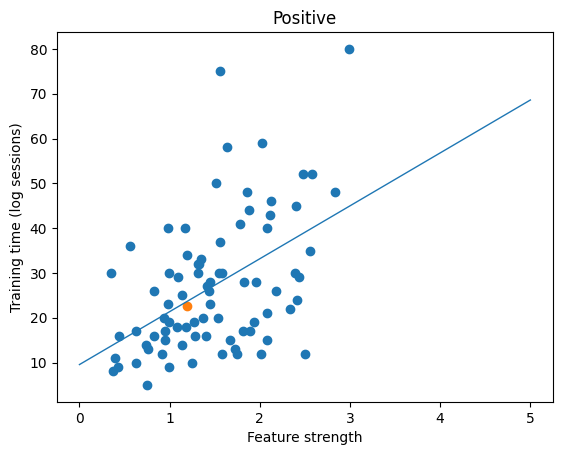

In [ ]:
plt.scatter(feature_strength_df['positive_strength'], feature_strength_df['training_time'])
new_x = np.arange(0, 6, 1)
# new_X = np.vstack([new_x, np.ones(len(new_x))]).T
slope = ols_pos.coef_[0]
intercept = ols_pos.coef_[1]
plt.plot(
    new_x,
    slope* new_x + intercept,
    label="Linear Regression Model",
    linewidth=1,
)
plt.xlabel('Feature strength')
plt.ylabel('Training time (log sessions)')
plt.title('Positive')
plt.scatter(positive_mouse_strength, predicted_time)
plt.scatter(positive_mouse_strength, predicted_time)
# plt.show()
# plt.scatter(feature_strength_df['negative_strength'], feature_strength_df['training_time'])
res = stats.pearsonr(feature_strength_df['positive_strength'], feature_strength_df['training_time'])
res